# TopN model + top2 training :
## Purpose: 
## 1. train and distinguish top 2 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sklearn
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.decomposition import PCA
import time
import sys
import math
import numpy as np
import random
import joblib
from scipy import stats
from tqdm import tqdm_notebook
import matplotlib.pyplot as plt
import matplotlib as mpl
import copy

import Config
from Config import *
import Dataloader as DL
import HD_basis as HDB
import HD_encoder as HDE
import HD_classifier as HDC

mpl.rcParams.update({'font.size': 22})

In [3]:
def evaluate(func, data, labels, threshold, dominance, mask_t, mask_d):
    correct, c_1, c_2, c_r, w_1, w_2, w_3, count, mat, net_mat = func(data, labels, threshold, dominance, mask_t, mask_d)
    print("Accuracy: ", correct/count)
    print("Original: ", c_1/count)
    print("Correct: ",correct)
    print("First is Correct: ", c_1)
    print("Wrong second is selected: ", w_1)
    print("Second is Correct: ", c_2)
    print("Correct Second is selected: ", c_r)
    print("Wrong first is selected: ", w_2)
    print("Out of top 2: ", w_3)
    print("Net increase in correct cases and accuracy: ", c_r-w_1, (c_r-w_1)/count)
    print("Potential increase in correct cases and accuracy: ", c_2, c_2/count)
    print("Total cases:", count)
    print("Confusion Matrix:\n", mat)
    print("Net correct Matrix:\n", net_mat)

In [4]:
def sieve_top2(hdc, encoded, labels, cls):
    fst_scs, snd_scs = hdc.analyze(encoded, labels)
    sieveencoded = []
    sievelabels = []
    for sc in fst_scs:
        #print(sc)
        if sc[3] in cls and sc[4] in cls:
            sieveencoded.append(encoded[int(sc[2])])
            sievelabels.append(labels[int(sc[2])])
    for sc in snd_scs:
        if sc[3] in cls and sc[4] in cls:
            sieveencoded.append(encoded[int(sc[2])])
            sievelabels.append(labels[int(sc[2])])
    return np.asarray(sieveencoded), np.asarray(sievelabels)

In [7]:
# train data. with retrain
def train(hdc, traindata, trainlabels, testdata, testlabels, param = Config.config):
    train_accs = []
    test_accs = []
    for _ in tqdm_notebook(range(param["epochs"]), desc='epochs'):
        train_accs.append(hdc.fit(traindata, trainlabels, param))
        test_accs.append(hdc.test(testdata, testlabels, param["kernel"]))
        if len(train_accs) % 5 == 1:
            print("Train: %f \t \t Test: %f"%(train_accs[-1], test_accs[-1]))
        if train_accs[-1] == 1:
            print("Train: %f \t \t Test: %f"%(train_accs[-1], test_accs[-1]))
            break
    return np.asarray(train_accs), np.asarray(test_accs)

In [8]:
# train data. with retrain
def train_topn(hdc, traindata, trainlabels, testdata, testlabels, n = 2, dominance = 2, param = Config.config):
    train_accs = []
    test_accs = []

    for _ in tqdm_notebook(range(param["epochs"]), desc='epochs'):
        train_accs.append(hdc.fit_topn(traindata, trainlabels, n, dominance, param))
        test_accs.append(hdc.test(testdata, testlabels, param["kernel"]))
        if len(train_accs) % 5 == 1:
            print("Train: %f \t \t Test: %f"%(train_accs[-1], test_accs[-1]))
        if train_accs[-1] == 1:
            print("Train: %f \t \t Test: %f"%(train_accs[-1], test_accs[-1]))
            break
            
    return np.asarray(train_accs), np.asarray(test_accs)

In [9]:
def show_plots(fst_scs, snd_scs, pairs = None):
    
    new_fst = []
    new_snd = []
    
    if pairs is not None:
        for sc in fst_scs:
            if (sc[3], sc[4]) in pairs or (int(sc[4]), int(sc[3])) in pairs:
                new_fst.append(sc)
        for sc in snd_scs:
            if (sc[3], sc[4]) in pairs or (int(sc[4]), int(sc[3])) in pairs:
                new_snd.append(sc)          
        fst_scs = np.asarray(new_fst)
        snd_scs = np.asarray(new_snd)
    
    rg = [min(np.min(fst_scs[:,:2]), np.min(snd_scs[:,:2])), 
          max(np.max(fst_scs[:,:2]), np.max(snd_scs[:,:2]))]
    
    # Scatter plots
    plt.figure(figsize = (10, 10))
    plt.plot(rg, rg, ls = "--")
    plt.scatter(fst_scs[:,0], fst_scs[:,1], label = "fst", color = "g", alpha = 0.7, s = 16)
    plt.legend()
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.plot(rg, rg, ls = "--")
    plt.scatter(snd_scs[:,0], snd_scs[:,1], label = "snd", color = "r", alpha = 0.7, s = 16)
    plt.legend()
    plt.show()

    plt.figure(figsize = (10, 10))
    plt.plot(rg, rg, ls = "--")
    plt.scatter(fst_scs[:,0], fst_scs[:,1], label = "fst", color = "g", alpha = 0.3, s = 16)
    plt.scatter(snd_scs[:,0], snd_scs[:,1], label = "snd", color = "r", alpha = 0.3, s = 16)
    plt.legend()
    plt.show()
    
    # ratio dist
    fst_rt = fst_scs[:,0]/fst_scs[:,1]
    snd_rt = snd_scs[:,0]/snd_scs[:,1]

    # Exclude but record outliers 
    sd = np.std(np.append(fst_rt, snd_rt))
    mn = np.mean(np.append(fst_rt, snd_rt))
    z = 2
    print(sd, mn)
    fst_rt_ol = fst_rt[np.abs(fst_rt - mn) > 2 * z * sd]
    fst_rt_cl = fst_rt[np.abs(fst_rt - mn) <= 2 * z * sd]
    snd_rt_ol = snd_rt[np.abs(snd_rt - mn) > 2 * z * sd]
    snd_rt_cl = snd_rt[np.abs(snd_rt - mn) <= 2 * z * sd]
    
    bins = np.linspace(min(np.min(fst_rt_cl), np.min(snd_rt_cl)), max(np.max(fst_rt_cl), np.max(snd_rt_cl)), 200)
    
    fst_rt_cl = fst_rt_cl[fst_rt_cl <= max(snd_rt_cl)]
    
    # Ratio dist, deprecated because it doesn't make sense
    plt.figure(figsize = (50, 20))
    plt.hist(fst_rt_cl, bins = bins, label = "fst", color = "r", alpha = 0.5)
    plt.hist(snd_rt_cl, bins = bins, label = "snd", color = "g", alpha = 0.5)
    plt.legend(prop={"size":80})
    
    # diff dist
    
    fst_sc = fst_scs[:,0]-fst_scs[:,1]
    snd_sc = snd_scs[:,0]-snd_scs[:,1]
    bins = np.linspace(min(np.min(fst_sc), np.min(snd_sc)), max(np.max(fst_sc), np.max(snd_sc)), 200)
    
    plt.figure(figsize = (50, 20))
    plt.hist(fst_sc, bins = bins, label = "fst", color = "r", alpha = 0.5)
    plt.hist(snd_sc, bins = bins, label = "snd", color = "g", alpha = 0.5)
    plt.legend(prop={"size":80})

In [10]:
dl = DL.Dataloader()
nFeatures, nClasses, traindata, trainlabels, testdata, testlabels = dl.getParam()


Loading dataset UCIHAR from UCIHAR
Loading train data... train data of shape (6213, 561) loaded
Loading test data...  test  data of shape (1554, 561) loaded
Data Loaded. Num of features = 561 Num of Classes = 12

In [11]:
#Data shuffling 
shuf_train = np.random.permutation(len(traindata))
traindata = traindata[shuf_train]
trainlabels = trainlabels[shuf_train]

shuf_test = np.random.permutation(len(testdata))
testdata = testdata[shuf_test]
testlabels = testlabels[shuf_test]

In [12]:
traindata = traindata[:10000]
testdata = testdata[:5000]

In [13]:
param = Config.config
param["nFeatures"] = nFeatures
param["nClasses"] = nClasses
print(param)

{'data_location': '../dataset/', 'directory': 'UCIHAR', 'dataset': 'UCIHAR', 'D': 2000, 'vector': 'Gaussian', 'mu': 0, 'sigma': 1, 'binarize': 0, 'lr': 1, 'sparse': 0, 's': 0.1, 'binaryModel': 0, 'checkpoints': False, 'kernel': <Kernel_T.COS: 1>, 'width': None, 'height': None, 'nLayers': 5, 'uniform_dim': 1, 'uniform_ker': 1, 'dArr': None, 'k': 3, 'kArr': None, 'one_shot': 0, 'data_percentages': [1.0, 0.01, 0.02, 0.05, 0.1, 0.2, 0.5], 'train_percent': 1, 'dropout': 0, 'drop_percentages': [0, 0.1, 0.2, 0.5], 'dropout_rate': 0, 'update_type': <Update_T.FULL: 1>, 'iter_per_trial': 3, 'iter_per_encoding': 5, 'epochs': 100, 'nFeatures': 561, 'nClasses': 12}


# Train topn 

In [14]:
################# VANILLA #################
hdb = HDB.HD_basis(Config.Generator_T.Vanilla, param)
basis = hdb.getBasis()
bid = hdb.getParam()["id"]
# Update param with bid
param = hdb.getParam()
print(bid)
hde = HDE.HD_encoder(basis)

trainencoded = hde.encodeData(traindata)
#HDE.saveEncoded(trainencoded, trainlabels, bid, "train")

testencoded = hde.encodeData(testdata)
#HDE.saveEncoded(testencoded, testlabels, bid, "test")

Generating vanilla HD basis of shape... 


524


(2000, 561)
Encoding time: 0.07528495788574219 
Encoding data of shape (6213, 561)


Time spent: 2 sec
Encoding data of shape (1554, 561)


Time spent: 0 sec


In [15]:
hdc_1 = HDC.HD_classifier(param["D"], param["nClasses"], bid)
train_acc_1, test_acc_1 = train(hdc_1, trainencoded, trainlabels, testencoded, testlabels, param)

c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.738452 	 	 Test: 0.883526
Train: 0.910510 	 	 Test: 0.915058
Train: 0.934009 	 	 Test: 0.925354
Train: 0.948173 	 	 Test: 0.958816
Train: 0.953967 	 	 Test: 0.948520
Train: 0.960567 	 	 Test: 0.940798
Train: 0.959279 	 	 Test: 0.945946
Train: 0.961693 	 	 Test: 0.967825
Train: 0.968775 	 	 Test: 0.953024
Train: 0.964751 	 	 Test: 0.933719
Train: 0.971028 	 	 Test: 0.953668
Train: 0.976018 	 	 Test: 0.968468
Train: 0.971994 	 	 Test: 0.951094
Train: 0.975213 	 	 Test: 0.924067
Train: 0.977306 	 	 Test: 0.950450
Train: 0.982295 	 	 Test: 0.969755
Train: 0.976179 	 	 Test: 0.962677
Train: 0.984227 	 	 Test: 0.969755
Train: 0.972960 	 	 Test: 0.966538
Train: 0.984870 	 	 Test: 0.968468



In [16]:
hdc_2 = HDC.HD_classifier(param["D"], param["nClasses"], bid)
train_acc_2, test_acc_2 = train_topn(hdc_2, trainencoded, trainlabels, testencoded, testlabels, 2, 1, param)

c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.770320 	 	 Test: 0.851351
Train: 0.922421 	 	 Test: 0.905405
Train: 0.937711 	 	 Test: 0.923423
Train: 0.949622 	 	 Test: 0.901544
Train: 0.963786 	 	 Test: 0.912484
Train: 0.965395 	 	 Test: 0.958172
Train: 0.968775 	 	 Test: 0.971042
Train: 0.970868 	 	 Test: 0.907336
Train: 0.975213 	 	 Test: 0.974903
Train: 0.970385 	 	 Test: 0.972329
Train: 0.973926 	 	 Test: 0.964607
Train: 0.975374 	 	 Test: 0.969755
Train: 0.977306 	 	 Test: 0.966538
Train: 0.974891 	 	 Test: 0.956885
Train: 0.976179 	 	 Test: 0.972329
Train: 0.978271 	 	 Test: 0.968468
Train: 0.980364 	 	 Test: 0.941441
Train: 0.980525 	 	 Test: 0.921493
Train: 0.980042 	 	 Test: 0.973616
Train: 0.981008 	 	 Test: 0.972973



In [17]:
print(np.max(test_acc_1))
print(np.max(test_acc_2))

0.972972972972973
0.9761904761904762


In [18]:
print(hdc_1.test(testencoded, testlabels, param["kernel"]))
print(hdc_2.test(testencoded, testlabels, param["kernel"]))

#print(hdc_1.test_topn(testencoded, testlabels, 2, param["kernel"]))

0.9697554697554698
0.9716859716859717


In [23]:
subencoded, sublabels = sieve_top2(hdc_2, trainencoded, trainlabels, [3, 4])
print(len(sublabels))
train_acc_2, test_acc_2 = train(hdc_2, subencoded, sublabels, testencoded, testlabels, param)

1917


c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Train: 0.952530 	 	 Test: 0.925997
Train: 0.969223 	 	 Test: 0.921493
Train: 0.956182 	 	 Test: 0.969112
Train: 0.951487 	 	 Test: 0.935650
Train: 0.965571 	 	 Test: 0.967825
Train: 0.965571 	 	 Test: 0.969112
Train: 0.952008 	 	 Test: 0.968468
Train: 0.962441 	 	 Test: 0.969112
Train: 0.954095 	 	 Test: 0.967825
Train: 0.953052 	 	 Test: 0.965894
Train: 0.966615 	 	 Test: 0.968468
Train: 0.967136 	 	 Test: 0.969112
Train: 0.965571 	 	 Test: 0.968468
Train: 0.967658 	 	 Test: 0.965894
Train: 0.961398 	 	 Test: 0.967181
Train: 0.956703 	 	 Test: 0.947233
Train: 0.945227 	 	 Test: 0.963964
Train: 0.971309 	 	 Test: 0.967825
Train: 0.974961 	 	 Test: 0.965251
Train: 0.948357 	 	 Test: 0.967181



In [43]:
subencoded, sublabels = sieve_top2(hdc_1, trainencoded, trainlabels, [3, 4])
print(len(sublabels))
train_acc_1, test_acc_1 = train(hdc_1, subencoded, sublabels, testencoded, testlabels, param)

1950


c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Train: 0.949231 	 	 Test: 0.963320
Train: 0.947692 	 	 Test: 0.971686
Train: 0.971282 	 	 Test: 0.974260
Train: 0.975385 	 	 Test: 0.972329
Train: 0.979487 	 	 Test: 0.971686
Train: 0.980513 	 	 Test: 0.971686
Train: 0.975385 	 	 Test: 0.970399
Train: 0.977436 	 	 Test: 0.969755
Train: 0.981538 	 	 Test: 0.971042
Train: 0.983077 	 	 Test: 0.945302
Train: 0.982564 	 	 Test: 0.969755
Train: 0.985641 	 	 Test: 0.970399
Train: 0.983590 	 	 Test: 0.969755
Train: 0.986667 	 	 Test: 0.969755
Train: 0.981538 	 	 Test: 0.969755
Train: 0.980513 	 	 Test: 0.969755
Train: 0.986154 	 	 Test: 0.927284
Train: 0.988718 	 	 Test: 0.969112
Train: 0.984103 	 	 Test: 0.927284
Train: 0.985128 	 	 Test: 0.944659



In [44]:
avg_3 = np.zeros(hdc_1.D)
cnt_3 = 0
avg_4 = np.zeros(hdc_1.D)
cnt_4 = 0

for i in range(len(subencoded)):
    print(subencoded[i], sublabels[i])
    if sublabels[i] == 3:
        avg_3 += subencoded[i]
        cnt_3 += 1
    elif sublabels[i] == 4:
        avg_4 += subencoded[i]
        cnt_4 += 1
        
avg_3 /= cnt_3
avg_4 /= cnt_4

[ 0.93177192  0.38377797  0.98050905  0.88326409  0.45927057  0.61576939
  0.44789384  0.89392447  0.59946856  0.97058141  0.6800268   0.9998352
  0.7022055   0.94728549  0.9849296   0.8912404   0.85943334  0.86088263
  0.91245959 -0.44262243  0.97068854 -0.17301848  0.28068561  0.05659556
  0.98750882  0.96757716  0.82429257  0.982877    0.99688741  0.95858667
  0.93283161  0.38120798  0.28990702  0.88374648  0.2394233   0.90316848
  0.12316102  0.99997684  0.99729675  0.8961987   0.88921528  0.45714459
  0.98490402  0.9951147   0.25303095  0.97485305  0.77782744  0.99993266
  0.8475237   0.52398072 -0.64737396  0.98526951  0.9690647  -0.63663204
  0.99563607  0.70778389  0.580507    0.45379527  0.4735068   0.90556567
  0.17699962  0.93487355  0.77017005  0.96014406 -0.32678212  0.66444908
  0.67964298  0.70422144  0.83586551  0.4835334   0.10079277  0.96338499
  0.81830696  0.80619578  0.1293874   0.60391227  0.97719397  0.83588182
  0.98941594  0.99451191  0.98761991  0.89369234  0.

[ 9.41717800e-01  6.07675778e-01  9.99319896e-01  8.93312463e-01
  4.64386458e-01  6.05072219e-01  6.34425781e-01  7.79639133e-01
  7.21257218e-01  9.93838793e-01  7.88347968e-01  9.08306564e-01
  7.35118917e-01  8.97728691e-01  9.91831151e-01  7.29046692e-01
  9.58078260e-01  5.37308921e-01  9.88457036e-01 -4.20033987e-01
  9.80036136e-01  4.45792871e-02  2.36821597e-01  3.25752620e-01
  9.28987422e-01  9.96138181e-01  6.90382654e-01  8.72635829e-01
  8.76647807e-01  9.90349210e-01  9.89170423e-01  1.17569689e-01
  5.52578008e-01  9.72305037e-01  7.50856299e-02  4.96672419e-01
  3.86673284e-01  7.19255441e-01  9.77237300e-01  7.90692175e-01
  9.05335236e-01  2.98607183e-01  9.83658384e-01  9.48099720e-01
  6.23273056e-01  9.91458121e-01  8.37113344e-01  9.24518714e-01
  8.58528987e-01  4.75279997e-01 -4.17859771e-01  9.89273501e-01
  8.90452219e-01 -6.45746035e-01  9.68219061e-01  3.62830139e-01
  8.06295514e-01  3.09614449e-01  6.51357179e-01  8.69432572e-01
  7.19138621e-01  9.82710

[ 9.26093530e-01  5.32386818e-01  8.74004448e-01  5.26197646e-01
  1.90532405e-01  5.79832370e-01  6.72859588e-01  5.57089334e-01
  7.98576079e-01  9.62029004e-01  8.11420062e-01  8.90038783e-01
  6.25383484e-01  8.92454946e-01  9.99768288e-01  6.62991485e-01
  5.92948956e-01  4.02999387e-01  9.21874041e-01 -5.68488795e-01
  9.73939858e-01 -4.08067567e-01  3.31320931e-01 -1.83252581e-01
  9.84138078e-01  9.97880546e-01  6.43484142e-01  9.96532854e-01
  8.55049993e-01  9.95224318e-01  9.73775788e-01  4.39399868e-01
  3.28790190e-01  8.81353667e-01 -4.29620786e-03  7.35438630e-01
  2.99956563e-01  7.01391491e-01  9.95466319e-01  8.61988433e-01
  9.34684877e-01  6.29621923e-02  9.95791178e-01  8.09226742e-01
  5.69557044e-01  9.94008981e-01  9.37409990e-01  9.53378906e-01
  9.30310438e-01  5.41958719e-01 -8.10485836e-01  9.65936394e-01
  9.33693430e-01 -8.43810087e-01  9.76409768e-01  6.58797700e-01
  9.59070593e-01  4.32145134e-01  4.69678997e-01  5.57397324e-01
  5.64205205e-01  9.70437

  0.94823134  0.36120643] 3
[ 9.18043325e-01  5.13353552e-01  9.77487922e-01  8.10764233e-01
  2.80673821e-01  6.33425416e-01  5.00554502e-01  7.07971621e-01
  5.86947423e-01  9.92876635e-01  8.27988632e-01  9.03270819e-01
  6.27793600e-01  9.44404320e-01  9.69123532e-01  9.43923236e-01
  7.71745648e-01  6.07844939e-01  9.77775349e-01 -4.83958043e-01
  8.02086612e-01  1.12483903e-01  3.36892644e-01 -1.84284363e-01
  9.50609870e-01  9.31887974e-01  6.13840073e-01  9.97639516e-01
  9.43504005e-01  9.99994952e-01  9.99989617e-01  5.47274466e-01
  4.67494233e-01  9.88100932e-01  2.97000453e-01  7.83033904e-01
  3.14665551e-01  9.78925304e-01  9.70326090e-01  6.53673401e-01
  9.32370029e-01  2.97700491e-01  9.61055516e-01  8.02272028e-01
  3.86565213e-01  9.21705669e-01  8.13196929e-01  9.86099954e-01
  9.64531888e-01  6.76944131e-01 -5.77683442e-01  9.22157860e-01
  9.88078760e-01 -6.40195440e-01  9.59173860e-01  3.70591717e-01
  7.84013628e-01  3.46967239e-01  6.38767287e-01  6.45779630e-

[ 9.44060886e-01  7.50069562e-01  9.97040680e-01  5.73124907e-01
  3.58389633e-01  8.75435651e-01  5.07605250e-01  5.75108419e-01
  7.32611260e-01  9.34726736e-01  6.67241830e-01  9.61155087e-01
  5.84038322e-01  9.10395395e-01  9.99046524e-01  7.38448533e-01
  6.81402978e-01  4.52235988e-01  9.57541841e-01 -7.52392514e-01
  9.99215855e-01 -2.30735425e-01  3.79142123e-01  1.69284343e-02
  9.23960408e-01  9.99285858e-01  7.31552045e-01  9.99955607e-01
  7.43925571e-01  9.82212901e-01  9.79176421e-01  4.95171671e-01
  4.10230820e-01  7.45943763e-01  2.95123401e-01  6.19717884e-01
  5.14814415e-01  9.99986238e-01  9.98070568e-01  7.36599808e-01
  8.76595005e-01  1.26692488e-01  9.91210903e-01  9.89076835e-01
  6.14691991e-01  9.98003632e-01  8.56539539e-01  9.99980602e-01
  8.64515244e-01  5.52183604e-01 -7.45170493e-01  9.73844939e-01
  9.81121376e-01 -9.04949442e-01  9.45185772e-01  6.92725719e-01
  7.15504550e-01  4.54026725e-01  5.35500037e-01  8.22708979e-01
  4.88087888e-01  9.99104

[ 0.91305971  0.40545875  0.98803713  0.79463707  0.48410643  0.76914321
  0.66797544  0.68619494  0.53038909  0.999484    0.79726214  0.86325381
  0.59390533  0.99096192  0.98654946  0.78078765  0.79676014  0.34730331
  0.99984654 -0.57106912  0.85611128 -0.06938236  0.14982406 -0.09955056
  0.92049034  0.98446044  0.71292243  0.99803556  0.98921102  0.99999982
  0.99991954  0.64594922  0.57483299  0.96654446  0.15860123  0.77761289
  0.20187926  0.97645875  0.98256946  0.54487382  0.789343    0.23541521
  0.91576787  0.77494852  0.56403032  0.99397341  0.76913421  0.98254155
  0.9360884   0.52784737 -0.71003018  0.85734497  0.98314664 -0.72544365
  0.95873158  0.46562959  0.80477243  0.30901926  0.65991671  0.7535143
  0.31906437  0.95765878  0.52258551  0.936282   -0.43288474  0.74769437
  0.78196586  0.7218956   0.79150069  0.20722203  0.23787669  0.9574159
  0.8975207   0.89623624 -0.11518741  0.6716983   0.91698937  0.8624945
  0.95539242  0.99143144  0.80995375  0.92487066  0.78

[ 0.91085391  0.80295939  0.99787916  0.86174406  0.13287322  0.68094953
  0.30532273  0.77082718  0.62275143  0.98064171  0.82352666  0.78460164
  0.58801059  0.99881273  0.97619386  0.67869315  0.84935014  0.7040841
  0.98246507 -0.40253843  0.9994235   0.29356933  0.53396749  0.359284
  0.90401986  0.94801794  0.58453795  0.91074675  0.84847465  0.99985194
  0.98360988  0.51090448  0.42417684  0.95601329  0.30884055  0.70570901
  0.64096099  0.99508053  0.96421244  0.63169276  0.81267207  0.11566377
  0.99140845  0.9663951   0.50128505  0.94490822  0.72823806  0.99954981
  0.91515661  0.53306479 -0.46890925  0.98989041  0.92984675 -0.49792844
  0.96069944  0.32194045  0.7726742   0.4806019   0.58695583  0.86916223
  0.51633406  0.98177957  0.48330183  0.85522603 -0.32532357  0.72303847
  0.76523196  0.63284428  0.78812693  0.54011628  0.10165095  0.94398534
  0.9295223   0.77374338 -0.07320088  0.72405279  0.98862842  0.99233975
  0.93998486  0.98116959  0.76876835  0.95604872  0.60

[ 7.48988187e-01  5.70308677e-01  9.91941609e-01  7.40979249e-01
  8.06206456e-02  8.46454754e-01  6.08995458e-01  7.42129493e-01
  5.97707708e-01  9.76383610e-01  8.10977971e-01  7.95321501e-01
  2.92304013e-01  9.71868740e-01  9.99409344e-01  5.12980930e-01
  8.85185654e-01  6.20092195e-01  9.96547841e-01 -7.63545362e-01
  9.77414389e-01  4.64547181e-03  2.50106477e-01  1.43067639e-01
  8.08143660e-01  9.03614695e-01  8.69843375e-01  9.39347860e-01
  7.80111236e-01  9.39872750e-01  9.87574186e-01  3.55607070e-01
  5.17323201e-01  9.48289207e-01  4.59637761e-02  8.24685712e-01
  5.52437349e-01  9.89515855e-01  9.99702118e-01  5.37320204e-01
  7.01640239e-01  5.00985703e-01  8.66070849e-01  9.99673037e-01
  8.63585670e-01  9.59774668e-01  7.81050395e-01  9.98792519e-01
  9.61714916e-01  5.15748613e-01 -5.73773896e-01  9.99822484e-01
  9.67977257e-01 -8.00810997e-01  9.40081452e-01  8.00417577e-01
  8.09893245e-01  3.26055558e-01  2.66864234e-01  9.28311410e-01
  5.43032583e-01  9.59521

[ 7.09698464e-01  8.90372743e-01  9.93447620e-01  7.34232919e-01
  3.58743659e-01  6.53653547e-01  8.82721526e-01  7.85659826e-01
  5.99044499e-01  9.87580374e-01  9.76968452e-01  6.74761671e-01
  5.26635293e-01  9.16249802e-01  9.55758206e-01  5.95747767e-01
  9.62152397e-01  5.71803956e-01  9.15556549e-01 -8.94233872e-01
  9.53372837e-01 -9.23173123e-02  7.92739980e-01  5.00503897e-02
  9.28986520e-01  7.54637196e-01  6.57795623e-01  9.47013964e-01
  5.98102355e-01  9.99168917e-01  9.31707924e-01  7.31146200e-01
  6.86478062e-01  9.83491447e-01  5.31774189e-01  4.05498877e-01
  7.46206022e-01  9.05777689e-01  8.40726636e-01  3.52460488e-01
  8.12915544e-01  3.67476179e-01  9.43813588e-01  9.80298183e-01
  9.47510860e-01  9.81474169e-01  8.02232335e-01  9.50122734e-01
  9.97124261e-01  4.38064739e-01 -6.96871094e-01  8.44853327e-01
  9.72162566e-01 -6.69072877e-01  9.65596801e-01  5.97882651e-01
  9.57530906e-01  4.60770537e-01  5.72858483e-01  9.59095266e-01
  7.69500328e-01  9.12808

[ 9.56756672e-01  3.75587192e-01  9.97703909e-01  7.83837182e-01
  2.09829523e-01  7.48894705e-01  5.50133751e-01  7.83379499e-01
  7.26032182e-01  9.98401911e-01  8.06486242e-01  8.90296419e-01
  7.25238703e-01  9.52885920e-01  9.97932419e-01  8.11930757e-01
  7.87126309e-01  3.59572096e-01  9.86938966e-01 -4.03662679e-01
  9.69603923e-01 -2.13472940e-01  4.05505508e-01 -9.38222785e-02
  8.89939129e-01  9.34657134e-01  6.42365936e-01  9.76836730e-01
  9.71375528e-01  9.85233951e-01  9.99870319e-01  5.58812269e-01
  5.29160091e-01  9.30698422e-01  3.21892803e-01  7.11780901e-01
  1.90003739e-01  9.80997374e-01  9.79486724e-01  6.60753324e-01
  8.01358480e-01  2.25141414e-01  9.26095034e-01  8.43775062e-01
  3.86109365e-01  9.88480976e-01  6.17373236e-01  9.73466067e-01
  9.72008330e-01  6.53846222e-01 -6.44918909e-01  9.14736303e-01
  9.49946908e-01 -5.56422428e-01  8.80523975e-01  6.13002195e-01
  8.93247935e-01  3.85260242e-01  3.79230073e-01  8.06501792e-01
  3.32254833e-01  9.26132

[ 8.12031448e-01  5.63313901e-01  9.98279414e-01  6.91473230e-01
  3.16626436e-01  5.82615044e-01  7.02888278e-01  7.79906702e-01
  6.64838628e-01  9.75871279e-01  9.05878613e-01  9.90119381e-01
  6.28738474e-01  8.69777122e-01  9.99996793e-01  9.02336860e-01
  9.28592798e-01  6.92769563e-01  9.77241760e-01 -6.10767308e-01
  8.21321798e-01 -1.89465538e-01  4.09846611e-02  1.46123220e-01
  9.76592626e-01  9.80905590e-01  5.56285607e-01  9.37616707e-01
  9.48589021e-01  9.35247817e-01  9.98820410e-01  3.73339212e-01
  5.90970112e-01  9.96640539e-01  3.05661857e-01  8.31494331e-01
  2.69737784e-01  9.32507130e-01  9.99806894e-01  6.05497110e-01
  8.47024392e-01  5.29713270e-01  8.74352784e-01  8.93246151e-01
  2.92845466e-01  9.97529946e-01  9.02758025e-01  9.89847770e-01
  9.97290627e-01  7.45209668e-01 -6.22915057e-01  9.14360550e-01
  9.02505921e-01 -8.14288632e-01  9.28741185e-01  6.16787754e-01
  9.21475734e-01  5.82914916e-01  5.36344666e-01  7.74494688e-01
  2.93073926e-01  8.01210

[ 9.61354960e-01  3.65116734e-01  9.99903139e-01  7.11073595e-01
  1.46748008e-01  6.42631611e-01  4.57569657e-01  7.28005796e-01
  6.66931673e-01  9.97632184e-01  7.60048870e-01  7.96994473e-01
  6.81215841e-01  9.32729301e-01  9.96282626e-01  9.37190903e-01
  7.71563664e-01  7.70482671e-01  9.79029067e-01 -5.10483598e-01
  9.37992108e-01 -1.34235143e-01  2.47564448e-01  6.55925381e-02
  9.68251783e-01  9.25647150e-01  6.74789941e-01  9.95589194e-01
  9.61332816e-01  9.95005760e-01  9.79335435e-01  5.17693259e-01
  2.92553838e-01  9.86921131e-01  9.38100615e-02  8.74758262e-01
  1.49968648e-01  9.61810310e-01  9.98684646e-01  7.05441013e-01
  9.08453993e-01  1.83879480e-01  9.68542412e-01  8.55083799e-01
  3.94175407e-01  9.69784685e-01  6.65251360e-01  9.72782818e-01
  9.57773391e-01  6.00601268e-01 -6.32469139e-01  9.09464698e-01
  9.42767114e-01 -6.14711499e-01  9.26400419e-01  5.29516789e-01
  7.36589967e-01  4.44660579e-01  5.60933800e-01  7.57570023e-01
  4.40985344e-01  9.82850

[ 0.78409874  0.64565316  0.99997187  0.70202038  0.23693448  0.6454078
  0.58647687  0.68099264  0.79535346  0.99587739  0.5910312   0.69374952
  0.56207096  0.82858413  0.99877155  0.71328519  0.76451867  0.54642774
  0.90848917 -0.5657764   0.97333094 -0.14298588  0.52164978 -0.14097519
  0.96849348  0.99193557  0.74313953  0.96418813  0.93278233  0.99999617
  0.9400412   0.5096884   0.36458796  0.94148268  0.24080861  0.73827463
  0.40221553  0.98305183  0.97103632  0.52980783  0.88545294  0.1846301
  0.9997397   0.86127166  0.55865215  0.98759989  0.74324658  0.99826738
  0.94559816  0.49942733 -0.82320724  0.90803112  0.98110123 -0.80102113
  0.94561628  0.63113376  0.93382331  0.22975605  0.59171524  0.73649975
  0.64548068  0.967038    0.6143963   0.82887913  0.09179194  0.78254388
  0.88748597  0.86652492  0.83444644  0.17089759  0.0813141   0.99911619
  0.96147532  0.92276576 -0.15787745  0.59668142  0.99688005  0.99567591
  0.90331273  0.9851915   0.72672292  0.90098845  0.5

[ 8.56969065e-01  4.97476800e-01  9.92240955e-01  6.79579199e-01
  2.75625402e-01  7.59695264e-01  6.92588946e-01  7.16818511e-01
  8.04619468e-01  9.99999244e-01  7.78542867e-01  8.05932877e-01
  7.13635877e-01  9.61454027e-01  9.97744588e-01  6.48430701e-01
  8.83537982e-01  6.39087067e-01  9.76783688e-01 -7.36830393e-01
  8.87983544e-01 -1.53230115e-01  2.73356107e-01  1.70476368e-01
  9.60280366e-01  9.99445597e-01  5.51337486e-01  9.89656057e-01
  9.46836316e-01  9.99775794e-01  9.46263564e-01  4.81754068e-01
  6.02140774e-01  9.46795925e-01  2.20994736e-01  7.77341809e-01
  5.56936339e-01  9.78145963e-01  9.99029062e-01  6.45654575e-01
  8.42812573e-01  2.59393512e-01  9.20162506e-01  9.17584716e-01
  5.50451295e-01  9.96184388e-01  7.60824623e-01  9.53737272e-01
  9.18624016e-01  5.90166584e-01 -7.04738973e-01  8.32515654e-01
  9.04248148e-01 -8.44840772e-01  9.10302154e-01  4.69671906e-01
  8.14375897e-01  4.32147260e-01  4.80893952e-01  8.64052955e-01
  4.05537521e-01  9.32446

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 7.04321815e-01  4.77442658e-01  9.96089172e-01  2.98626868e-01
  6.47411837e-01  7.26902439e-01  7.85126128e-01  7.44249196e-01
  5.73284169e-01  9.99860802e-01  8.60131175e-01  8.67946442e-01
  6.44282506e-01  9.16483204e-01  9.96328185e-01  4.03355022e-01
  9.94734759e-01  9.19398951e-01  7.60153739e-01 -8.49664772e-01
  7.72149998e-01 -1.96909940e-01  4.86557301e-01 -1.64903075e-02
  9.46373017e-01  8.96342848e-01  8.50338685e-01  9.99909171e-01
  8.98197385e-01  9.51328810e-01  6.20677151e-01  6.76804008e-01
  5.43623380e-01  9.38376167e-01  3.98833072e-02  6.44480296e-01
  6.30806620e-01  8.90899503e-01  9.99043516e-01  6.44581663e-01
  8.73013543e-01  5.25829689e-01  9.76053933e-01  9.99992209e-01
  8.48086189e-01  9.42844538e-01  8.81746570e-01  8.99037866e-01
  8.16799642e-01  4.89027135e-01 -8.89691879e-01  8.27847176e-01
  8.81292046e-01 -8.42054507e-01  9.99278009e-01  7.83914023e-01
  8.29436243e-01  3.77415757e-01  1.67146966e-01  9.73082384e-01
  6.44592786e-01  4.83049

[ 0.84884694  0.53625548  0.9979542   0.83571276  0.52510191  0.77776174
  0.67860253  0.68102681  0.54653274  0.99936903  0.95131442  0.83493668
  0.65829264  0.93016964  0.99818376  0.78359798  0.87004293  0.7510086
  0.98135723 -0.47056743  0.86630981 -0.20501791  0.03364679  0.03801816
  0.90090438  0.99847066  0.76601794  0.99989407  0.93685529  0.96317696
  0.99804797  0.26771879  0.68374443  0.98626381  0.21137832  0.7730879
  0.35436229  0.99046806  0.98247653  0.71077639  0.76536781  0.59808122
  0.85504569  0.88319645  0.65963178  0.99996672  0.85298901  0.99331849
  0.94186369  0.54587377 -0.7470647   0.8427844   0.95607471 -0.85911341
  0.96957876  0.64624478  0.86740549  0.43172873  0.53797099  0.89121019
  0.12931093  0.79288081  0.69491592  0.7582833  -0.43534597  0.80287634
  0.8684433   0.75271613  0.7604389   0.34468769  0.3441706   0.95888665
  0.93198448  0.91800902 -0.14956845  0.5579074   0.87510998  0.97424409
  0.9255932   0.95757998  0.8891565   0.89836625  0.7

[ 7.66893493e-01  6.78682790e-01  9.92873592e-01  7.25429074e-01
  4.39963686e-02  8.19991146e-01  6.06856899e-01  7.23096905e-01
  7.27004374e-01  9.93030001e-01  7.95290831e-01  8.93659494e-01
  7.16645841e-01  9.87191645e-01  9.59774647e-01  7.79568586e-01
  8.50315150e-01  5.35921264e-01  9.77432978e-01 -4.92444412e-01
  7.93590963e-01  1.27095382e-01  2.17166337e-01  1.43053749e-02
  9.83745815e-01  9.48057124e-01  4.35527330e-01  9.99490860e-01
  9.33415569e-01  9.98508967e-01  9.99045550e-01  4.32234672e-01
  3.86748137e-01  9.92074555e-01  4.36894341e-01  7.33984035e-01
  4.59128923e-01  9.97803855e-01  9.75620342e-01  5.38104423e-01
  8.89863360e-01  4.04253270e-01  9.05857883e-01  8.16876028e-01
  4.36907181e-01  8.67207937e-01  8.60779042e-01  9.48874285e-01
  9.84921779e-01  6.30900437e-01 -5.89020282e-01  9.41451820e-01
  9.25011982e-01 -7.00376431e-01  9.78112520e-01  3.34393683e-01
  8.72736970e-01  4.39399564e-01  7.97032093e-01  7.98375517e-01
  2.51293823e-01  9.80551

[ 0.93424024  0.37396675  0.94306431  0.71817593  0.08903115  0.62080467
  0.58847633  0.7660441   0.65690291  0.98548108  0.83153362  0.89255664
  0.52795878  0.90701514  0.98282329  0.63547727  0.84534744  0.67370897
  0.9041296  -0.70855115  0.95315828 -0.09560639  0.54416999 -0.00632969
  0.94299742  0.99929801  0.73903249  0.89464021  0.87670506  0.9725284
  0.93316364  0.27735932  0.36166622  0.91118899  0.20690267  0.82827063
  0.37781825  0.97602464  0.99747204  0.79644943  0.77962383  0.37509326
  0.96237762  0.93100305  0.37223805  0.99257036  0.77542332  0.99943127
  0.91441267  0.53240412 -0.71848549  0.93694818  0.96628257 -0.8273919
  0.91475876  0.58803003  0.77115824  0.39801341  0.40039192  0.90687371
  0.36594908  0.91256418  0.73828682  0.73755063 -0.30894655  0.8338949
  0.80158002  0.61590717  0.75620649  0.3225896   0.21410161  0.9993276
  0.95139405  0.88464502 -0.06874486  0.61400508  0.99430019  0.96072127
  0.954512    0.98481276  0.60797285  0.91908448  0.843

[ 7.06062991e-01  6.65896883e-01  9.81687028e-01  7.24834877e-01
  4.19595693e-01  8.70852555e-01  6.18025956e-01  9.88727035e-01
  6.98795405e-01  9.57267931e-01  8.66665760e-01  8.39201606e-01
  7.05178502e-01  9.03708906e-01  9.85556090e-01  6.76628455e-01
  9.29605178e-01  7.86331892e-01  9.31049374e-01 -7.15407539e-01
  8.54378276e-01  6.71655822e-02  3.23182878e-01  4.92888414e-02
  9.46446879e-01  9.28351725e-01  6.37067391e-01  9.66120709e-01
  9.49346404e-01  9.99379008e-01  8.45920130e-01  4.62205548e-01
  6.85711063e-01  9.35813085e-01 -7.62224475e-02  6.76375718e-01
  4.75481894e-01  9.91105073e-01  9.75929806e-01  6.75619798e-01
  8.17820610e-01  3.91219338e-01  9.50044853e-01  9.28048857e-01
  7.78221818e-01  9.99195117e-01  8.08603793e-01  9.89263571e-01
  9.20154572e-01  4.05682887e-01 -6.89698316e-01  9.24523795e-01
  9.07822085e-01 -7.18702210e-01  9.61019936e-01  7.27208200e-01
  9.14644544e-01  5.27904936e-01  2.75372224e-01  8.18377553e-01
  6.01124022e-01  8.02997

[ 0.76565239  0.24765421  0.99829582  0.71354654  0.158171    0.54697942
  0.81998204  0.84586018  0.39717994  0.99916934  0.91473911  0.93866771
  0.5863515   0.81939041  0.97400895  0.62099634  0.98487054  0.67687448
  0.91756118 -0.43998887  0.81969074 -0.03684256 -0.14602303  0.22980056
  0.93458931  0.95292441  0.51201615  0.96664663  0.90639623  0.96557867
  0.98913675  0.09460211  0.80798725  0.9898037   0.07097254  0.89255751
  0.40620932  0.70647349  0.99996811  0.69259004  0.67408448  0.52234356
  0.9471028   0.92156833  0.62545453  0.94237624  0.86756465  0.89667139
  0.99810223  0.78426621 -0.61781869  0.99581789  0.9021173  -0.5189205
  0.99937506  0.61886452  0.9013414   0.33456888  0.75584047  0.86913671
  0.16564479  0.46057676  0.49716867  0.87327386 -0.20209183  0.96701842
  0.99515027  0.73566512  0.77747769  0.18104786 -0.19313853  0.95816772
  0.98810338  0.80975924 -0.17973173  0.47999848  0.9415101   0.99643156
  0.78961115  0.99745847  0.32839124  0.82079483  0.

[ 8.64695621e-01  4.22155581e-01  9.99699997e-01  7.88443028e-01
  2.57312888e-01  7.00304207e-01  5.96410048e-01  6.37329796e-01
  9.02056838e-01  9.99606034e-01  7.30206762e-01  8.31025683e-01
  6.35024280e-01  9.92622510e-01  9.79035468e-01  6.56118208e-01
  8.62851857e-01  4.57549620e-01  9.95114179e-01 -4.99143165e-01
  9.74784807e-01 -9.93197656e-02  4.82547236e-01 -3.82503513e-01
  8.43773089e-01  9.96148280e-01  5.88820982e-01  9.98350264e-01
  9.34373201e-01  9.91045053e-01  9.82415294e-01  6.41265460e-01
  4.02686780e-01  9.68740697e-01  4.16610198e-01  8.24296254e-01
  3.86552485e-01  9.83933558e-01  9.51460219e-01  6.74843995e-01
  7.92529526e-01  4.87419201e-01  8.29850966e-01  8.00959304e-01
  3.76851368e-01  9.76236804e-01  5.20834737e-01  9.71217321e-01
  9.99772112e-01  6.53057672e-01 -8.07590111e-01  8.94138444e-01
  9.68552093e-01 -7.25205241e-01  8.42401500e-01  5.12638764e-01
  9.92382098e-01  4.97300017e-01  2.72148034e-01  8.87489091e-01
  4.15146388e-01  8.45504

[ 0.88780566  0.75293377  0.99969806  0.52558026  0.2062294   0.7307598
  0.61861281  0.65481589  0.65381309  0.96598625  0.7526445   0.8264136
  0.55473592  0.68554382  0.98600988  0.64112842  0.68666202  0.67830802
  0.89310578 -0.7669239   0.99751563 -0.25419873  0.49629765 -0.11292941
  0.83264201  0.91862481  0.78318923  0.99942002  0.55362164  0.92516173
  0.98800197  0.49765344  0.50753917  0.86936673  0.53348751  0.58869056
  0.56318381  0.99683892  0.99843472  0.65959285  0.86813253  0.4924966
  0.97201065  0.99425311  0.8071533   0.99997223  0.78693849  0.99821004
  0.95449772  0.53525647 -0.81126697  0.96544185  0.99647409 -0.80103969
  0.97705844  0.72537904  0.8929306   0.24324425  0.39692015  0.80640575
  0.29788823  0.97074806  0.76730079  0.96278265 -0.10560869  0.76180006
  0.79154596  0.70289033  0.81662564  0.30015725  0.08677015  0.99572832
  0.99371401  0.97811181  0.13581309  0.39871775  0.98719157  0.98852536
  0.88216304  0.98043723  0.72631076  0.67788686  0.87

[ 0.82412334  0.53555134  0.99626635  0.70591384  0.29076793  0.71053557
  0.49246849  0.83258936  0.3703562   0.99738839  0.8326164   0.86328469
  0.61996984  0.95078619  0.99793716  0.74596291  0.92383258  0.81244006
  0.98214773 -0.70953508  0.9353832  -0.08417843  0.14914496  0.20220028
  0.9792428   0.98216268  0.65170134  0.99987027  0.91252291  0.96712472
  0.86667748  0.56007603  0.32722084  0.9941337   0.13564249  0.77939429
  0.26721652  0.96220766  0.99059089  0.53246778  0.97410678  0.10475165
  0.99267323  0.84982239  0.39030138  0.99992413  0.90593151  0.99066959
  0.96747999  0.71990414 -0.82853548  0.9721895   0.917554   -0.53754115
  0.92921209  0.65150373  0.80580974  0.33444183  0.72160208  0.86666525
  0.46605814  0.94847798  0.77760531  0.82657942 -0.15239916  0.72729722
  0.78879142  0.78470027  0.83121773  0.16383113  0.36207226  0.98565572
  0.88800913  0.9407539  -0.13592316  0.61079466  0.99178595  0.9694814
  0.90620617  0.99956077  0.79330655  0.93845898  0.

[ 0.94371325  0.55559239  0.98755653  0.74658326  0.32990774  0.4349119
  0.72649644  0.65104663  0.68847095  0.99983107  0.89232239  0.97778934
  0.57261683  0.87374244  0.97867984  0.94111116  0.90837703  0.74037754
  0.93181034 -0.53358933  0.90451212  0.0131808   0.19264104  0.09316041
  0.99202086  0.97372594  0.58485032  0.97002484  0.93785928  0.99999572
  0.97309806  0.20792694  0.59276326  0.99974447  0.0809364   0.87087462
  0.13159683  0.98721205  0.99986564  0.64686033  0.79093001  0.47466515
  0.91450807  0.89333966  0.36275528  0.99825898  0.91785354  0.98853509
  0.97323385  0.62189601 -0.65326266  0.96318263  0.99342731 -0.83911017
  0.92392037  0.53586869  0.82046492  0.57645919  0.61194802  0.76133074
  0.30656616  0.96410292  0.6073125   0.85813944 -0.33665659  0.8479012
  0.82018674  0.68779418  0.80851836  0.35647218  0.26266797  0.97352879
  0.9661651   0.8094651   0.09097561  0.73790414  0.97793892  0.92777381
  0.97937956  0.99984854  0.74014619  0.98247737  0.7

[ 0.94560978  0.42262034  0.98461423  0.54639431  0.26995973  0.68037995
  0.43556385  0.69418355  0.45236416  0.99672579  0.85048714  0.87060098
  0.6521623   0.91135608  0.99646211  0.7492149   0.79333359  0.63390821
  0.96180605 -0.59031567  0.9813909  -0.27669372  0.2744519  -0.03493587
  0.878504    0.99838305  0.62028232  0.99956252  0.7738253   0.98850561
  0.93870273  0.57651511  0.47668402  0.97273037  0.21990424  0.62272737
  0.31019756  0.99192705  0.9935391   0.63987373  0.83759552  0.3334294
  0.97463482  0.87975349  0.72460045  0.99757301  0.74863958  0.95733382
  0.95257292  0.77968807 -0.76841657  0.83961018  0.97429504 -0.8243904
  0.83799707  0.7148069   0.91336643  0.24123158  0.48016704  0.84342227
  0.64048273  0.89755776  0.80154003  0.85593803  0.03632582  0.8614459
  0.93695118  0.68248989  0.73908713  0.1905546   0.21318871  0.98701899
  0.99966602  0.95579054 -0.02740372  0.45888766  0.9870313   0.98438522
  0.88668775  0.99122321  0.77066586  0.77383484  0.76

[ 0.86113486  0.44062113  0.9483388   0.79535469  0.52529905  0.53813336
  0.74135608  0.98600906  0.54452494  0.98480903  0.7583739   0.76313373
  0.86562857  0.8574317   0.99596321  0.89551097  0.99999782  0.94110165
  0.73511709 -0.76907657  0.88602236  0.17469684  0.49248371  0.20909427
  0.99978353  0.90627515  0.70816167  0.93306064  0.67448255  0.99915344
  0.89911928  0.28403959  0.60579071  0.99918481 -0.18060763  0.68138435
  0.44198438  0.92432814  0.94948768  0.86755297  0.98996776  0.54978981
  0.88080436  0.98656884  0.8696459   0.98485421  0.81940631  0.96129341
  0.75216989  0.67064777 -0.5507802   0.89994312  0.78971295 -0.58253658
  0.99855447  0.65224046  0.88720446  0.30532776  0.08285911  0.8035983
  0.43376276  0.69495427  0.71074106  0.78780744 -0.06497809  0.90794866
  0.86212208  0.29932947  0.86839392  0.72590232  0.03436447  0.99985829
  0.99681772  0.82052972  0.02061943  0.34716714  0.99874682  0.9989375
  0.98068368  0.99710941  0.19321755  0.94516598  0.6

[ 0.90197572  0.56562209  0.98643137  0.64706314  0.11991906  0.73220572
  0.44469536  0.6819681   0.70429785  0.99233298  0.71008329  0.91415867
  0.72002434  0.99346054  0.98749107  0.7731099   0.80234691  0.4526747
  0.964585   -0.47311145  0.95540696  0.14528037  0.17269841  0.02214046
  0.97243167  0.94446131  0.58357555  0.98609062  0.89612495  0.97997298
  0.98731325  0.52679785  0.3133846   0.97556059  0.42497457  0.76860974
  0.31116284  0.9914148   0.98450899  0.59955091  0.87757294  0.21414524
  0.9462791   0.79472934  0.43098437  0.88615668  0.75497296  0.96021179
  0.91479405  0.69769209 -0.55835786  0.90033671  0.96881174 -0.64096847
  0.955874    0.40889064  0.78251046  0.30502432  0.66884071  0.75948946
  0.43325418  0.99913313  0.50925424  0.94369229 -0.15253992  0.75458685
  0.79147914  0.81600325  0.82053662  0.4891826   0.21881261  0.99898736
  0.99344104  0.77622149  0.22389907  0.71080884  0.97843532  0.84357648
  0.984774    0.93638543  0.73623841  0.95538699  0.

[ 5.93824376e-01  6.21201808e-01  9.99968548e-01  8.15286825e-01
  3.96068738e-01  7.16619132e-01  7.45962010e-01  9.79558333e-01
  6.76805985e-01  9.99887467e-01  8.80901040e-01  7.78573549e-01
  6.25400706e-01  8.95254990e-01  9.99449386e-01  7.37187433e-01
  9.70937380e-01  8.64671124e-01  9.77103270e-01 -5.92893435e-01
  8.83566425e-01  7.64570154e-02  2.34742292e-01  5.84808969e-01
  9.03261215e-01  9.91023394e-01  7.09591213e-01  8.06502126e-01
  8.83717453e-01  9.94983963e-01  9.71088250e-01  3.40365587e-01
  4.21025523e-01  9.84951692e-01  2.12107501e-01  4.89289410e-01
  5.71981709e-01  9.51826447e-01  9.54972026e-01  5.34077284e-01
  8.05018335e-01  4.67469435e-01  8.80168770e-01  9.56266199e-01
  5.23570397e-01  9.99655160e-01  8.44824234e-01  9.59174029e-01
  8.17349141e-01  4.39323767e-01 -4.56845349e-01  9.50226795e-01
  8.31632590e-01 -7.68452211e-01  9.82048407e-01  6.72306286e-01
  7.56456822e-01  4.88204154e-01  4.10891816e-01  8.65905362e-01
  5.94738157e-01  9.20869

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 7.73027915e-01  7.23841114e-01  9.88745483e-01  4.05666008e-01
  1.62137453e-02  7.58193665e-01  5.31615192e-01  6.70401188e-01
  7.04757931e-01  9.99856822e-01  7.60452325e-01  9.11982797e-01
  4.96878644e-01  9.70696139e-01  9.80324597e-01  7.39244293e-01
  7.14710174e-01  6.14357405e-01  9.60507481e-01 -5.25552457e-01
  9.04190561e-01  3.41704909e-02  4.68065049e-02 -1.13996628e-01
  9.70074362e-01  9.93814813e-01  6.85851755e-01  9.98136995e-01
  7.80764432e-01  9.82785437e-01  9.56394556e-01  2.81749747e-01
  2.96277761e-01  9.86049892e-01  2.93382173e-01  7.33252972e-01
  2.41382938e-01  9.99527921e-01  9.54304503e-01  6.58895629e-01
  8.66537398e-01  3.87096169e-01  9.87072372e-01  8.69794707e-01
  5.34056506e-01  9.54139368e-01  9.52398858e-01  9.72970842e-01
  9.54261432e-01  6.15517341e-01 -6.72856145e-01  9.55463990e-01
  9.91320789e-01 -7.79902568e-01  9.40958112e-01  6.61638215e-01
  7.63080694e-01  5.07538282e-01  6.32883365e-01  7.94921885e-01
  4.86407481e-01  9.98931

  9.53271260e-01  5.57954041e-01  9.56833995e-01  3.49117116e-01] 4
[ 0.76902296  0.58668661  0.97333084  0.6513167   0.28676371  0.74229971
  0.64992762  0.83817295  0.5625972   0.99999011  0.78329285  0.96919561
  0.76619093  0.94789533  0.99989617  0.71043143  0.89505482  0.75192152
  0.8960327  -0.67896839  0.97725144 -0.29417836  0.42126474  0.19288667
  0.97906195  0.99127021  0.67924798  0.87844282  0.87925718  0.99665484
  0.88909     0.46042879  0.50264396  0.94845374  0.11094427  0.66176148
  0.50152799  0.97296368  0.99691889  0.714673    0.89572878  0.16599378
  0.97851658  0.87646989  0.49645426  0.9998611   0.84880291  0.99562241
  0.90909128  0.479295   -0.80902621  0.95477577  0.92393194 -0.72759294
  0.91212011  0.68297469  0.82680053  0.52072868  0.39014566  0.93770105
  0.69840681  0.96324708  0.84177259  0.79784816 -0.10672187  0.78508089
  0.75946029  0.52141089  0.79061652  0.22084473  0.13695338  0.99639784
  0.98435972  0.93688567 -0.1071242   0.69687688  0.9891

[ 0.81250055  0.88520053  0.99510476  0.60272469  0.27983017  0.66588707
  0.84971926  0.88716558  0.74171855  0.99816459  0.93572248  0.47854738
  0.39091314  0.5285976   0.99210357  0.66786996  0.97213703  0.73663857
  0.90860687 -0.56406679  0.93764478 -0.05057361  0.61726495  0.02064531
  0.93793893  0.93402717  0.57185438  0.98366192  0.69314362  0.98291531
  0.87367858  0.43822898  0.6384726   0.97895142  0.14236113  0.50609321
  0.76633181  0.84074077  0.96956202  0.59791685  0.81006616  0.0646832
  0.95856888  0.90881544  0.85026606  0.98925636  0.77825887  0.96253966
  0.96973706  0.33023497 -0.60513728  0.96076075  0.93473279 -0.65423519
  0.90129854  0.56351282  0.96878469  0.58388679  0.60140739  0.68796962
  0.75004491  0.81960601  0.56035841  0.86628583 -0.15714922  0.76258353
  0.87444816  0.68663695  0.84309681  0.54206192 -0.03722883  0.98524089
  0.96767436  0.94567149 -0.27274086  0.42982854  0.93882047  0.94847409
  0.95965114  0.99922254  0.24818628  0.72195059  0.

[ 0.91340593  0.64834529  0.99308151  0.74573314  0.07355946  0.59174966
  0.55589288  0.75320018  0.57391321  0.99678734  0.79586129  0.83632642
  0.71514162  0.95437775  0.99161217  0.73261738  0.8399633   0.70683783
  0.90288443 -0.59854002  0.88525307 -0.05791124  0.42572117  0.10015939
  0.99205599  0.99235497  0.72774426  0.9877342   0.87437622  0.9933097
  0.93369328  0.40301304  0.37751846  0.97094752  0.24203461  0.76357388
  0.4634084   0.91221234  0.99983626  0.72919979  0.9172675   0.17907292
  0.9959683   0.86150413  0.44258008  0.98980025  0.8088392   0.99672882
  0.97016475  0.44676978 -0.80681891  0.98334161  0.92664781 -0.68796302
  0.94726833  0.59332859  0.85771367  0.35935672  0.61268398  0.89909956
  0.60560119  0.98274129  0.51588185  0.81694017 -0.31666646  0.60774106
  0.79510106  0.72792247  0.78760605  0.32406486  0.31630945  0.99952121
  0.97487158  0.86283848  0.03859632  0.72397246  0.99987026  0.97567687
  0.91642114  0.9964343   0.71901829  0.96803674  0.

[ 9.80291572e-01  4.94036368e-01  9.92836856e-01  8.11074365e-01
  6.01792952e-01  5.29774785e-01  7.60798384e-01  7.36278196e-01
  7.20778315e-01  9.96171400e-01  9.56590552e-01  9.33496060e-01
  7.86405568e-01  9.69634917e-01  9.70625530e-01  7.96325059e-01
  9.92132700e-01  7.94605208e-01  9.01803034e-01 -5.13631659e-01
  9.83259522e-01 -3.87459900e-01  1.91899059e-01  1.30976558e-02
  8.79143477e-01  9.90100012e-01  6.25369380e-01  9.96607674e-01
  7.76751872e-01  9.48356945e-01  9.92346444e-01  4.54780874e-01
  6.35762422e-01  9.99162627e-01  4.43867233e-02  6.98763816e-01
  5.34232193e-01  9.95113789e-01  9.96131744e-01  6.80526074e-01
  8.55640976e-01  6.33242825e-01  7.64257312e-01  8.25396518e-01
  8.03618814e-01  9.99025888e-01  8.61825804e-01  9.69348964e-01
  8.84410878e-01  8.25234245e-01 -6.42552650e-01  8.65231812e-01
  9.05291189e-01 -6.12295521e-01  9.95983840e-01  6.32616179e-01
  9.97796484e-01  4.38787814e-01  3.03441752e-01  9.06513054e-01
  3.31986038e-01  7.36293

[ 8.70125790e-01  3.79613778e-01  9.15819094e-01  7.59500260e-01
  5.45362732e-01  7.70136117e-01  7.37308528e-01  7.66580511e-01
  7.60860881e-01  9.57305744e-01  6.47303986e-01  9.80272392e-01
  8.08969785e-01  9.65892477e-01  9.97427126e-01  7.70541889e-01
  9.04295125e-01  4.89424810e-01  9.63854052e-01 -2.52765543e-01
  8.44851366e-01 -5.01857487e-02 -2.66334567e-03  2.43332857e-01
  9.71539477e-01  9.83196722e-01  5.69349056e-01  9.97600549e-01
  9.15203324e-01  9.95182262e-01  9.99996887e-01  3.47494447e-01
  3.45713285e-01  9.98776228e-01 -1.33433048e-01  6.56896741e-01
  2.63572463e-01  8.81322591e-01  9.98068197e-01  8.51505093e-01
  8.49436844e-01  4.20524256e-01  9.49851349e-01  7.80277285e-01
  5.97040710e-01  9.95596923e-01  7.91575026e-01  9.98877324e-01
  9.33926645e-01  5.84386000e-01 -5.96149629e-01  9.30305770e-01
  7.84266201e-01 -6.79389225e-01  9.99789808e-01  5.57397333e-01
  9.33422547e-01  4.80246223e-01  3.82260836e-01  7.85163189e-01
  3.67986906e-01  8.22265

[ 9.40788465e-01  2.47569619e-01  9.99772263e-01  6.85605508e-01
  1.14150973e-01  8.12474783e-01  4.83149264e-01  6.27207293e-01
  7.02353666e-01  9.95579395e-01  7.76040900e-01  9.36013380e-01
  7.40179976e-01  9.55984716e-01  9.95357700e-01  8.34053248e-01
  8.08534426e-01  5.47093563e-01  9.93175611e-01 -3.95956208e-01
  8.05682069e-01 -1.96092853e-01  1.05022073e-01  3.16488878e-02
  9.17323003e-01  9.55776218e-01  6.50241042e-01  9.98634259e-01
  9.48908282e-01  9.83952284e-01  9.78407965e-01  4.17350377e-01
  4.82447983e-01  9.35732687e-01  1.35061824e-01  7.77609007e-01
  2.94371670e-01  9.76105342e-01  9.99282977e-01  7.15464375e-01
  8.62274783e-01  2.84769759e-01  9.95336328e-01  8.56620038e-01
  5.25603671e-01  9.65282236e-01  7.05658643e-01  9.71587624e-01
  8.60270298e-01  5.47654460e-01 -6.58890192e-01  9.16156414e-01
  9.20834438e-01 -7.45939290e-01  9.06026945e-01  4.61334131e-01
  8.44231752e-01  5.35955626e-01  5.25902980e-01  8.72199990e-01
  5.12553211e-01  9.63086

[ 0.89904692  0.72375532  0.99958783  0.67261681  0.58373837  0.73596189
  0.81688688  0.62234761  0.95519609  0.97865804  0.83110802  0.8094923
  0.67211807  0.9026039   0.91871891  0.75131776  0.96128596  0.75455959
  0.90467044 -0.81028684  0.93478069 -0.53460806  0.4646637   0.01338987
  0.92055108  0.97972753  0.72472494  0.97708795  0.89063268  0.9931831
  0.85709869  0.68241207  0.58427435  0.87806098  0.45591373  0.50131594
  0.55863055  0.95267625  0.982528    0.77546623  0.68995896  0.03081821
  0.99916649  0.98978288  0.95989969  0.96717306  0.75738758  0.97979406
  0.93480814  0.51038467 -0.92923333  0.92919482  0.99440713 -0.73370817
  0.99882691  0.6787974   0.91960331  0.46972494  0.6436824   0.90512229
  0.62975152  0.76316198  0.60439012  0.98342471  0.03740203  0.69292447
  0.89817527  0.83904186  0.854652    0.23987641 -0.13865849  0.96424023
  0.98640508  0.99995509 -0.4669595   0.08998345  0.99968643  0.95280175
  0.98734897  0.99299522  0.76553456  0.71974342  0.6

[ 0.67307475  0.69941818  0.9962929   0.65165735  0.27718386  0.81119884
  0.6309883   0.8701959   0.65843406  0.96706081  0.95607613  0.6879926
  0.70370892  0.89076294  0.99958168  0.881849    0.89314104  0.81309203
  0.94087041 -0.63016911  0.77630291 -0.04304856  0.25861229  0.17908311
  0.97010142  0.9897302   0.48624691  0.93908072  0.84866343  0.98802039
  0.97128308  0.38641388  0.51988626  0.99809485  0.24986217  0.69627654
  0.35304251  0.9678428   0.94223603  0.69123434  0.76713515  0.34303689
  0.96148409  0.87803667  0.45235717  0.99965402  0.86124235  0.99848579
  0.95033007  0.54923996 -0.33923933  0.82413172  0.82890013 -0.81710854
  0.91980629  0.59042635  0.76714342  0.53586536  0.5291775   0.8657095
  0.7586933   0.96179574  0.51035045  0.91557991 -0.18524611  0.85294139
  0.79491022  0.61167062  0.7504315   0.44294155  0.20247847  0.9639549
  0.99578883  0.9073878  -0.19825604  0.49998989  0.99954558  0.99963417
  0.93597513  0.98805142  0.41090991  0.96684347  0.71

[ 0.78924162  0.56139666  0.99839206  0.57349499  0.35423356  0.6679846
  0.66150235  0.70572461  0.55312318  0.98857883  0.7010639   0.84446311
  0.56852933  0.92852105  0.99167099  0.85591411  0.82956698  0.72097132
  0.94210641 -0.65405632  0.87984649 -0.41880501 -0.05235027  0.16532908
  0.99270867  0.98839385  0.87417666  0.99529731  0.88885792  0.99930316
  0.99808018  0.42057287  0.35411478  0.88711758 -0.00904739  0.68724272
  0.27064142  0.90237893  0.99869533  0.64920589  0.91318624  0.24441949
  0.99773114  0.92854297  0.56471786  0.99791565  0.94168845  0.98097722
  0.87309596  0.5538472  -0.74250834  0.93363547  0.91705423 -0.86996345
  0.98521118  0.58760877  0.78634114  0.39951521  0.66942042  0.7895994
  0.7227929   0.99684188  0.515064    0.86701133 -0.43484541  0.74690944
  0.87114846  0.72035413  0.78827277  0.36399088  0.21354433  0.99604238
  0.99912246  0.91339233 -0.09548939  0.69814645  0.99638806  0.90155806
  0.86372196  0.95954435  0.5397405   0.96222001  0.6

[ 9.12735139e-01  4.44471342e-01  9.99332662e-01  8.68066150e-01
  3.93651116e-01  7.63732280e-01  5.20873990e-01  7.82052370e-01
  6.33369538e-01  9.99254460e-01  7.48367885e-01  9.49438028e-01
  7.84209796e-01  9.78071214e-01  9.87523041e-01  9.05393962e-01
  9.42871848e-01  5.91164662e-01  9.99867993e-01 -4.78193198e-01
  9.86025947e-01 -1.29276518e-01  8.27686493e-02  8.13423619e-02
  8.64588471e-01  9.92141065e-01  6.00984001e-01  9.99084554e-01
  9.31966501e-01  9.92316549e-01  9.98253454e-01  5.79069889e-01
  5.64102047e-01  9.94149915e-01  1.51824517e-01  8.36209064e-01
  3.87536041e-01  9.99992775e-01  9.92537295e-01  5.52121685e-01
  9.03276310e-01  4.48641973e-01  9.19269747e-01  7.36957305e-01
  5.76786916e-01  9.51512589e-01  7.27616889e-01  9.99825229e-01
  9.17337321e-01  5.66316652e-01 -5.13448588e-01  6.96174292e-01
  9.18078996e-01 -6.86497075e-01  9.41092197e-01  4.97231206e-01
  8.26157222e-01  3.13193548e-01  4.15694332e-01  8.97180008e-01
  3.61951166e-01  9.76154

[ 7.24942901e-01  5.09798135e-01  9.86895244e-01  7.14986669e-01
  9.18986133e-02  7.83489820e-01  6.30925992e-01  8.91138625e-01
  6.60049909e-01  9.99371063e-01  8.39923436e-01  8.38614149e-01
  7.19292702e-01  9.45148654e-01  9.98049756e-01  8.89791727e-01
  8.42307175e-01  7.11329587e-01  9.78329906e-01 -5.32292498e-01
  9.63807847e-01 -1.85485335e-01  1.39590679e-02  2.60217547e-01
  9.56960880e-01  9.89435389e-01  6.45606861e-01  9.93604354e-01
  8.79546727e-01  9.98506074e-01  9.15240232e-01  4.24995835e-01
  7.46741635e-01  9.80767354e-01  1.48260910e-01  6.82391867e-01
  4.64703011e-01  9.64459917e-01  9.93853949e-01  7.31420521e-01
  8.85924966e-01  1.08940590e-01  9.38732172e-01  9.52836121e-01
  3.73778368e-01  9.62164639e-01  6.49486593e-01  9.97162535e-01
  9.12585568e-01  2.84512546e-01 -4.84510976e-01  9.32526294e-01
  9.69817580e-01 -6.36760130e-01  8.75596190e-01  4.44521247e-01
  6.92038405e-01  5.55689748e-01  4.60521623e-01  8.91161846e-01
  5.77271043e-01  9.63362

[ 8.24879849e-01  6.27168079e-01  9.73210630e-01  7.89268250e-01
  4.26890869e-01  7.31215434e-01  4.60067873e-01  8.46748765e-01
  6.16831548e-01  9.82960912e-01  8.97421195e-01  9.07728298e-01
  7.39758257e-01  9.75135284e-01  9.70488783e-01  8.05674220e-01
  9.69208973e-01  7.07514466e-01  9.86844604e-01 -5.13709964e-01
  9.96127484e-01 -5.86763288e-02  3.81878952e-01  2.08011953e-01
  9.20265658e-01  9.82689237e-01  5.98237863e-01  7.60213549e-01
  7.99147593e-01  9.71237438e-01  9.86017824e-01  5.94122219e-01
  4.23346082e-01  9.92995596e-01  2.74766772e-01  6.74580049e-01
  4.42935342e-01  9.98768242e-01  9.55351699e-01  7.09048479e-01
  7.04303188e-01  3.98203164e-01  9.19568895e-01  8.18720041e-01
  7.51132119e-01  9.99442852e-01  7.00305953e-01  9.51766923e-01
  9.46141964e-01  5.37855939e-01 -6.39019185e-01  9.55126949e-01
  8.97300179e-01 -7.58280372e-01  9.14635614e-01  7.88753823e-01
  8.01058109e-01  5.30681915e-01  4.89492569e-01  9.41310050e-01
  6.61374846e-01  9.60279

[ 0.97827854  0.47401802  0.98637033  0.7336485   0.17966036  0.77535659
  0.38366212  0.69631883  0.66722718  0.99906977  0.74938481  0.94197641
  0.71158768  0.96083119  0.99589576  0.89208107  0.87275532  0.70643858
  0.96920348 -0.50159697  0.95945947 -0.10635038  0.15737243  0.09714551
  0.96099947  0.92184531  0.64622474  0.99625326  0.91372997  0.99983458
  0.98308038  0.45534928  0.36850329  0.98962055  0.1044268   0.85519879
  0.14812689  0.99381731  0.92900524  0.73847974  0.85684536  0.41573257
  0.99934254  0.83691096  0.43684994  0.98961004  0.76732364  0.9921462
  0.99383851  0.55233033 -0.71757849  0.89734274  0.9492451  -0.59845082
  0.93146285  0.20136259  0.7431067   0.54558302  0.58592431  0.92636357
  0.41717709  0.94414772  0.54870801  0.89408649 -0.22198812  0.79398001
  0.80540919  0.67920068  0.84268147  0.30239444  0.25537694  0.99885079
  0.91008449  0.8307338   0.14575621  0.71020005  0.98710099  0.95469287
  0.93816688  0.9994609   0.79855083  0.98492814  0.

[ 7.35232115e-01  3.47431522e-01  9.36647888e-01  8.91377403e-01
  5.51646340e-01  3.87158768e-01  6.42278960e-01  6.56807428e-01
  5.94228941e-01  9.30057928e-01  7.83114486e-01  8.02835168e-01
  6.71715262e-01  9.15444063e-01  9.93268426e-01  7.26726142e-01
  7.49962000e-01  7.73804362e-01  8.79792270e-01 -4.57270196e-01
  8.32961879e-01 -3.99705588e-01  4.11202134e-02  1.78014072e-01
  9.81626377e-01  9.99886618e-01  8.91274266e-01  9.78555614e-01
  8.00329107e-01  9.96011407e-01  9.99544210e-01  2.43707526e-01
  3.27656752e-01  9.53305169e-01 -1.76044786e-01  7.96791238e-01
  1.99756594e-01  8.25354744e-01  9.59287384e-01  9.08826727e-01
  8.40808897e-01  5.76238577e-01  9.99996105e-01  9.93137103e-01
  5.20997236e-01  9.76723397e-01  9.62721915e-01  9.78648004e-01
  8.41600683e-01  4.26784156e-01 -7.57741522e-01  8.95754638e-01
  7.07591539e-01 -9.57833443e-01  9.76986181e-01  5.80108467e-01
  8.04672837e-01  2.30250618e-01  3.57636510e-01  6.64332688e-01
  5.69625130e-01  8.15714

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 8.58605836e-01  6.45573718e-01  9.35318542e-01  8.91836873e-01
  1.73931493e-01  6.01486594e-01  5.92065527e-01  8.39990363e-01
  7.71088563e-01  9.99532976e-01  8.85303074e-01  7.01315232e-01
  6.52795727e-01  7.88448257e-01  9.81033826e-01  8.43471541e-01
  7.60277671e-01  9.69933323e-01  8.93765468e-01 -7.38021391e-01
  9.30272400e-01  5.19609081e-02  5.87405418e-01  6.57882630e-02
  9.91925010e-01  9.98664278e-01  6.95297517e-01  9.86895939e-01
  8.42669915e-01  9.98421383e-01  9.35457037e-01  1.48520549e-01
  4.00087248e-01  9.87605385e-01  1.28824835e-01  8.64850443e-01
  3.36795597e-01  9.69241620e-01  9.66504730e-01  7.64097516e-01
  8.70167018e-01  6.45769840e-01  9.48559782e-01  8.88757646e-01
  3.52185661e-01  9.75769607e-01  6.89872826e-01  9.89864432e-01
  9.95701269e-01  5.09796867e-01 -7.66568927e-01  9.70285902e-01
  9.66388142e-01 -6.94076541e-01  9.54380695e-01  6.17431186e-01
  7.56540362e-01  4.90542957e-01  4.64329715e-01  7.64000255e-01
  3.85849713e-02  7.83328

[ 0.90255061  0.61019449  0.99987939  0.83419715  0.21633161  0.77736057
  0.49073436  0.80768719  0.59575427  0.98993637  0.83153334  0.88145174
  0.72224441  0.96517374  0.96598286  0.94091628  0.8443355   0.74204582
  0.97538657 -0.4195197   0.83924417  0.14349594  0.20383393  0.12261109
  0.96265844  0.94836136  0.58573266  0.96921689  0.93582819  0.99935324
  0.99681699  0.46988832  0.43375124  0.99524379  0.20636392  0.88279138
  0.32540795  0.99881794  0.96335497  0.67039772  0.93220235  0.4595011
  0.8836635   0.83444107  0.44986075  0.90076328  0.7986124   0.99962904
  0.97192916  0.58408063 -0.57112738  0.93005808  0.92376206 -0.54726795
  0.94153102  0.40935392  0.70254116  0.43682491  0.61985786  0.77940628
  0.17254109  0.96430112  0.62322215  0.83526734 -0.47482049  0.81070895
  0.80796489  0.7588861   0.69698086  0.5416134   0.33391302  0.98448182
  0.87496634  0.78556657  0.23337543  0.72995299  0.96091406  0.94890004
  0.97378265  0.99197616  0.8750452   0.94274978  0.

[ 0.73171323  0.77085905  0.99616083  0.64188049  0.3282941   0.84743749
  0.45689293  0.84980582  0.60153039  0.95605656  0.85943387  0.93418859
  0.76041298  0.92278771  0.99999314  0.95472939  0.99145888  0.84346674
  0.96875887 -0.55081001  0.92295802  0.20975529  0.07390644  0.24911957
  0.93607532  0.99026133  0.68009986  0.91676109  0.76328591  0.9054236
  0.97889412  0.41041107  0.65294916  0.99933733  0.18675242  0.74887558
  0.61922313  0.99688931  0.99967668  0.61419299  0.87196977  0.40704405
  0.8994893   0.92022246  0.34962688  0.99861343  0.75841396  0.9824464
  0.88768653  0.43509784 -0.68329554  0.87036279  0.84452865 -0.69450657
  0.91847934  0.57911382  0.74267127  0.64411204  0.48105453  0.91913572
  0.49761925  0.86228948  0.67503472  0.87250164 -0.18483038  0.74952499
  0.92762709  0.50469754  0.78652774  0.42855142 -0.02299163  0.99953378
  0.97339763  0.70893181  0.11094883  0.27747088  0.99885552  0.96060187
  0.89534837  0.9953483   0.71463312  0.98011661  0.7

[ 9.53624783e-01  5.37527587e-01  9.99112716e-01  8.64636913e-01
 -1.24130245e-01  4.90409260e-01  6.15075345e-01  6.58697574e-01
  8.45201468e-01  9.97357213e-01  7.64211963e-01  8.98042708e-01
  6.37859043e-01  9.00935259e-01  9.74358628e-01  9.73539298e-01
  8.82675210e-01  5.26350690e-01  9.64561048e-01 -4.57777770e-01
  8.18735355e-01  1.88302104e-01  1.85754085e-01  1.55744990e-01
  9.38394378e-01  8.53386152e-01  5.13290320e-01  9.99818738e-01
  9.43040193e-01  9.74085137e-01  9.99476579e-01  3.93343311e-01
  5.73331798e-01  9.98730079e-01  3.60089397e-01  8.40241300e-01
  2.65069380e-01  9.55323910e-01  9.91926605e-01  6.85928414e-01
  8.81018786e-01  2.50731582e-01  9.00926224e-01  7.98028342e-01
  2.63484937e-01  9.68791416e-01  7.59294650e-01  9.66447512e-01
  9.97278605e-01  5.95958921e-01 -4.28472685e-01  9.11752553e-01
  8.83290439e-01 -4.66738087e-01  9.56445990e-01  3.02829055e-01
  8.37087582e-01  5.02615764e-01  5.84575075e-01  7.71076538e-01
  1.79904781e-01  9.94723

[ 9.33124330e-01  4.88471005e-01  9.99999826e-01  8.21874350e-01
  2.61407988e-01  7.03151149e-01  4.03601353e-01  7.86466463e-01
  5.91255587e-01  9.97105326e-01  6.47021366e-01  7.70569985e-01
  7.06518536e-01  9.41085077e-01  9.68608823e-01  9.33279693e-01
  7.70889732e-01  7.10121245e-01  9.29559593e-01 -5.21717368e-01
  7.93441215e-01  4.01154532e-01  7.82957126e-02  1.37198522e-01
  9.99056520e-01  8.37927387e-01  7.45120429e-01  9.91134326e-01
  9.64634633e-01  9.97229437e-01  9.79832444e-01  3.58083749e-01
  4.31177923e-01  9.95919996e-01  1.42129800e-01  8.62296413e-01
  1.09692141e-01  9.96484846e-01  9.98784008e-01  8.02554361e-01
  8.91607595e-01  3.12140466e-01  9.92322250e-01  9.17432989e-01
  3.02115299e-01  9.05604817e-01  6.90190428e-01  9.78590094e-01
  9.90934102e-01  4.69628236e-01 -4.36576793e-01  9.40379365e-01
  9.72262224e-01 -4.70943178e-01  9.26248618e-01  2.74711801e-01
  7.07373018e-01  5.08766708e-01  6.75783119e-01  7.92697143e-01
  1.58712047e-01  9.67086

[ 0.91987446  0.43155476  0.99929095  0.84930788  0.14201003  0.74162117
  0.45046301  0.71270562  0.62095362  0.99869264  0.78162476  0.97243542
  0.71481901  0.99664566  0.96386745  0.89453148  0.79928983  0.60203809
  0.99019219 -0.50927304  0.91201576  0.19974208  0.1925398   0.13091606
  0.96963821  0.90874358  0.74032689  0.90800341  0.95527577  0.99999861
  0.99998099  0.46422132  0.47683148  0.99681548  0.25862919  0.81043409
  0.2502545   0.99995543  0.98514848  0.68941191  0.81796369  0.40287207
  0.93248257  0.80091462  0.32686304  0.92112809  0.72228714  0.99646486
  0.95628033  0.59159343 -0.52980672  0.90436753  0.93217688 -0.60574091
  0.92294259  0.41935435  0.71102972  0.47877785  0.51783095  0.74448462
  0.22173397  0.98946613  0.64073656  0.82554079 -0.36429082  0.57415534
  0.77321182  0.57501803  0.69099037  0.44881598  0.21522025  0.98474376
  0.97774603  0.76500043  0.22175381  0.80206724  0.98082423  0.8181651
  0.98573657  0.99890693  0.85065678  0.97945341  0.

[ 9.01915357e-01  4.87552507e-01  9.88832687e-01  8.09738001e-01
  2.58473587e-01  6.88526138e-01  5.25970657e-01  8.80547174e-01
  6.55270586e-01  9.92356709e-01  5.97109901e-01  9.55671130e-01
  7.24362019e-01  9.91996870e-01  9.59008841e-01  8.29844836e-01
  8.19956578e-01  4.75142418e-01  9.94508365e-01 -3.31790047e-01
  9.85834045e-01  4.38108631e-02  3.99383477e-01  1.84733829e-01
  9.67237792e-01  9.07854968e-01  6.05435828e-01  9.43169887e-01
  9.86518660e-01  9.94541826e-01  9.37338819e-01  6.12335267e-01
  3.88563283e-01  9.59132446e-01  2.39554000e-01  8.16533551e-01
  3.46034767e-01  9.97660880e-01  9.88503638e-01  7.26602908e-01
  8.35461187e-01  1.91716153e-01  9.37379287e-01  8.91786470e-01
  3.46261295e-01  9.38701216e-01  6.11228207e-01  9.91645733e-01
  9.44807997e-01  4.60081611e-01 -6.48927148e-01  9.31625434e-01
  9.83896715e-01 -4.62406851e-01  9.26801136e-01  3.82411082e-01
  6.13713295e-01  4.44153964e-01  5.10601209e-01  8.99311294e-01
  3.21457417e-01  9.83330

  9.89624453e-01  2.90411731e-01  9.53356932e-01  7.65512222e-01] 3
[ 9.82038704e-01  5.94672823e-01  9.69389187e-01  9.25981585e-01
  6.39899270e-01  7.42558193e-01  7.15375456e-01  8.40208142e-01
  6.55525789e-01  9.95214546e-01  8.58906968e-01  9.73551862e-01
  8.52962564e-01  9.49556739e-01  9.85516088e-01  7.53365624e-01
  9.99999874e-01  7.64481578e-01  9.24361756e-01 -4.91416819e-01
  9.71132295e-01 -1.48618383e-01  2.22413943e-01  8.21703719e-02
  8.70972183e-01  9.82115319e-01  5.21456464e-01  9.89880663e-01
  7.83284299e-01  9.87206272e-01  9.88930202e-01  5.39593173e-01
  6.98714551e-01  9.98086417e-01 -1.47047114e-01  6.62239698e-01
  6.95912994e-01  9.97641569e-01  9.96151270e-01  4.39374867e-01
  8.79557226e-01  7.26592790e-01  8.26292958e-01  8.51284771e-01
  7.76393718e-01  9.99997933e-01  8.15966679e-01  9.92063051e-01
  9.52201746e-01  7.25990282e-01 -6.84251929e-01  8.79988373e-01
  7.49593640e-01 -5.22154252e-01  9.99983947e-01  5.06882395e-01
  9.88185673e-01  3.78

[ 7.52647265e-01  6.71518245e-01  9.89555386e-01  6.88373947e-01
  4.97311011e-01  7.18593735e-01  7.66876063e-01  8.70845254e-01
  7.39819378e-01  9.95040577e-01  8.96061792e-01  7.52417639e-01
  6.48580789e-01  9.09134957e-01  9.92842654e-01  7.39416365e-01
  8.80822985e-01  7.55815137e-01  9.18802426e-01 -4.59866595e-01
  9.61615861e-01 -1.88253181e-01  2.30790955e-01  1.47834007e-01
  9.07247854e-01  9.93167036e-01  6.11953689e-01  9.95037604e-01
  8.76048788e-01  9.88425597e-01  9.60515238e-01  2.26070234e-01
  2.82251336e-01  9.97874958e-01 -2.04059563e-01  8.66299828e-01
  4.18115690e-01  8.43499503e-01  9.96342227e-01  7.86957884e-01
  7.77432041e-01  4.96685886e-01  9.96629768e-01  9.94192862e-01
  8.19056010e-01  9.92663605e-01  9.51376713e-01  9.98041729e-01
  8.81194056e-01  4.22644119e-01 -6.81261207e-01  9.49695349e-01
  8.79981129e-01 -7.12675832e-01  9.96978476e-01  8.09052160e-01
  7.87000179e-01  5.24136736e-01  5.05456292e-01  7.26706854e-01
  4.78976997e-01  7.97904

[ 0.86639232  0.56413144  0.99969425  0.77444432  0.42882307  0.72772993
  0.75356071  0.75531193  0.78967474  0.95968081  0.69686882  0.83382835
  0.68753846  0.86520962  0.98861429  0.62170571  0.90597645  0.66845055
  0.86247364 -0.55579391  0.86894088 -0.09266588  0.52452193  0.01615135
  0.97065006  0.97759026  0.58790476  0.98617798  0.80145146  0.99811033
  0.93166295  0.21237845  0.39949668  0.87761352  0.18159191  0.59116571
  0.67959254  0.86537761  0.95875276  0.75820941  0.92107064  0.39207183
  0.98947349  0.99210834  0.6650626   0.99999419  0.73006647  0.99246771
  0.70654511  0.26205918 -0.59140658  0.95462614  0.88392415 -0.81634639
  0.99613191  0.43387293  0.84638043  0.27668529  0.41707646  0.84997536
  0.68209173  0.93438816  0.4200875   0.9770119  -0.11666703  0.81056808
  0.80937989  0.69638843  0.9182661   0.41916485  0.11381592  0.99173805
  0.98551452  0.92371121 -0.21906356  0.70352293  0.99518007  0.99991889
  0.93721723  0.9927292   0.70300803  0.92015913  0

  9.99999688e-01  5.83182474e-01  8.86754020e-01  5.59385908e-01] 3
[ 8.80680909e-01  4.61699621e-01  9.83666260e-01  8.26785345e-01
  3.41982036e-01  7.11959638e-01  7.76135457e-01  9.19501477e-01
  6.16625850e-01  9.99237505e-01  8.37098227e-01  9.23692763e-01
  6.84352214e-01  9.26965043e-01  9.89654333e-01  7.42810883e-01
  9.71527217e-01  8.81311574e-01  9.05368557e-01 -6.32447917e-01
  8.65908329e-01 -1.37487386e-01  2.50463177e-01  4.08123002e-01
  9.20356311e-01  9.94430463e-01  6.04545850e-01  9.24231276e-01
  8.86152635e-01  9.95829935e-01  8.71935375e-01  4.93825770e-01
  6.78331802e-01  9.76379267e-01 -8.85271747e-04  7.53029193e-01
  4.72229026e-01  9.87164880e-01  9.81998222e-01  4.33231884e-01
  9.67532474e-01  7.87251847e-02  9.50937620e-01  9.00079846e-01
  6.14061117e-01  9.85877610e-01  8.05048870e-01  9.54438329e-01
  9.30797251e-01  7.01365673e-01 -7.15637715e-01  9.45193234e-01
  7.64195310e-01 -4.38682713e-01  9.97883578e-01  4.42960331e-01
  9.31177601e-01  4.34

[ 7.68503548e-01  7.28048982e-01  9.75269499e-01  4.56155123e-01
  3.46784918e-01  6.76619594e-01  6.47950758e-01  6.81034114e-01
  5.91626036e-01  9.75743364e-01  8.41112875e-01  9.52200097e-01
  5.69940544e-01  9.44794760e-01  9.99029878e-01  4.35643569e-01
  8.94554131e-01  6.54959945e-01  9.00622481e-01 -7.37921151e-01
  9.82049734e-01 -2.75713061e-01  2.54445308e-01  1.40638864e-01
  9.81021304e-01  9.49988503e-01  6.78815629e-01  9.61556974e-01
  8.41599890e-01  9.98949195e-01  8.33930979e-01  4.30727187e-01
  5.91037768e-01  8.73028149e-01 -9.63381773e-02  7.25587982e-01
  5.46018384e-01  9.45793525e-01  9.85378684e-01  6.29790443e-01
  8.08989773e-01  3.54681339e-01  9.99938007e-01  9.69722827e-01
  7.45098320e-01  9.84554518e-01  9.99542994e-01  9.76490378e-01
  8.34978019e-01  5.25556828e-01 -7.34669893e-01  9.66151502e-01
  9.65920780e-01 -9.23656685e-01  9.63312551e-01  7.61828388e-01
  7.88249285e-01  2.53675733e-01  4.22068697e-01  9.37644396e-01
  6.03139139e-01  8.25491

[ 8.56829788e-01  5.93891692e-01  9.93628074e-01  5.91221620e-01
  1.23222431e-01  8.79598744e-01  4.96031496e-01  6.66512865e-01
  6.69715516e-01  9.91193492e-01  6.91066033e-01  9.51610770e-01
  7.34412628e-01  8.70073682e-01  9.91204650e-01  7.23850604e-01
  7.29471524e-01  6.06365352e-01  9.08792758e-01 -5.36702277e-01
  9.77113299e-01  1.91359261e-02  6.03021529e-01 -1.67249587e-01
  9.84815994e-01  9.95065826e-01  7.38504551e-01  9.30101785e-01
  8.81591842e-01  9.97319256e-01  9.31752768e-01  4.47557360e-01
  3.26807583e-01  8.83501973e-01  3.47581459e-01  7.97015815e-01
  3.16820926e-01  9.99745827e-01  9.97245620e-01  7.88796202e-01
  8.66481657e-01  1.59997566e-01  9.80787602e-01  9.01338231e-01
  2.61996492e-01  9.95933941e-01  8.12097310e-01  9.97151526e-01
  9.39221687e-01  5.18227871e-01 -7.10600488e-01  9.96814462e-01
  9.82100311e-01 -7.94663990e-01  9.08283059e-01  6.34601679e-01
  7.50355782e-01  5.25045910e-01  4.54291704e-01  9.15183783e-01
  5.21292992e-01  9.70168

[ 0.90045826  0.59360129  0.95002819  0.79588776  0.30625676  0.89475641
  0.69672172  0.67641089  0.54646311  0.96316024  0.83658086  0.93686684
  0.78861772  0.99964704  0.99811879  0.6415865   0.91871149  0.5005133
  0.9910836  -0.64816711  0.95891442 -0.21064615  0.25898576 -0.09726522
  0.90930174  0.99643579  0.78901364  0.95841192  0.89855831  0.96369613
  0.98792958  0.39192628  0.72827928  0.94893546  0.29227945  0.72324873
  0.62653382  0.99932692  0.96639945  0.61069726  0.85398772  0.4166696
  0.81514722  0.91335033  0.63971302  0.99670121  0.8425838   0.98387929
  0.87857097  0.30845981 -0.79632296  0.78100579  0.97584218 -0.8086271
  0.95722004  0.43778247  0.79189092  0.37142606  0.54382478  0.97771021
  0.31826555  0.80758898  0.78393566  0.85397493 -0.32737363  0.75719191
  0.8164283   0.68239946  0.92157263  0.16553094  0.16311254  0.99378452
  0.99129754  0.93360873  0.05977494  0.55576708  0.9918892   0.96128152
  0.8674834   0.99494153  0.8175758   0.95306972  0.75

[ 0.91041978  0.23460555  0.94807359  0.82093997  0.6344107   0.69022046
  0.66181858  0.84909607  0.71313482  0.96967291  0.75532674  0.92774172
  0.62652457  0.89587393  0.99421633  0.81462048  0.8630907   0.64436639
  0.97275264 -0.57128997  0.8327393  -0.23615872  0.16372166 -0.14951159
  0.98044601  0.99877195  0.65476635  0.99999975  0.95114987  0.99659704
  0.99031949  0.38165593  0.45132633  0.93489327 -0.06142615  0.69750455
  0.27910008  0.95261438  0.95912043  0.78474376  0.905346    0.49524523
  0.8480679   0.95019206  0.45655508  0.98661869  0.72134701  0.99955428
  0.85608293  0.4466854  -0.34952929  0.89948226  0.81771964 -0.79796431
  0.98602259  0.54326911  0.88637914  0.3122075   0.10725555  0.77152403
  0.42352367  0.78799291  0.66638219  0.87512796 -0.26270753  0.88595723
  0.78785579  0.58140119  0.74507162  0.43289384  0.18713646  0.99509583
  0.98827623  0.85442906 -0.30273604  0.53832811  0.95717304  0.86471405
  0.98700487  0.99761703  0.77832952  0.76766291  0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 9.06181306e-01  7.27779777e-01  9.95847425e-01  6.89552488e-01
  1.80183417e-01  6.86393067e-01  6.93401514e-01  7.65828541e-01
  8.45125052e-01  9.93557680e-01  9.00462759e-01  7.86893024e-01
  4.31425157e-01  9.92107225e-01  9.98323447e-01  4.59784599e-01
  9.77949769e-01  6.27430643e-01  9.94933742e-01 -6.12671377e-01
  9.83624802e-01 -4.78142675e-02  4.57268123e-01 -4.23088638e-02
  8.44114513e-01  9.56485386e-01  6.07452250e-01  9.94279725e-01
  8.50533402e-01  9.72966944e-01  8.15254475e-01  6.44346011e-01
  7.32573001e-01  9.74769078e-01  4.64704427e-01  7.07349163e-01
  7.77778881e-01  9.85849165e-01  9.83801662e-01  5.39318501e-01
  7.42718584e-01  2.21191387e-01  8.79080956e-01  9.25873800e-01
  7.87787352e-01  9.92768750e-01  7.14151733e-01  9.37694049e-01
  9.17738407e-01  4.35130757e-01 -8.83640235e-01  8.57838528e-01
  9.60379072e-01 -7.59142104e-01  9.92257972e-01  2.75839432e-01
  9.94216433e-01  6.32642595e-01  4.18366245e-01  8.93336764e-01
  5.18643182e-01  9.43223

[ 0.63887499  0.73378113  0.98905722  0.62355566  0.26764897  0.74888672
  0.72925464  0.58316484  0.6862758   0.94340453  0.5473204   0.7369861
  0.52439801  0.85334544  0.99513096  0.55081444  0.71523366  0.69551072
  0.91286678 -0.91750751  0.99992494 -0.27288812  0.60499176  0.27668848
  0.95894289  0.91222588  0.842686    0.95092054  0.6182039   0.99214528
  0.80149353  0.6795312   0.52383332  0.67627131  0.54582907  0.63115811
  0.74270955  0.98806291  0.9663139   0.63714321  0.81248636  0.07240862
  0.9958143   0.9981687   0.75649645  0.99883183  0.6976112   0.88158449
  0.81677832  0.47682527 -0.56698993  0.88602828  0.99947034 -0.90405607
  0.94027449  0.69078728  0.78821315  0.50114642  0.48067526  0.9070457
  0.73449323  0.99830397  0.83744032  0.96502314 -0.27105191  0.60328863
  0.69894764  0.78425304  0.9752723   0.05405537 -0.12182975  0.99997947
  0.99283624  0.96787461 -0.06739211  0.3208206   0.8820668   0.99744122
  0.99942184  0.98253911  0.7672376   0.80951315  0.7

[ 0.91053637  0.6729487   0.95556002  0.87438789  0.18359259  0.76484632
  0.65250108  0.89589129  0.67877708  0.99869377  0.7022537   0.91684081
  0.75651858  0.97228706  0.99480792  0.83369979  0.94279124  0.69318246
  0.98946714 -0.51794543  0.96044189 -0.05871621  0.32923798  0.38121819
  0.92074089  0.96117521  0.5385915   0.93616863  0.89558354  0.99998652
  0.98406496  0.5809114   0.45319454  0.97128459  0.28505522  0.6114677
  0.49098859  0.98392462  0.96857655  0.51625022  0.87239946  0.22517877
  0.88832419  0.74469581  0.61434486  0.9533922   0.75066414  0.99989947
  0.91564714  0.63960668 -0.61839407  0.98883618  0.99426523 -0.321527
  0.92924809  0.47652415  0.68442931  0.63335416  0.63321689  0.7954364
  0.20232139  0.99449458  0.71317717  0.91069834 -0.32279065  0.73788968
  0.70600639  0.8016261   0.72112241  0.22795851  0.26482448  0.98429706
  0.95560349  0.87932392 -0.20788453  0.79290117  0.99635266  0.98127107
  0.97206599  0.99795191  0.73113183  0.94036301  0.788

[ 0.76897049  0.24969969  0.96820345  0.87412409  0.38738418  0.58774298
  0.64689252  0.90844447  0.69874889  0.99989426  0.6810464   0.94099186
  0.84673377  0.94796052  0.99868216  0.72400287  0.99752997  0.67845869
  0.94530232 -0.37892651  0.83267998 -0.12217891 -0.17830253  0.4464964
  0.95296819  0.9469549   0.53575736  0.99389038  0.93000005  0.99646732
  0.99551893  0.26785522  0.46869486  0.99916061 -0.05960524  0.87884986
  0.18651549  0.96807546  0.97878474  0.85180572  0.86398095  0.5704315
  0.87115335  0.81453929  0.33611616  0.99980983  0.66732776  0.9833482
  0.9282221   0.75408151 -0.48892373  0.88364021  0.74311961 -0.68786074
  0.94274911  0.53353155  0.94071318  0.38986193  0.67666376  0.86059686
  0.30238777  0.80377446  0.64292887  0.89018567  0.10557508  0.88027525
  0.96624695  0.6919265   0.63527054  0.31199849 -0.03645147  0.99826097
  0.95634541  0.79730305 -0.16646525  0.48383556  0.96158129  0.94533356
  0.89033761  0.99853046  0.72345804  0.89256834  0.52

  9.38920401e-01  4.67432546e-01  8.07132699e-01  3.89812898e-01] 4
[ 9.25769285e-01  6.04499543e-01  9.92915079e-01  7.03426545e-01
  5.86653447e-02  6.40455901e-01  4.86790068e-01  7.48711734e-01
  6.63476611e-01  9.91669128e-01  8.74069557e-01  9.73933054e-01
  5.63646368e-01  9.11730165e-01  9.64365700e-01  8.80976873e-01
  8.07680797e-01  6.00952698e-01  9.83190674e-01 -5.21075827e-01
  9.85474257e-01 -1.20023684e-02  2.86500729e-01 -2.03599980e-02
  9.98420521e-01  9.64168985e-01  6.65103025e-01  9.88444520e-01
  8.02845107e-01  9.99065592e-01  9.82971511e-01  4.14455425e-01
  4.66095337e-01  9.68766990e-01  6.80549008e-02  7.33896009e-01
  3.02871202e-01  9.74276867e-01  9.99321884e-01  6.80851442e-01
  9.34021136e-01  4.84421724e-01  9.83806671e-01  9.12175144e-01
  2.78636880e-01  9.71992289e-01  8.41415141e-01  9.97478260e-01
  8.81174183e-01  5.30128414e-01 -5.98381231e-01  9.82523335e-01
  8.92846461e-01 -8.05583270e-01  9.56116334e-01  3.52407003e-01
  8.34979043e-01  3.42

[ 4.26038966e-01  8.34701253e-01  9.95540416e-01  6.58292742e-01
  4.51719378e-01  8.02300786e-01  7.71989010e-01  8.72943335e-01
  4.35241192e-01  9.96808576e-01  9.29391373e-01  8.18129357e-01
  7.32038364e-01  7.73584962e-01  9.83016133e-01  5.84855133e-01
  9.46940559e-01  9.39747985e-01  9.21707363e-01 -8.23579380e-01
  8.01624316e-01 -1.43031543e-01  5.24017080e-01  1.11490679e-01
  9.85457346e-01  8.81985107e-01  7.48011111e-01  7.56164315e-01
  8.57346628e-01  9.57181979e-01  8.68027914e-01  5.07861571e-01
  5.51000394e-01  9.41356752e-01  3.53968943e-01  4.21542618e-01
  7.73345684e-01  8.45354537e-01  8.92254000e-01  5.16005691e-01
  8.54189187e-01  7.21620831e-01  9.82938451e-01  9.91844334e-01
  5.71692195e-01  9.85696235e-01  9.36199956e-01  9.95456489e-01
  8.96493209e-01  3.92804040e-01 -7.69495318e-01  8.99651223e-01
  7.72733010e-01 -9.45223106e-01  9.96985787e-01  7.76033843e-01
  7.57925731e-01  4.51718611e-01  2.26974259e-01  9.70869183e-01
  6.39114332e-01  6.02431

[ 0.93327369  0.70645939  0.99843931  0.67302938  0.07391341  0.70955877
  0.43515713  0.45406559  0.848405    0.96116553  0.84251319  0.86239948
  0.66724653  0.89240886  0.96838633  0.57367485  0.70400042  0.49225097
  0.96014703 -0.78483503  0.96480386 -0.37084808  0.5133797   0.02519187
  0.93426753  0.9855221   0.71822648  0.99397718  0.75880981  0.99976774
  0.95201268  0.69745439  0.55087495  0.77974715  0.51075428  0.57679156
  0.49508964  0.99932782  0.98537331  0.53869254  0.74604751  0.20093546
  0.9928525   0.96449885  0.86468546  0.99433597  0.81774128  0.99991879
  0.94617186  0.61758754 -0.73172978  0.95103369  0.9987149  -0.81983013
  0.93530493  0.61309676  0.85202156  0.32280123  0.36438073  0.85785448
  0.6265327   0.99845363  0.64698185  0.93780422  0.32977776  0.78503289
  0.80680311  0.7604267   0.91107235  0.13159514  0.04845171  0.99068751
  0.99950271  0.96693405  0.12816245  0.48949816  0.94886832  0.96480599
  0.87844516  0.94239166  0.73551658  0.82124828  0

[ 8.92031943e-01  6.30317946e-01  9.39070163e-01  7.70220326e-01
  3.98167482e-01  6.03251793e-01  7.55128025e-01  8.14913059e-01
  7.59500125e-01  9.90613776e-01  9.17513879e-01  9.57485695e-01
  6.45842150e-01  9.54515069e-01  9.96700747e-01  8.87431182e-01
  8.21739246e-01  6.97019865e-01  9.63305573e-01 -6.37682086e-01
  9.42359487e-01 -3.56178520e-01  3.69993631e-01  1.71282854e-02
  9.68799875e-01  9.96934963e-01  6.00634322e-01  9.88685285e-01
  9.20736010e-01  9.83727872e-01  9.86852873e-01  3.03282680e-01
  5.20261973e-01  9.57405726e-01  1.92328519e-01  6.87428819e-01
  3.21551583e-01  9.94293832e-01  9.81008932e-01  7.16446519e-01
  8.48364098e-01  5.55650925e-01  9.83925736e-01  9.66409908e-01
  5.86621502e-01  9.98215898e-01  8.26792324e-01  9.98474822e-01
  9.56175395e-01  6.75072241e-01 -7.53496170e-01  9.85657101e-01
  9.72898613e-01 -8.24908582e-01  9.77937034e-01  6.94600494e-01
  8.56417744e-01  4.78620915e-01  3.42906372e-01  8.55720588e-01
  4.11810786e-01  8.67274

[ 6.55255285e-01  7.51882405e-01  9.42307688e-01  6.79115555e-01
  2.46512626e-01  6.34868293e-01  7.75028916e-01  9.09682774e-01
  5.36027688e-01  9.97189825e-01  9.83816791e-01  9.16890985e-01
  4.28330705e-01  9.21827141e-01  9.95496539e-01  7.27738483e-01
  9.96531205e-01  8.54869789e-01  9.31730784e-01 -6.65292440e-01
  8.82365688e-01 -9.16544803e-02  5.67720871e-02  3.23385343e-01
  9.31693333e-01  9.24870966e-01  5.80865701e-01  9.14718841e-01
  7.60702817e-01  9.81321441e-01  9.23337717e-01  2.68665501e-01
  6.85502456e-01  9.94355533e-01  1.47981954e-01  6.06269798e-01
  5.56210527e-01  9.81407593e-01  9.94945031e-01  7.19718937e-01
  7.90896558e-01  4.83180461e-01  9.19224827e-01  9.09634966e-01
  8.47500237e-01  9.97750428e-01  9.09954133e-01  9.98509607e-01
  9.65993301e-01  6.51309071e-01 -5.76235011e-01  8.77755211e-01
  8.83387601e-01 -6.31327716e-01  9.99695346e-01  5.16146051e-01
  8.75981559e-01  4.62145383e-01  6.19223132e-01  9.81750108e-01
  5.73943887e-01  8.15190

  9.99997934e-01  7.72915654e-01  9.77401786e-01  3.67396606e-01] 3
[ 0.89790858  0.40276374  0.99817943  0.78651495  0.26107818  0.68476422
  0.80939106  0.82219347  0.81857292  0.99898586  0.66862183  0.9422463
  0.65423721  0.99448684  0.9905465   0.76692527  0.95805668  0.72845445
  0.88550211 -0.5573904   0.78528763 -0.05548373  0.08733703  0.20345663
  0.96041382  0.99973775  0.61569335  0.974554    0.83318562  0.99479103
  0.98289077  0.30395214  0.56930174  0.9995418   0.13840812  0.9134031
  0.54874125  0.94137428  0.99999934  0.69354485  0.77551656  0.59337169
  0.86164326  0.93232914  0.62029926  0.97599613  0.72589078  0.99245459
  0.97023815  0.42549504 -0.58019532  0.94749257  0.90696397 -0.59340294
  0.99939637  0.40595353  0.90751098  0.655326    0.20349673  0.8949596
  0.13026992  0.82845875  0.68731644  0.92210741 -0.16483305  0.90868999
  0.88281918  0.65322432  0.83562633  0.30539205  0.04816948  0.97861058
  0.9058916   0.90504668  0.09088344  0.64839039  0.9144620

[ 9.79375654e-01  5.51570428e-01  9.99784070e-01  7.41578412e-01
  5.28492131e-01  6.61026799e-01  6.76646781e-01  7.74798101e-01
  6.57550629e-01  9.99110667e-01  8.38233114e-01  9.29233361e-01
  6.58228711e-01  9.98978037e-01  9.86693570e-01  7.95958382e-01
  9.75485453e-01  7.80631408e-01  9.07969572e-01 -4.46954338e-01
  9.15974008e-01 -1.71805679e-01  1.09999692e-01  1.77496380e-01
  9.13755262e-01  9.96365572e-01  6.14561254e-01  9.98562731e-01
  8.85079339e-01  9.86453182e-01  9.62037431e-01  3.49236858e-01
  5.51318744e-01  9.91498619e-01  6.87532010e-04  8.46686242e-01
  4.70551524e-01  9.89460480e-01  9.50255590e-01  6.70631552e-01
  8.98037207e-01  4.35392769e-01  7.63213424e-01  8.92564995e-01
  6.47460934e-01  9.99993539e-01  7.74256307e-01  9.93693533e-01
  9.42693020e-01  6.92744977e-01 -7.93746576e-01  7.80191089e-01
  9.31628315e-01 -6.53440450e-01  9.99828029e-01  5.81757855e-01
  9.13166619e-01  5.08437550e-01  4.82479894e-01  9.32827801e-01
  1.98004297e-01  8.44367

[ 3.60921081e-01  7.00881591e-01  9.55038717e-01  4.58921863e-01
  3.27986482e-01  6.71524432e-01  8.74394396e-01  8.41838355e-01
  4.10901651e-01  9.98763389e-01  8.58185531e-01  8.66559004e-01
  5.99466803e-01  8.71756750e-01  9.68493039e-01  3.87805195e-01
  9.59129614e-01  8.59439264e-01  8.99935280e-01 -7.92600898e-01
  9.94046964e-01 -3.79328241e-01  3.29815487e-01 -1.28320585e-02
  9.99127557e-01  8.88881542e-01  5.74556433e-01  9.68866062e-01
  7.59225375e-01  9.90945780e-01  7.45365838e-01  7.05618680e-01
  5.07909277e-01  9.81550460e-01 -3.95712290e-02  6.37724084e-01
  7.14850431e-01  9.47841135e-01  9.98597550e-01  6.98705527e-01
  8.82977942e-01  5.05520055e-01  8.94976180e-01  9.58628813e-01
  6.21737450e-01  9.91072433e-01  9.78242711e-01  9.43663463e-01
  8.74975345e-01  7.96469758e-01 -8.61368499e-01  9.25553458e-01
  8.81293528e-01 -8.71996057e-01  9.98178559e-01  8.98676695e-01
  8.07745127e-01  3.21779595e-01  6.33164891e-01  8.51909228e-01
  5.88921565e-01  6.79768

[ 0.78905726  0.6698043   0.94566978  0.74728223  0.40818255  0.79556704
  0.78241451  0.6094005   0.51242743  0.9989952   0.82474767  0.83306464
  0.72841364  0.94837039  0.99805871  0.73388091  0.83720054  0.48981011
  0.96783399 -0.71191958  0.84342468 -0.30782929  0.28297127  0.03789161
  0.95710245  0.99653854  0.79136059  0.96121731  0.91369633  0.99908477
  0.96794998  0.51134605  0.73846294  0.9772701   0.35430226  0.71786601
  0.38504257  0.9930383   0.98573799  0.57883738  0.9055226   0.36330386
  0.94786357  0.95363097  0.62700774  0.98738107  0.82285951  0.96521798
  0.88550221  0.53843631 -0.70483653  0.88650876  0.99723033 -0.76637914
  0.92267119  0.45643537  0.80212903  0.15667557  0.56493867  0.94808442
  0.38024853  0.91420492  0.83463439  0.83000657 -0.23134956  0.81280049
  0.78046846  0.89394322  0.81275891  0.02880741  0.31425072  0.94400848
  0.99906915  0.97990636 -0.15177873  0.56670365  0.99691806  0.99682669
  0.92010671  0.99408225  0.83970449  0.97881755  0

[ 9.30338719e-01  6.05575815e-01  9.68753118e-01  8.04688748e-01
  3.53129391e-01  8.77423062e-01  6.28288095e-01  8.72782653e-01
  6.33209191e-01  9.91793498e-01  5.55180199e-01  8.38204440e-01
  7.11403983e-01  9.26799333e-01  9.51240879e-01  8.08704758e-01
  7.84189798e-01  5.53991071e-01  9.65176928e-01 -5.40886993e-01
  8.47563135e-01 -9.80595282e-02  3.30327388e-02  2.36323188e-01
  9.62687109e-01  9.42567850e-01  7.71568979e-01  9.92373669e-01
  8.04473647e-01  9.87556929e-01  9.99286062e-01  2.59694570e-01
  3.65192698e-01  9.82326615e-01 -3.99226652e-02  7.08373128e-01
  4.12014127e-01  9.76482738e-01  9.98892800e-01  5.17524328e-01
  9.40660526e-01  3.52636210e-01  9.98541679e-01  9.66856732e-01
  5.55175457e-01  9.65020925e-01  8.43362543e-01  9.95749520e-01
  7.03088712e-01  3.57342657e-01 -5.26337737e-01  9.28459975e-01
  8.85815914e-01 -7.85805288e-01  9.77598903e-01  5.33489102e-01
  6.64334386e-01  4.87488014e-01  6.03368925e-01  7.88161705e-01
  6.30858281e-01  9.85143

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 8.29725528e-01  6.46252786e-01  9.80960406e-01  6.58575262e-01
  5.93239383e-01  6.41739000e-01  8.98457298e-01  6.63431833e-01
  5.87541246e-01  9.55060751e-01  9.65594909e-01  7.08398893e-01
  4.93216203e-01  9.76522799e-01  9.44538379e-01  8.17293643e-01
  9.97506567e-01  8.69280630e-01  9.62267720e-01 -7.29809829e-01
  9.39682964e-01 -3.18540261e-01  1.47455454e-01  8.73999828e-02
  9.64878444e-01  9.52848568e-01  7.80944849e-01  9.82237837e-01
  8.15740197e-01  9.65648810e-01  8.90897957e-01  6.65771379e-01
  6.33487754e-01  9.36393489e-01  5.93327935e-01  5.71307624e-01
  7.68746049e-01  9.94342898e-01  9.83930949e-01  6.20317262e-01
  8.78663468e-01  3.15305685e-01  8.16426975e-01  9.42624158e-01
  8.76054125e-01  9.98256777e-01  8.13756424e-01  9.99884956e-01
  7.69352361e-01  4.52211262e-01 -7.21282907e-01  7.75759803e-01
  9.67519693e-01 -8.77100338e-01  9.78393667e-01  5.72556319e-01
  8.44265744e-01  5.46906836e-01  3.87130376e-01  9.48756837e-01
  4.95871622e-01  8.19408

[ 0.80991422  0.49393735  0.98815621  0.6661723   0.33985187  0.70859516
  0.75887264  0.91723001  0.64229636  0.99985033  0.83294068  0.9833795
  0.62039576  0.94581491  0.99812516  0.80925472  0.98225596  0.74582598
  0.92405699 -0.38870644  0.85892314 -0.13640287  0.10486392  0.2472751
  0.97093081  0.99799185  0.49587433  0.88652668  0.82199502  0.95455676
  0.99727958  0.08351456  0.5637506   0.9465752  -0.18724917  0.61791162
  0.57355766  0.82700299  0.9328274   0.75669498  0.83548684  0.41936591
  0.90510617  0.93081235  0.49598144  0.97480615  0.87639639  0.99947842
  0.91170975  0.65888528 -0.47003213  0.96932871  0.7714398  -0.74170564
  0.99842866  0.65404394  0.7508937   0.44272626  0.55936919  0.92800333
  0.62067491  0.85299657  0.4479828   0.85452141 -0.20318755  0.88536773
  0.90227779  0.35651591  0.69110025  0.40950681  0.03938809  0.9874961
  0.99963645  0.81017776 -0.28365535  0.52408106  0.99449846  0.95432212
  0.86632826  0.99983321  0.37687633  0.96985896  0.55

[ 0.8217483   0.54530166  0.9617581   0.76874703  0.4243715   0.79278478
  0.62565035  0.77016081  0.73026843  0.98608896  0.77170575  0.83140054
  0.74220434  0.99996017  0.98483967  0.73919127  0.80930248  0.73548587
  0.90940106 -0.66540852  0.85045112 -0.22749349 -0.11598458  0.05284139
  0.91818534  0.99461453  0.80530955  0.9999908   0.83578465  0.9838724
  0.97733903  0.31623995  0.35392523  0.9685933  -0.2066296   0.79058698
  0.09360354  0.94446728  0.99966598  0.8069769   0.79222657  0.49438009
  0.9968818   0.95298278  0.63231442  0.98651704  0.91346223  0.94939144
  0.87917873  0.31021475 -0.7424241   0.79400054  0.83599125 -0.8506375
  0.99936467  0.62834976  0.75293237  0.49690626  0.39962537  0.73996065
  0.65062543  0.92967234  0.61858441  0.97850062 -0.07026929  0.79261128
  0.91843722  0.47550575  0.88537119  0.33054839 -0.0084644   0.94712112
  0.85905372  0.90395644  0.15557878  0.75475861  0.94789135  0.92935208
  0.95945174  0.99496469  0.76936263  0.94665862  0.6

[ 0.76352884  0.45691356  0.99889886  0.71870004  0.258678    0.72698574
  0.51489506  0.77047834  0.5587584   0.9997456   0.87448934  0.80456725
  0.70767844  0.94784329  0.99998788  0.76583072  0.88363365  0.58340972
  0.9842622  -0.54609149  0.95455354 -0.11309588  0.19489963 -0.1082513
  0.78414599  0.9993325   0.77015083  0.99997284  0.90005596  0.99174925
  0.96859493  0.73488758  0.72887631  0.98403817  0.15590273  0.75944522
  0.41309601  0.9950975   0.98292993  0.60020118  0.79016245  0.38105364
  0.85312428  0.86450767  0.49130761  0.99178657  0.63435904  0.97633175
  0.90811511  0.5564476  -0.70799825  0.86038361  0.89242894 -0.82633257
  0.78578419  0.46081868  0.93473705  0.38605315  0.49381925  0.8536318
  0.34371531  0.90227663  0.63877626  0.84788256  0.00503845  0.74029144
  0.93588146  0.75436884  0.66225048  0.20517493  0.17353332  0.97462372
  0.9916273   0.86021449 -0.37847828  0.5493344   0.97032794  0.96323049
  0.91342952  0.99715807  0.78410142  0.93648061  0.7

[ 3.84607693e-01  3.75954472e-01  9.80490839e-01  6.66577256e-01
  3.88211926e-01  7.00431383e-01  9.08645794e-01  9.28175490e-01
  6.46308823e-01  9.95303443e-01  9.48719299e-01  8.05946847e-01
  6.80547034e-01  8.36864707e-01  9.99995207e-01  5.22572982e-01
  9.46002322e-01  9.16066743e-01  8.82597535e-01 -7.48767220e-01
  8.43412523e-01 -2.08347499e-01  2.81182190e-01  1.29141378e-02
  8.66896043e-01  9.71803261e-01  6.29212495e-01  9.45699018e-01
  9.24661012e-01  9.97305194e-01  8.19246565e-01  5.79264378e-01
  7.30020215e-01  9.89348700e-01  3.47336392e-01  7.10764815e-01
  4.52779912e-01  9.47872383e-01  9.82242893e-01  6.62431341e-01
  8.03773756e-01  6.30633227e-01  9.35657633e-01  9.24417473e-01
  6.88666306e-01  9.99278901e-01  8.10867282e-01  9.99217392e-01
  9.51992475e-01  5.78586120e-01 -7.85500020e-01  9.64698850e-01
  8.63856013e-01 -6.89999725e-01  9.76553498e-01  7.50441639e-01
  8.82337431e-01  4.31184955e-01  2.97603595e-01  8.42871081e-01
  2.98526631e-01  6.72356

[ 0.65414784  0.32357789  0.99767995  0.69467019  0.15818741  0.5709425
  0.8975234   0.8447614   0.40465879  0.99806024  0.8618191   0.91765464
  0.55699828  0.8242521   0.98900757  0.57084237  0.97533386  0.63630989
  0.9499289  -0.37301313  0.82116976 -0.16558422 -0.12047496  0.15109108
  0.9263225   0.96305538  0.47830459  0.95557831  0.91010929  0.97158705
  0.99822432  0.23435767  0.74192053  0.9843464  -0.0084325   0.91770344
  0.42294805  0.65978248  0.99978089  0.7305652   0.68199269  0.43121873
  0.97547226  0.82107287  0.70226403  0.9141205   0.8760685   0.84029003
  0.99698969  0.81112396 -0.64872267  0.99014206  0.91746633 -0.46538055
  0.99896319  0.66483047  0.88829514  0.45802193  0.87413908  0.84043577
  0.34170589  0.51873631  0.54343419  0.93656744 -0.23500613  0.9707148
  0.99790985  0.70189686  0.77811155  0.22670247 -0.16394216  0.92804954
  0.99147363  0.86128622 -0.08017632  0.49063567  0.94903628  0.96381236
  0.8475705   0.9830796   0.34394014  0.81558129  0.4

[ 8.12830809e-01  4.85099818e-01  9.75674564e-01  7.44356359e-01
  3.98839652e-01  8.60606679e-01  5.59688910e-01  8.60185139e-01
  7.28582913e-01  9.95331112e-01  6.44000031e-01  9.11749558e-01
  8.68558126e-01  9.51980506e-01  9.90622928e-01  8.05250186e-01
  7.87042687e-01  4.99265991e-01  9.93729413e-01 -3.09616395e-01
  9.25731581e-01  1.34009075e-01  7.53246558e-02  4.12216317e-01
  9.35543691e-01  8.82822763e-01  6.14756076e-01  9.93128661e-01
  9.72668162e-01  9.84012231e-01  9.96634295e-01  5.36179997e-01
  3.15702083e-01  9.95304321e-01  1.33402120e-01  7.86955132e-01
  3.17991146e-01  8.95325561e-01  9.87414216e-01  6.06165290e-01
  9.27191433e-01  3.29424325e-01  9.76253887e-01  8.59269209e-01
  3.18779713e-01  9.38305171e-01  7.02134405e-01  9.81229845e-01
  9.02358375e-01  5.56626653e-01 -7.04057094e-01  9.37282717e-01
  9.24535843e-01 -6.16636272e-01  9.22559090e-01  4.35110187e-01
  7.00421771e-01  2.95355085e-01  5.75517094e-01  6.31986568e-01
  4.79873966e-04  9.70694

[ 0.74851833  0.59603803  0.97375058  0.76540589  0.5288909   0.74423023
  0.88847733  0.78291776  0.6228937   0.99460944  0.98093363  0.83816069
  0.58722409  0.99171638  0.97358398  0.62859298  0.95524565  0.78887441
  0.99829597 -0.82020207  0.95762444 -0.41289821  0.03609902  0.06731612
  0.89244987  0.98385325  0.64809492  0.95571676  0.88054436  0.97012012
  0.94472646  0.56650324  0.59061074  0.99401339  0.32284753  0.63934994
  0.47921231  0.97382926  0.99971402  0.48995627  0.8173083   0.26533778
  0.80123997  0.96321558  0.9015703   0.99996452  0.88393583  0.98512345
  0.88153241  0.61449127 -0.82661199  0.86877321  0.93678948 -0.62981399
  0.99884678  0.74354595  0.83091409  0.58461986  0.50119432  0.73690853
  0.38168813  0.72827641  0.58786654  0.93918346 -0.10982178  0.83371356
  0.90941101  0.59091217  0.92982118  0.2907089   0.05188729  0.99836306
  0.98273664  0.91466354 -0.16847236  0.46302501  0.99997179  0.95836881
  0.96422731  0.98832907  0.61548635  0.88344105  0

[ 0.82844565  0.33192625  0.99964713  0.49178449  0.27722441  0.7160604
  0.78226531  0.63402455  0.56907737  0.95726153  0.86385147  0.89800411
  0.77025011  0.87556978  0.97221211  0.70542828  0.89268472  0.69495801
  0.94819122 -0.83130292  0.95460861 -0.38583968  0.48593463  0.06640614
  0.94512189  0.94422205  0.71880887  0.9945539   0.93220444  0.95450071
  0.86242274  0.54502905  0.59488408  0.94384379  0.60453535  0.80309013
  0.48535788  0.7970349   0.99258566  0.43326645  0.90420577  0.64366179
  0.99803517  0.95591666  0.79651989  0.97877777  0.65472537  0.96425076
  0.89858934  0.57105359 -0.657261    0.81905718  0.97820107 -0.87636302
  0.96485076  0.73942491  0.75369093  0.14166372  0.23317545  0.9654087
  0.43746106  0.79526701  0.46910306  0.90286076 -0.21345156  0.86807441
  0.93060113  0.69529056  0.97123257 -0.01315628  0.17942228  0.93678284
  0.93104508  0.98842987 -0.17731729  0.21110569  0.99067309  0.89945071
  0.87187124  0.95610053  0.70573092  0.91176488  0.4

[ 7.50201907e-01  5.62481728e-01  9.94426991e-01  4.96112562e-01
  3.26222834e-01  5.77008332e-01  6.89587899e-01  8.55669164e-01
  2.60451585e-01  9.99794704e-01  9.07656980e-01  8.65763152e-01
  5.94178920e-01  8.30230375e-01  9.91352607e-01  6.60853574e-01
  8.84381578e-01  9.43880518e-01  8.34671379e-01 -7.32625310e-01
  8.07326071e-01 -3.03797367e-01 -3.25134455e-02  3.38356505e-01
  9.71980043e-01  9.99472244e-01  7.31540180e-01  9.30718664e-01
  7.67463949e-01  9.66496181e-01  9.60068070e-01  3.56467016e-01
  5.20027351e-01  9.75090079e-01 -4.31702024e-01  8.04534616e-01
  4.58369028e-01  8.61689757e-01  9.84343127e-01  7.81349540e-01
  8.46194954e-01  5.58099840e-01  9.73135245e-01  9.44783143e-01
  5.61198778e-01  9.68788084e-01  9.73245782e-01  8.39754327e-01
  9.76978107e-01  7.76663257e-01 -8.18272624e-01  9.97573271e-01
  8.19300223e-01 -7.53161245e-01  9.95208510e-01  8.90149819e-01
  8.38257341e-01  5.05627545e-01  7.79854832e-01  7.68473321e-01
  4.88104977e-01  5.34798

[ 0.91842127  0.59383503  0.99996754  0.84065141  0.249807    0.70723405
  0.5859909   0.76494353  0.5307922   0.99885409  0.67705216  0.9297107
  0.75678307  0.99816915  0.97847569  0.79205368  0.75958782  0.55501748
  0.94802337 -0.43048094  0.87670672  0.19109959  0.19908185  0.16089133
  0.97668081  0.95594925  0.48323855  0.98811917  0.93487206  0.98845753
  0.98967175  0.52204944  0.41160857  0.99141533  0.19043587  0.81321099
  0.37099035  0.99015512  0.978497    0.5948786   0.78770398  0.25928913
  0.90879871  0.81538248  0.44408194  0.92004464  0.77644633  0.9814249
  0.96756092  0.71218595 -0.66770258  0.98164462  0.98610832 -0.48303859
  0.91699027  0.48782751  0.70958875  0.42055133  0.69816725  0.65317345
  0.31257867  0.99379862  0.61406683  0.87936703 -0.47402079  0.69320225
  0.83001328  0.68509719  0.68301072  0.41189026  0.43785483  0.99841214
  0.94102841  0.896255    0.09833031  0.73255585  0.92037795  0.92445428
  0.98023436  0.96849503  0.76914787  0.94537398  0.6

[ 8.48051599e-01  4.04257561e-01  9.94140384e-01  9.08250119e-01
  3.42736200e-01  7.55984038e-01  6.65456125e-01  9.08998364e-01
  7.31957489e-01  9.97826300e-01  8.99316437e-01  9.52449025e-01
  4.69113038e-01  9.77028312e-01  9.65906186e-01  7.17515875e-01
  7.78044842e-01  7.82807107e-01  9.85326567e-01 -5.52872045e-01
  8.72045513e-01  1.03057186e-01  3.34194999e-01  8.06100944e-02
  9.76400979e-01  9.42022906e-01  7.42841142e-01  8.45461652e-01
  9.53780726e-01  9.95380721e-01  9.93973332e-01  1.40507914e-01
  5.11128031e-01  9.42132302e-01  1.67802032e-01  7.19597171e-01
  4.29574249e-01  9.73964290e-01  9.20883564e-01  6.98176689e-01
  8.52988954e-01  4.44792852e-01  9.13954841e-01  9.15690441e-01
  2.19564135e-01  9.89175405e-01  8.35164236e-01  9.97982718e-01
  8.86053592e-01  5.10338977e-01 -6.01034113e-01  9.75450983e-01
  8.56508923e-01 -5.94722122e-01  9.65006690e-01  6.25919850e-01
  7.10388255e-01  3.71343975e-01  6.27413696e-01  7.49572625e-01
  3.48831774e-01  8.80981

[ 6.90969157e-01  8.62215340e-01  9.90460908e-01  7.47220117e-01
  1.36538845e-01  7.96550815e-01  5.19117174e-01  8.31295679e-01
  6.06842707e-01  9.99681359e-01  8.24028650e-01  7.88686098e-01
  7.18818499e-01  9.73787319e-01  9.67281423e-01  8.18372502e-01
  7.77803223e-01  7.84790360e-01  9.73089715e-01 -4.52834887e-01
  8.87272913e-01  3.12064170e-01  3.82677756e-01  2.98329009e-01
  9.68291566e-01  9.97694616e-01  7.25427070e-01  8.67517347e-01
  8.55515652e-01  9.82251230e-01  9.97558598e-01  2.47866934e-01
  4.57531094e-01  9.96469612e-01  2.86577500e-01  8.20933023e-01
  2.59618778e-01  9.98593615e-01  9.87372249e-01  7.72706361e-01
  9.28209637e-01  3.21181850e-01  9.37416642e-01  9.21866470e-01
  3.16311967e-01  9.89790701e-01  8.36448057e-01  9.97684699e-01
  9.28066140e-01  4.00582362e-01 -6.06931172e-01  9.75152216e-01
  8.60168823e-01 -6.39434088e-01  9.72478942e-01  7.81824958e-01
  5.99620190e-01  4.00398480e-01  5.75888202e-01  8.95828986e-01
  3.92465543e-01  9.90426

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 0.92920919  0.52579413  0.99930982  0.7824458   0.20997811  0.66596252
  0.37252365  0.7809244   0.66094738  0.99662217  0.84762384  0.9461095
  0.66897171  0.87821416  0.97517545  0.68603479  0.90029823  0.70411887
  0.99991873 -0.33506609  0.96930186  0.19258467  0.45154482 -0.02961928
  0.99942963  0.99940245  0.53115937  0.97774208  0.92112653  0.99870947
  0.99129439  0.26858897  0.43268793  0.98786301  0.0112101   0.69069682
  0.4326251   0.89031756  0.99760285  0.78823639  0.79805503  0.69376036
  0.88705749  0.90749117  0.29995628  0.9981566   0.72571088  0.99642648
  0.99143088  0.78093273 -0.72948624  0.98501946  0.81436896 -0.69681188
  0.96990786  0.556126    0.98293214  0.28455742  0.61571516  0.88249683
  0.35704468  0.66868973  0.54463029  0.6796442  -0.07712178  0.83273399
  0.85797374  0.61147286  0.68594002  0.35662304  0.05294511  0.95233439
  0.95682027  0.6151628  -0.2228063   0.42309071  0.98704031  0.97797026
  0.88702538  0.92314832  0.70633648  0.8802104   0.

[ 8.55000825e-01  5.83623535e-01  9.98789068e-01  4.78130505e-01
  2.66080635e-01  8.17045910e-01  8.17806927e-01  6.15136793e-01
  6.04486501e-01  8.48869712e-01  6.88356604e-01  9.20818700e-01
  6.94169769e-01  7.63899894e-01  9.22148228e-01  4.31772591e-01
  8.48610735e-01  7.36316023e-01  7.86699111e-01 -9.16915924e-01
  9.98817552e-01 -4.03556925e-01  3.27825982e-01  5.53927888e-01
  8.85917423e-01  8.97928524e-01  7.72435830e-01  8.61460715e-01
  4.69022754e-01  9.83147902e-01  8.96000385e-01  6.87966986e-01
  4.61552652e-01  8.78844899e-01  4.91805540e-01  2.81636249e-01
  6.04078769e-01  9.26000708e-01  9.97436322e-01  6.41836036e-01
  8.58841826e-01  1.00327063e-01  9.99784205e-01  9.78203791e-01
  7.95004517e-01  9.81928300e-01  8.43869837e-01  9.89154476e-01
  9.19711949e-01  6.86210568e-01 -7.11647737e-01  9.21626914e-01
  9.99961722e-01 -6.69391764e-01  9.69688274e-01  7.43850517e-01
  6.93972387e-01  4.33079476e-01  4.34355667e-01  9.28737172e-01
  6.69960971e-01  9.23227

[ 0.68783905  0.43472378  0.96331562  0.89833415  0.7216774   0.58674906
  0.99552393  0.72917087  0.78137217  0.83254609  0.76236503  0.65530348
  0.70915768  0.71728989  0.98303717  0.34839035  0.99999981  0.67076822
  0.44147187 -0.66390026  0.51413403 -0.26268575  0.22657059  0.13146493
  0.84070851  0.91823417  0.95705171  0.99539131  0.78702503  0.99738136
  0.95569066  0.37901378  0.55273535  0.97891698  0.08703783  0.80559532
  0.65492765  0.88489827  0.75318533  0.68294746  0.93202696  0.42208423
  0.99644181  0.996233    0.97595119  0.88572909  0.83037195  0.9990364
  0.5959826   0.33724801 -0.7446508   0.68831245  0.60039632 -0.69827222
  0.98574568  0.82968364  0.9986121   0.48108708  0.1856927   0.62292434
  0.76825411  0.81042377  0.18143686  0.99941321 -0.12099776  0.88300368
  0.8111791   0.60917585  0.96746201  0.71241225 -0.42500695  0.96172515
  0.97667175  0.89477072 -0.32618308  0.39330205  0.98646706  0.87585007
  0.96024907  0.94342503  0.26183342  0.84155497  0.

[ 9.70737508e-01  4.94565633e-01  9.95949912e-01  7.41732752e-01
  5.50214193e-01  7.35965718e-01  8.73530491e-01  5.80136912e-01
  7.22422570e-01  9.69855855e-01  9.14356727e-01  7.49684187e-01
  5.04509251e-01  9.14500510e-01  9.78358873e-01  6.86566056e-01
  9.29732561e-01  6.92579163e-01  8.16232917e-01 -7.20292935e-01
  8.50859618e-01 -3.94177684e-01  5.27626700e-02  1.70366749e-01
  8.42827733e-01  9.97264387e-01  9.04164860e-01  9.95416277e-01
  8.69421908e-01  9.41338790e-01  9.93432067e-01  2.67853522e-01
  8.36866062e-01  9.63520339e-01  3.28260779e-01  6.14756752e-01
  5.47300496e-01  9.85091434e-01  9.99825672e-01  5.89076417e-01
  7.34764876e-01  2.01436192e-01  8.57378357e-01  9.82879692e-01
  7.35498475e-01  9.85310281e-01  7.35490821e-01  9.96375723e-01
  8.87363979e-01  3.94478564e-01 -7.53224462e-01  8.16042663e-01
  9.88439859e-01 -7.88494733e-01  9.74610868e-01  5.13440445e-01
  9.32826115e-01  4.48315704e-01  5.36444663e-01  9.48098715e-01
  3.74006773e-01  9.01041

[ 8.40184983e-01  3.07647228e-01  9.92491653e-01  4.96805123e-01
  2.06893780e-01  6.25867326e-01  6.95553270e-01  7.39707975e-01
  6.03655692e-01  9.97880949e-01  7.26734916e-01  9.63376207e-01
  5.60658311e-01  7.04344768e-01  9.99963701e-01  5.82147966e-01
  8.80965590e-01  5.93966723e-01  8.85466123e-01 -6.18598147e-01
  9.77185623e-01 -4.61819264e-01  6.42389921e-02  2.93670125e-02
  9.80581272e-01  9.90877871e-01  6.52396077e-01  9.71016341e-01
  9.31470853e-01  9.92142395e-01  9.91549380e-01  2.89805589e-01
  6.63285106e-01  8.87076096e-01 -2.53232264e-02  7.74742849e-01
  4.15229322e-01  8.93812974e-01  9.99566309e-01  7.43062961e-01
  6.49080772e-01  3.45316359e-01  9.72309017e-01  8.89465462e-01
  5.94546815e-01  9.81774277e-01  8.81153254e-01  9.76582760e-01
  9.23608153e-01  3.99306449e-01 -7.03104948e-01  9.70932022e-01
  9.75215238e-01 -8.34238327e-01  9.16225910e-01  5.87596929e-01
  9.10862912e-01  3.93482081e-01  5.63643810e-01  8.20473704e-01
  5.69522510e-01  9.29939

[ 6.24809012e-01  7.11535164e-01  9.97997256e-01  8.51115447e-01
  3.36909859e-01  6.85353899e-01  7.57455400e-01  8.78334493e-01
  6.66462262e-01  9.99945788e-01  7.87644109e-01  8.86180100e-01
  7.78062455e-01  9.48186509e-01  9.77637266e-01  7.26070302e-01
  9.24304522e-01  6.11143555e-01  9.78165310e-01 -5.11533598e-01
  8.13200896e-01 -7.03164536e-02  3.65501971e-01  3.17200468e-01
  9.95390100e-01  9.75758340e-01  6.89890333e-01  8.09260912e-01
  8.71953261e-01  9.55412142e-01  9.88117663e-01  9.93930854e-02
  4.05553062e-01  9.98831537e-01 -1.24848075e-01  7.45995859e-01
  3.87714908e-01  9.13805766e-01  9.96410633e-01  7.81623273e-01
  9.48410617e-01  3.03500497e-01  9.22343407e-01  7.61702341e-01
  3.39533065e-01  9.94796349e-01  9.22190504e-01  9.74007193e-01
  9.27744514e-01  5.45409035e-01 -5.42605476e-01  9.48618861e-01
  6.70614525e-01 -7.88628449e-01  9.81596242e-01  7.73768405e-01
  8.20184120e-01  4.58678004e-01  6.56236098e-01  8.43342702e-01
  7.19321366e-01  9.14736

[ 0.76641008  0.39437741  0.94208692  0.80940177  0.44965538  0.5288017
  0.7006744   0.8805908   0.54760413  0.92614781  0.84529943  0.9043578
  0.75816874  0.84473177  0.99884255  0.63732453  0.81442034  0.6398019
  0.90698675 -0.47342684  0.99780821 -0.39766437  0.04523695  0.24521507
  0.95917993  0.99556299  0.60009898  0.92154616  0.87815647  0.9926282
  0.99521524  0.370479    0.31877939  0.98330427 -0.13473177  0.74931549
  0.21971583  0.79928498  0.98410741  0.77515263  0.88199913  0.43820005
  0.99315256  0.92649201  0.55668977  0.99711604  0.91325625  0.99411185
  0.94338005  0.41125858 -0.62316184  0.97365295  0.90825682 -0.72420616
  0.95882183  0.68309836  0.9085232   0.33812504  0.36362793  0.72771729
  0.58049517  0.90019418  0.47364526  0.85296808 -0.07233321  0.95704261
  0.90339059  0.4015125   0.68812341  0.48668075  0.14490215  0.99869143
  0.97969917  0.84502887 -0.14869245  0.67759074  0.99845107  0.99033136
  0.8536878   0.99896145  0.45122193  0.84324093  0.582

[ 0.81797196  0.52197783  0.99950594  0.76836763  0.29131398  0.73966976
  0.77566409  0.61423909  0.65016669  0.9777702   0.9586264   0.79606014
  0.48534431  0.99426597  0.99999966  0.55479861  0.96681119  0.55055815
  0.98962334 -0.43258957  0.98934859 -0.02914899 -0.13214553  0.08414685
  0.84058489  0.99996106  0.71076638  0.99906639  0.80748708  0.98374618
  0.98326178  0.44053875  0.66157948  0.97371273  0.51396932  0.80552601
  0.6209867   0.99714449  0.99728683  0.45867546  0.7465078   0.37254845
  0.718569    0.93152538  0.75156994  0.97230103  0.80609844  0.99315264
  0.84333525  0.48601999 -0.58836018  0.89520333  0.99752545 -0.81374656
  0.94517257  0.34010057  0.94258815  0.51773142  0.54321766  0.95684782
  0.49424126  0.96227239  0.66199377  0.92785767 -0.32987953  0.79890762
  0.91698966  0.77577513  0.86392618  0.11326918  0.25604683  0.99041926
  0.99310969  0.90982376 -0.25322944  0.49214739  0.9811074   0.9613762
  0.92602803  0.94561629  0.86166415  0.89873596  0.

[ 5.43782728e-01  7.94849854e-01  9.84902731e-01  7.62924462e-01
  1.85286008e-01  7.49836061e-01  6.22450298e-01  8.39096164e-01
  5.08892993e-01  9.80367852e-01  7.78781902e-01  8.79743913e-01
  7.53822102e-01  8.54508118e-01  9.82408227e-01  5.49662876e-01
  7.71702461e-01  6.69848201e-01  9.14527267e-01 -7.21444126e-01
  9.80146972e-01  7.51810143e-02  6.39626547e-01  2.56142412e-01
  9.95674451e-01  9.41654619e-01  8.41786303e-01  8.67740115e-01
  9.17983838e-01  8.81984300e-01  8.66833602e-01  6.17892801e-01
  6.81389393e-01  9.28252036e-01  2.38016900e-01  5.73134386e-01
  5.31104521e-01  9.69642847e-01  9.99977153e-01  7.24423174e-01
  8.53627098e-01  1.78278779e-01  9.95574452e-01  9.64433845e-01
  5.38480385e-01  9.83183768e-01  8.56013560e-01  9.13911888e-01
  8.88369435e-01  1.50228433e-01 -6.08761714e-01  9.42631599e-01
  9.45785124e-01 -8.68848098e-01  8.52078766e-01  5.77066346e-01
  6.72930699e-01  2.37705055e-01  6.79740823e-01  9.39911068e-01
  7.70025440e-01  9.86569

[ 0.87846123  0.56319287  0.98886806  0.79632373  0.18244751  0.71158493
  0.60280125  0.78314726  0.7261839   0.99981466  0.85773784  0.9014295
  0.74135103  0.98675518  0.98549795  0.86379856  0.83411956  0.52447422
  0.97950587 -0.43635162  0.89240861  0.0248121   0.1469353   0.07978264
  0.97761034  0.95148427  0.44027885  0.99936309  0.95795722  0.99402383
  0.99923723  0.55086164  0.38677241  0.99889369  0.38547783  0.68616004
  0.21397865  0.99669297  0.98829691  0.57580113  0.79170731  0.2972816
  0.88702947  0.81974419  0.45919464  0.92238342  0.76874567  0.99645683
  0.99399843  0.63487677 -0.5688942   0.9180743   0.93249551 -0.58659626
  0.94189348  0.4542975   0.87325742  0.54701622  0.55397871  0.68141205
  0.2769143   0.97843595  0.33683458  0.84660039 -0.27803327  0.70070393
  0.79997365  0.85559043  0.73443004  0.41893311  0.39590336  0.97541377
  0.94704619  0.8055633  -0.005511    0.73476669  0.93870262  0.83947703
  0.99950054  0.97617126  0.70373105  0.95789953  0.7

[ 0.73311266  0.58043749  0.99420155  0.3984259   0.53914715  0.6887075
  0.96127626  0.63817867  0.47758676  0.93610136  0.77570564  0.86419919
  0.60180834  0.86229127  0.89903263  0.604428    0.98947637  0.5179405
  0.94003837 -0.7292593   0.95533891 -0.34523552 -0.02808088  0.05957604
  0.87382315  0.94397494  0.88739977  0.85883948  0.69214511  0.99000181
  0.85288559  0.58181556  0.87046217  0.94872434  0.30798517  0.55138874
  0.78631441  0.96285631  0.87922039  0.29130919  0.90112274  0.12626799
  0.91460445  0.98480019  0.89193372  0.81056716  0.90877794  0.97376293
  0.83950732  0.51703755 -0.74488603  0.90035638  0.87465707 -0.81475705
  0.99285667  0.80826806  0.9905586   0.37262242  0.58268142  0.95081387
  0.49917629  0.85127743  0.57058178  0.87661766 -0.05943339  0.67252395
  0.84912807  0.59372328  0.84252365 -0.16538752 -0.13298777  0.97854553
  0.99306908  0.9952521  -0.31680632 -0.08289938  0.96943557  0.91853248
  0.54165312  0.96837859  0.62397072  0.71618692  0.5

  9.62604808e-01  4.40164130e-01  9.40610638e-01  5.24039904e-01] 4
[ 0.93350144  0.47581977  0.98972306  0.83885811 -0.03272738  0.81328014
  0.48922269  0.80499788  0.68479981  0.97410036  0.73548937  0.92935122
  0.78580996  0.99510257  0.94831377  0.83511439  0.7739697   0.63756555
  0.98483354 -0.56027879  0.93439728  0.12802579  0.167309    0.15843514
  0.93060686  0.94916017  0.64577108  0.96644657  0.93613399  0.99445441
  0.9904031   0.44269802  0.45837623  0.99724396  0.35563325  0.86639745
  0.47187579  0.99918718  0.93127175  0.74591992  0.87034646  0.29174462
  0.89287164  0.85552988  0.40285575  0.92122122  0.77942029  0.99109066
  0.93892391  0.55385176 -0.44619279  0.90041422  0.85359838 -0.43091708
  0.89738258  0.37577193  0.6849854   0.4396967   0.5557284   0.88600634
  0.23183187  0.98741528  0.60032416  0.78041171 -0.53155319  0.55692441
  0.74609783  0.76164487  0.69671949  0.56295648  0.37406263  0.99826356
  0.99130882  0.87227258  0.27700292  0.79693832  0.9443

[ 8.00859997e-01  5.23077153e-01  9.86258992e-01  5.09920789e-01
  4.73425844e-01  5.72834023e-01  8.61065609e-01  6.98577566e-01
  6.70292507e-01  9.27791708e-01  8.33592244e-01  8.26289129e-01
  4.07829178e-01  7.08697747e-01  9.98464846e-01  4.94523121e-01
  8.98501668e-01  7.53597302e-01  8.62962757e-01 -7.67909418e-01
  9.46887949e-01 -2.29800662e-01  1.58240337e-01  2.17650920e-01
  8.45754351e-01  9.63506310e-01  6.57000246e-01  9.09016535e-01
  7.88115685e-01  9.98885669e-01  8.67883493e-01  4.45642577e-01
  5.98990441e-01  8.75526667e-01  4.78137274e-01  5.63161706e-01
  7.52088837e-01  8.53761011e-01  9.86215315e-01  5.47915333e-01
  7.19978791e-01  2.05938842e-01  9.92107824e-01  9.83390260e-01
  5.85863789e-01  9.73014850e-01  9.42785984e-01  9.98745096e-01
  7.07680902e-01  4.97958146e-01 -6.31887761e-01  7.87821228e-01
  9.96152662e-01 -9.40666679e-01  9.88683839e-01  4.15015625e-01
  8.20432132e-01  3.22925409e-01  3.59767198e-01  8.77304807e-01
  5.31956720e-01  8.69815

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 0.60622275  0.51618482  0.99808319  0.43335872  0.26490842  0.44281576
  0.76298514  0.85904461  0.482251    0.95266648  0.9994781   0.9395776
  0.12816034  0.96099803  0.99285221  0.11407613  0.97352262  0.80961721
  0.74839033 -0.62421153  0.86569456 -0.40993133  0.40396492  0.0306153
  0.81120857  0.8490348   0.76227111  0.99335222  0.72389166  0.81471487
  0.73268937  0.30550984  0.65215946  0.85052493  0.05125307  0.60859358
  0.85007541  0.71195903  0.99491395  0.83798006  0.9010243   0.5809359
  0.99836541  0.99787953  0.76325385  0.90600951  0.96700666  0.92434037
  0.95351271  0.79348586 -0.8747606   0.96884099  0.78266703 -0.89285615
  0.97524806  0.76091176  0.82378343  0.11068392  0.52961338  0.97439884
  0.7165211   0.55062452  0.58090982  0.95018923  0.00447948  0.93219572
  0.9689536   0.42833466  0.77690983  0.27977742 -0.08612805  0.99896763
  0.96178784  0.91669808 -0.35327058  0.26075364  0.99786482  0.9597897
  0.70553037  0.99368012  0.61289785  0.85910219  0.495

[ 7.29992060e-01  2.63228697e-01  9.82750399e-01  7.52098631e-01
  4.23749455e-01  4.78501715e-01  7.69867182e-01  7.92234782e-01
  5.77090461e-01  8.19265047e-01  6.50590722e-01  9.76875575e-01
  6.62260138e-01  9.32739577e-01  9.88177811e-01  6.62285727e-01
  8.80063179e-01  7.27340558e-01  7.16616113e-01 -2.08408647e-01
  9.09112732e-01 -2.54687719e-01 -1.91523911e-01  1.71559560e-01
  9.79281533e-01  9.99938975e-01  8.09040696e-01  9.68872756e-01
  7.70564543e-01  9.97690260e-01  9.99587770e-01  7.42008436e-02
  2.57688132e-01  9.86968053e-01 -2.09790432e-01  8.37665728e-01
  2.23608375e-01  9.05490273e-01  9.75125646e-01  8.52911588e-01
  8.65903911e-01  4.35624081e-01  9.98077191e-01  9.14303294e-01
  2.95246949e-01  9.99105766e-01  9.69239010e-01  9.94815917e-01
  7.72498010e-01  3.94586103e-01 -5.67431370e-01  9.36465457e-01
  7.65487343e-01 -8.10364994e-01  9.98516775e-01  8.05446449e-01
  8.23176487e-01  3.61636052e-01  4.63977854e-01  7.95066596e-01
  5.72051738e-01  9.50668

  8.62593201e-01  4.61350328e-01  8.90797857e-01  5.30318567e-01] 4
[ 8.69193083e-01  6.46015933e-01  9.95584411e-01  6.82404459e-01
  4.15310800e-01  8.42314709e-01  6.77838314e-01  6.94631662e-01
  6.87427389e-01  9.98883931e-01  8.07567402e-01  9.20371309e-01
  6.77641264e-01  9.35872412e-01  9.96211365e-01  6.74018156e-01
  8.88885565e-01  5.51383345e-01  9.79994069e-01 -5.32414188e-01
  8.36928422e-01 -2.03636829e-01  2.00305510e-01 -1.19527375e-01
  9.55050607e-01  9.81833881e-01  6.35183678e-01  9.94003322e-01
  9.59517769e-01  9.97753295e-01  9.89828798e-01  5.57067627e-01
  5.72859805e-01  9.50280536e-01  3.71584377e-01  7.17841276e-01
  4.47608644e-01  9.94982431e-01  9.59440500e-01  7.04897250e-01
  8.55492394e-01  4.52704809e-01  9.17558258e-01  8.26648759e-01
  6.43734629e-01  9.75789530e-01  8.14223930e-01  9.74897608e-01
  9.02427336e-01  6.25640416e-01 -7.25305534e-01  9.36949555e-01
  9.68923787e-01 -6.78390311e-01  9.44140418e-01  4.05660379e-01
  8.73812236e-01  4.72

[ 9.23059818e-01  3.90065456e-01  9.93011773e-01  7.08275759e-01
  1.24330121e-01  7.85622683e-01  5.47861074e-01  7.32924572e-01
  7.41314515e-01  9.90177163e-01  8.93161177e-01  9.76318560e-01
  6.73301800e-01  9.98760743e-01  9.99594204e-01  7.64413596e-01
  9.95284321e-01  8.39559466e-01  9.88000347e-01 -5.17919918e-01
  8.56813826e-01 -1.34184548e-01  4.92824704e-03  3.93357537e-01
  8.65963918e-01  9.80001794e-01  4.60726983e-01  9.69337841e-01
  9.44608323e-01  9.82855278e-01  9.60738838e-01  4.30648164e-01
  6.65705145e-01  9.84237200e-01  2.90099149e-01  8.56903950e-01
  4.48106176e-01  9.95767385e-01  9.76703400e-01  5.42292087e-01
  7.05788681e-01  5.77118744e-01  9.07278819e-01  8.69380092e-01
  5.43334353e-01  9.99931157e-01  8.20876194e-01  9.91786794e-01
  9.93722138e-01  7.77106882e-01 -6.22221474e-01  9.08568052e-01
  8.74565253e-01 -7.19422006e-01  9.65515232e-01  4.31105875e-01
  8.23067634e-01  6.88912468e-01  4.71955489e-01  9.50721509e-01
  3.09962205e-01  8.66019

[ 4.71047880e-01  5.78303342e-01  9.99986169e-01  6.35605874e-01
  1.88523224e-01  6.00103279e-01  8.99901023e-01  5.81414462e-01
  6.61462036e-01  9.85451643e-01  7.62879598e-01  6.91794968e-01
  3.41640373e-01  9.40735160e-01  9.64674081e-01  3.71753112e-01
  9.99461722e-01  8.00078068e-01  9.15226678e-01 -7.13091678e-01
  8.18852490e-01 -5.35450532e-02  2.67502173e-01  5.23385774e-02
  9.65534552e-01  8.72112535e-01  8.69544760e-01  9.77137330e-01
  8.46241720e-01  9.99973116e-01  8.68941569e-01  6.15934493e-01
  8.38859735e-01  9.62660033e-01  4.42221232e-01  8.69958452e-01
  7.43245654e-01  9.69648918e-01  9.87164396e-01  6.92322773e-01
  7.77531311e-01  2.51432715e-01  8.25556462e-01  9.08328003e-01
  8.25562870e-01  9.53835759e-01  8.88912526e-01  9.97493042e-01
  9.51941143e-01  6.60683005e-01 -8.11531109e-01  9.60249949e-01
  9.59922631e-01 -8.77301552e-01  8.76641594e-01  4.06382461e-01
  9.82095563e-01  5.84430293e-01  6.14313062e-01  8.09307580e-01
  5.27617635e-01  8.63222

[ 0.808389    0.4554579   0.74769213  0.76374275  0.19207089  0.34761178
  0.77849615  0.7210884   0.84456535  0.99467771  0.92506703  0.87204285
  0.3333104   0.77257442  0.98044812  0.77896051  0.89374502  0.92304923
  0.91538373 -0.70546921  0.8866098  -0.08348873  0.69176153 -0.13291675
  0.98157313  0.97986051  0.80492672  0.98691788  0.94489434  0.98125904
  0.71786187  0.31170321  0.74042407  0.86252805  0.39080939  0.82963315
  0.57792668  0.97279271  0.99932898  0.71064687  0.70042458  0.59574539
  0.96301124  0.96590517  0.27174048  0.99524276  0.84510487  0.9596679
  0.95020724  0.46482593 -0.7667672   0.93583661  0.9231264  -0.97439372
  0.97136394  0.53820561  0.87458906  0.46451844  0.16991753  0.77633043
  0.27067142  0.74203852  0.41785012  0.82127878 -0.13032065  0.73926044
  0.84605793  0.82590178  0.97577054 -0.00825535  0.13496096  0.97273517
  0.99355259  0.72588635 -0.34359206  0.70064221  0.99525475  0.99721202
  0.90952191  0.99968196  0.67513651  0.95434985  0.

[ 0.84579702  0.59776353  0.99564346  0.74688495  0.34922956  0.80871969
  0.45944884  0.82023946  0.59634449  0.99992798  0.89222351  0.92898179
  0.62888585  0.97487496  0.99459978  0.92386966  0.84172003  0.61283347
  0.99591851 -0.44677144  0.93118539  0.08707044  0.26194047  0.01502148
  0.96860075  0.99721612  0.61233377  0.97919174  0.96354339  0.99700426
  0.99883829  0.43628938  0.44085579  0.99132939  0.25635865  0.77899556
  0.40068815  0.9993155   0.9823673   0.66739623  0.84724707  0.25873831
  0.84212696  0.76564986  0.5560941   0.96175121  0.81062455  0.99997936
  0.91523119  0.58037397 -0.50281567  0.94294879  0.98120613 -0.6500332
  0.91975799  0.70035706  0.82348247  0.51798648  0.53400536  0.7873414
  0.40189565  0.97689506  0.65201987  0.76075895 -0.5021814   0.69673231
  0.82250735  0.57975545  0.72581503  0.49632798  0.19607595  0.96793669
  0.97512613  0.79595666  0.14527894  0.66083135  0.96747224  0.92431441
  0.94597682  0.99907463  0.83688061  0.98196201  0.7

[ 0.86803771  0.65806284  0.97795769  0.71910562  0.19243854  0.65370909
  0.54038355  0.61612647  0.74150287  0.9796884   0.78119324  0.75780782
  0.50204394  0.81889482  0.98798842  0.77173438  0.71617067  0.6823526
  0.92114451 -0.61440886  0.88781995 -0.13624761  0.25722946  0.13297338
  0.98191801  0.96829311  0.85100031  0.99900034  0.80688407  0.98781051
  0.97087374  0.26366968  0.60355607  0.95624106  0.13344129  0.71657946
  0.39281251  0.97936557  0.95618651  0.7304744   0.90035691  0.38717263
  0.97940503  0.96465206  0.60102446  0.99798258  0.9584599   0.99862948
  0.90388609  0.49793815 -0.81184184  0.92419192  0.83573167 -0.92785644
  0.97956678  0.5368098   0.79466269  0.40927405  0.67903496  0.76373809
  0.62596605  0.97073982  0.49150632  0.71588715 -0.27080399  0.6072692
  0.83708622  0.79206926  0.71654954  0.47568521  0.21524681  0.99929918
  0.99641954  0.87747046  0.2582464   0.71367776  0.9990174   0.99527279
  0.91246838  0.99984467  0.58252427  0.97658644  0.6

[ 9.80221160e-01  4.87055717e-01  9.59298318e-01  7.39630303e-01
  2.31645506e-01  8.07526490e-01  3.33076294e-01  8.10581810e-01
  5.29598506e-01  9.63615841e-01  7.33412676e-01  9.81133920e-01
  8.34249676e-01  9.09250488e-01  9.93179172e-01  9.07177008e-01
  7.27601617e-01  6.62667506e-01  9.95131221e-01 -2.77549001e-01
  9.60418349e-01 -8.71508593e-02 -2.14894604e-01  5.35453570e-01
  9.79844320e-01  8.86520912e-01  7.89293016e-01  8.61757860e-01
  8.82450627e-01  9.99788134e-01  9.99965130e-01  3.59522747e-01
  3.37135782e-01  9.98923186e-01 -2.39788401e-02  8.85357949e-01
  2.72594592e-01  9.76375233e-01  9.83614430e-01  8.15933411e-01
  9.38360028e-01  4.06252206e-01  9.98937020e-01  9.36721615e-01
  3.22964835e-01  9.62452279e-01  9.23807277e-01  9.99982520e-01
  8.45986232e-01  5.25261868e-01 -5.62287292e-01  9.10356126e-01
  6.23853519e-01 -8.15556889e-01  9.86242119e-01  6.55869510e-01
  4.88361328e-01  5.37214824e-01  6.12729589e-01  6.20400415e-01
  4.51509021e-01  9.79752

[ 9.37500540e-01  4.71087294e-01  9.97301828e-01  7.60485133e-01
  1.47354795e-01  5.61572200e-01  6.03962523e-01  7.35494771e-01
  6.47664929e-01  9.93840873e-01  7.09299958e-01  7.98514626e-01
  6.01298465e-01  9.47068521e-01  9.90926359e-01  8.91087795e-01
  6.10690397e-01  5.97236751e-01  9.45465190e-01 -3.51191087e-01
  9.38299373e-01 -1.56302448e-01  3.15746475e-01  1.09851331e-01
  9.86820876e-01  9.27443656e-01  5.86808159e-01  9.99991139e-01
  9.08436842e-01  9.80180304e-01  9.64452913e-01  3.94125754e-01
  2.32222852e-01  9.80307887e-01  2.10276606e-02  8.06892476e-01
  4.00492337e-01  9.78042968e-01  9.99206894e-01  6.23045393e-01
  8.32807119e-01  1.04972814e-01  9.54575864e-01  9.41360877e-01
  5.20016831e-01  9.64542413e-01  7.25058833e-01  9.52319906e-01
  9.18004009e-01  4.91560738e-01 -5.93320020e-01  9.28637862e-01
  9.44185193e-01 -5.19033210e-01  9.68174807e-01  4.34656094e-01
  8.41863963e-01  4.44477861e-01  5.86057797e-01  7.06718937e-01
  7.04040847e-01  9.85923

[ 0.92715406  0.45121663  0.98443661  0.8265322   0.20663848  0.75512094
  0.51685368  0.83470776  0.69361043  0.99997659  0.78300633  0.8788587
  0.63931687  0.98124172  0.99497108  0.85076912  0.79598817  0.56955047
  0.99991976 -0.52112234  0.93584705 -0.05684665  0.33845302  0.06049568
  0.88666842  0.98246795  0.51594802  0.98838858  0.95106022  0.9974334
  0.99147895  0.54635497  0.43346693  0.96342903  0.26769463  0.79129172
  0.42580995  0.9679976   0.97036641  0.54971435  0.78714051  0.25424584
  0.82469133  0.79094769  0.60169415  0.98594607  0.74512589  0.98950033
  0.94433043  0.66969605 -0.62877677  0.94300463  0.94561319 -0.48449644
  0.95052249  0.58080175  0.83824598  0.45952094  0.55576071  0.69668414
  0.25345157  0.95231571  0.59871023  0.87591388 -0.30064492  0.73399209
  0.83707635  0.74999189  0.70506097  0.42634534  0.25121186  0.97943142
  0.97948253  0.88847737  0.15143126  0.70789313  0.95159743  0.88405235
  0.9890706   0.94642638  0.79939498  0.89193869  0.8

[ 0.90144526  0.49882412  0.99993887  0.80637644  0.37397491  0.76632494
  0.67609688  0.8099619   0.72705393  0.97413998  0.79492433  0.92933699
  0.49075505  0.90303317  0.98307207  0.88044491  0.84724656  0.48215248
  0.99921659 -0.18757147  0.96249423 -0.14145721  0.23607345  0.01186196
  0.98300632  0.96853495  0.51532025  0.98750563  0.89467691  0.98769598
  0.9999929   0.24084085  0.5260791   0.94205657 -0.12684285  0.63354535
  0.30259335  0.93611366  0.98106837  0.81010481  0.83131579  0.14660332
  0.96332355  0.86141544  0.30033731  0.99775144  0.72544887  0.9941516
  0.97838733  0.55252484 -0.27458884  0.93076628  0.90290949 -0.58886709
  0.93651082  0.56847516  0.82692679  0.47390987  0.69925755  0.87334006
  0.76856988  0.96091542  0.68215755  0.75641422 -0.26161727  0.73030742
  0.91186812  0.39288711  0.55058668  0.38293412  0.12178069  0.98578098
  0.97844274  0.78594337  0.03527192  0.64453831  0.99028172  0.93967437
  0.91986554  0.98357422  0.74529164  0.95923846  0.

[ 0.60417733  0.7999066   0.99548059  0.47552127  0.27643967  0.69447081
  0.69337679  0.88547821  0.3894376   0.99966777  0.99746771  0.84702562
  0.52384255  0.79360812  0.9933456   0.54022034  0.84687373  0.9415562
  0.77108915 -0.75508087  0.96458242 -0.54513148  0.151163    0.47765952
  0.94393055  0.97471364  0.61704437  0.97889373  0.83482853  0.99592469
  0.77359043  0.30286599  0.61235169  0.91262318 -0.14968705  0.77753568
  0.43469928  0.9393086   0.9999649   0.86082903  0.91125251  0.48593778
  0.99663816  0.99985364  0.83744632  0.95098913  0.99864726  0.96496014
  0.9682347   0.76304434 -0.87832545  0.98058965  0.88075255 -0.87447417
  0.99870831  0.90815996  0.66780848  0.39916178  0.57140711  0.9171358
  0.44372127  0.54790592  0.66582438  0.7228696  -0.09956525  0.92289154
  0.92365108  0.67347672  0.88228026  0.12438499  0.0420803   0.99982125
  0.99996494  0.87226963  0.00522807  0.44565221  0.99746825  0.97636787
  0.83247476  0.97193774  0.63210128  0.91020051  0.5

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 6.51968989e-01  3.39430782e-01  8.59100375e-01  7.71076826e-01
  5.75692870e-01  6.14707974e-01  8.36082639e-01  7.65842364e-01
  6.91456656e-01  9.40774739e-01  8.42929480e-01  7.69642161e-01
  6.67571303e-01  8.91468282e-01  9.83317085e-01  5.01365538e-01
  9.04302214e-01  5.50516724e-01  9.24600582e-01 -5.64582203e-01
  8.54409702e-01 -1.28216477e-01  1.03204548e-01 -2.51029186e-01
  7.85993998e-01  9.92103976e-01  5.66703950e-01  9.82937065e-01
  8.07741617e-01  9.99999996e-01  9.84558662e-01  6.49451863e-01
  3.78061527e-01  9.85218792e-01  3.88939654e-01  7.97000064e-01
  4.60714271e-01  8.95587493e-01  9.91099074e-01  7.93506158e-01
  7.70507578e-01  6.04777079e-01  9.18432770e-01  9.41444894e-01
  5.62515595e-01  9.93673782e-01  8.14251425e-01  9.57062392e-01
  8.80883913e-01  6.29399465e-01 -6.31218786e-01  6.45383179e-01
  8.50828449e-01 -8.59514302e-01  9.51959944e-01  6.02747523e-01
  9.63830534e-01  3.78041404e-01  2.12040852e-01  7.93404541e-01
  5.21183392e-01  6.55998

[ 0.69477857  0.59542922  0.99661503  0.65736049  0.30649262  0.58411329
  0.78245417  0.94066113  0.55755147  0.98637679  0.92680574  0.89455614
  0.51317976  0.94223403  0.99570957  0.65650842  0.99011407  0.9251942
  0.86348052 -0.59371989  0.80806611 -0.13061043  0.13011409  0.33735587
  0.89473534  0.96590159  0.83517322  0.99906462  0.89267113  0.97246036
  0.8268165   0.33694373  0.81716342  0.94318917 -0.03064878  0.85691221
  0.68356666  0.95025305  0.99676326  0.67485588  0.6819628   0.58745371
  0.92575725  0.96348942  0.6959713   0.95408256  0.8443924   0.99680964
  0.99155362  0.50869915 -0.84642566  0.94033387  0.88759285 -0.813355
  0.9950255   0.62070698  0.9153932   0.62918772  0.52067016  0.94322154
  0.48492547  0.70706166  0.51562074  0.90646254 -0.13541053  0.89913494
  0.94068796  0.79250784  0.75869112  0.200011   -0.21135942  0.99735102
  0.99979256  0.90358351 -0.41399352  0.46394136  0.97959716  0.9998763
  0.83401901  0.99987364  0.5688552   0.88613387  0.692

[ 0.87161589  0.59977911  0.9993279   0.65087001  0.29984716  0.63891296
  0.50622277  0.77592499  0.43003282  0.98928999  0.75742017  0.93934101
  0.65273905  0.95318233  0.99332139  0.85794209  0.82140927  0.7375794
  0.94293676 -0.52550496  0.98394734 -0.22031756 -0.01499005  0.18755655
  0.97195565  0.97031656  0.73771485  0.96894749  0.83709126  0.99951532
  0.96026452  0.49015277  0.36106303  0.9996488  -0.10919145  0.86698516
  0.16135051  0.96239634  0.96222968  0.66929774  0.87205233  0.32348973
  0.99980618  0.89240418  0.46195439  0.99548382  0.88519346  0.99594191
  0.88422911  0.52611832 -0.67003457  0.95693158  0.96097695 -0.63211923
  0.90162212  0.54138181  0.66018615  0.50455462  0.59470348  0.78056419
  0.5596635   0.99050109  0.74297915  0.84551486 -0.37654781  0.71191082
  0.86907553  0.50833528  0.63778145  0.38558103  0.28111536  0.99943232
  0.93628086  0.87604816  0.22303882  0.65750939  0.99682913  0.98061521
  0.9205412   0.98418257  0.82223552  0.96369572  0.

[ 0.93678631  0.49030664  0.99969043  0.85058611 -0.04582728  0.7441909
  0.51243693  0.73510367  0.80414481  0.98821635  0.69299328  0.94643612
  0.84644637  0.99708879  0.97894664  0.94426265  0.8249292   0.53993256
  0.94853883 -0.54046393  0.85330659  0.32295639  0.17215453  0.12060511
  0.98673874  0.91875321  0.59415886  0.99100898  0.98248787  0.999761
  0.97939157  0.40514852  0.46500196  0.99547235  0.446651    0.85120898
  0.12806526  0.98061007  0.99991437  0.59604949  0.84226298  0.35895511
  0.88081055  0.84425032  0.31796731  0.86627904  0.67387738  0.99661386
  0.99638213  0.35701555 -0.55427655  0.87368691  0.94850601 -0.53665908
  0.94731986  0.26578486  0.73686748  0.48279572  0.42875478  0.75511561
 -0.00637379  0.97838028  0.41984816  0.87518542 -0.44486106  0.56119091
  0.7004366   0.77913597  0.79386234  0.47639085  0.4928274   0.9950136
  0.98507967  0.7279075   0.16521806  0.72664439  0.95636929  0.83408224
  0.99999132  0.96601115  0.74192315  0.96513111  0.677

[ 0.89754135  0.35864275  0.97991323  0.75015749  0.2020292   0.80744292
  0.64789943  0.79775532  0.80325135  0.96191182  0.50471254  0.99861999
  0.86644822  0.9575081   0.99219328  0.87202105  0.89363066  0.55944615
  0.91099634 -0.4313558   0.92365265 -0.09570309  0.13830623  0.00666018
  0.99574704  0.94095072  0.48829709  0.98410644  0.98378194  0.99815485
  0.99966582  0.32407818  0.30537926  0.93102363  0.40345707  0.78470273
  0.28621448  0.97674547  0.99984549  0.70872424  0.90608486  0.4417424
  0.88760715  0.80026455  0.14232189  0.92898663  0.70721973  0.99477143
  0.8934798   0.56160289 -0.39901165  0.94922377  0.96120027 -0.6770869
  0.93870071  0.5934058   0.7235386   0.4069975   0.56612062  0.86009393
  0.22547526  0.97661717  0.41936414  0.91002576 -0.25922067  0.62820339
  0.81949056  0.80486078  0.84593524  0.17512083  0.23105062  0.99635364
  0.96751395  0.82348755 -0.00357459  0.59108619  0.991376    0.84714479
  0.98378197  0.97134512  0.8411754   0.94231624  0.5

[ 8.60061307e-01  5.34752638e-01  9.99595192e-01  7.34257749e-01
  2.18610499e-01  6.30931049e-01  5.63966718e-01  8.51823213e-01
  5.21181330e-01  9.91073361e-01  7.92362647e-01  8.88584129e-01
  5.44061980e-01  9.95884596e-01  9.99122402e-01  7.23283929e-01
  8.26540766e-01  5.52297701e-01  9.91038341e-01 -4.72552796e-01
  9.40180679e-01  1.26859805e-02  3.00153672e-01  1.92281477e-01
  9.53132141e-01  9.92763095e-01  6.80094456e-01  9.86873592e-01
  8.96883395e-01  9.99448663e-01  9.67775419e-01  5.39892422e-01
  4.33425168e-01  9.94525725e-01  2.00072012e-01  6.80159737e-01
  5.59855638e-01  9.18186377e-01  9.99753215e-01  5.98097958e-01
  8.93581024e-01  1.57595549e-01  8.24934572e-01  8.63802546e-01
  5.74563231e-01  9.90832509e-01  6.75774331e-01  9.95827075e-01
  9.15697561e-01  6.96970698e-01 -6.57808695e-01  9.27091662e-01
  9.49834134e-01 -6.38486825e-01  9.66466385e-01  5.70196458e-01
  8.65626031e-01  3.48102050e-01  5.78232621e-01  7.88307160e-01
  4.56248228e-01  9.68638

[ 0.69616137  0.58075205  0.99986542  0.86975126  0.22399601  0.69797515
  0.48592054  0.95684731  0.57403482  0.99988569  0.82448537  0.98558146
  0.73993096  0.94914251  0.99935984  0.75640284  0.97445594  0.71780847
  0.95275083 -0.34742802  0.95004265 -0.08197154  0.37143305  0.4033086
  0.99841355  0.93171402  0.51035914  0.71579667  0.86367052  0.97490067
  0.98261859  0.2020295   0.44601423  0.95987865 -0.09437331  0.7188929
  0.74199935  0.88754786  0.92002546  0.90055281  0.73224243  0.42135598
  0.83533612  0.93537737  0.60885071  0.98167239  0.79412769  0.99307437
  0.8883348   0.42310056 -0.42168764  0.97636216  0.70646101 -0.82885976
  0.95410733  0.85121731  0.76569327  0.63593438  0.49798132  0.80631436
  0.70145518  0.79677552  0.60334974  0.61213772 -0.122862    0.91101346
  0.85383289  0.30661175  0.55413676  0.66573053 -0.00561189  0.99411185
  0.99355965  0.66621639 -0.05279061  0.43576626  0.99701597  0.99914532
  0.90582367  0.99090276  0.50900521  0.89981995  0.5

[ 8.23033282e-01  4.37509368e-01  9.99972466e-01  8.45741343e-01
  1.97315343e-01  8.25835048e-01  4.43200980e-01  7.75321875e-01
  5.96972435e-01  9.93607289e-01  6.71629350e-01  8.84692695e-01
  7.75143415e-01  9.58110725e-01  9.80060011e-01  7.67881483e-01
  8.83161194e-01  5.44761304e-01  9.64823742e-01 -5.86508693e-01
  9.18177398e-01 -7.36367987e-02  2.82849335e-01  5.80713116e-02
  9.27267070e-01  9.20241183e-01  6.80534628e-01  9.94558164e-01
  9.57997331e-01  9.97287360e-01  9.66261693e-01  5.91981131e-01
  5.09613512e-01  9.49760541e-01  3.63816677e-01  8.30496863e-01
  4.55311615e-01  9.99600292e-01  9.89604630e-01  6.25312681e-01
  8.69252274e-01  2.84972648e-01  9.93317839e-01  8.64626654e-01
  3.84443953e-01  9.37613012e-01  6.73696609e-01  9.92304404e-01
  9.64775315e-01  5.02529513e-01 -6.60510995e-01  8.97354885e-01
  9.33455760e-01 -6.70543693e-01  9.02447536e-01  3.28737489e-01
  7.84810867e-01  3.55639683e-01  6.63411848e-01  9.11659156e-01
  1.96444544e-01  9.06929

[ 0.9184331   0.67635576  0.99999373  0.75935174  0.39454672  0.69163904
  0.4071142   0.88715364  0.6077747   0.99890501  0.83616821  0.98112714
  0.66131549  0.99996499  0.99079884  0.73935618  0.82198704  0.875141
  0.9854698  -0.47430452  0.95537694 -0.00583127  0.10194929  0.39644238
  0.9792342   0.98942447  0.6413949   0.92685914  0.87198006  0.93647826
  0.99723754  0.30714869  0.37959453  0.97593127 -0.09495718  0.94030483
  0.67999617  0.93908657  0.96664276  0.55047522  0.81423768  0.75823017
  0.93874323  0.97672556  0.7033735   0.99659072  0.94558218  0.97272996
  0.872312    0.41343838 -0.84379582  0.975262    0.91747506 -0.77205246
  0.99884601  0.84393681  0.55025398  0.58365196  0.25187184  0.72521928
  0.37640083  0.9025827   0.7893463   0.92818927 -0.40035858  0.93705132
  0.91592604  0.41301002  0.82274397  0.71299796  0.11323215  0.97290125
  0.88880117  0.82822213  0.55702735  0.64447334  0.84405581  0.94594843
  0.85532592  0.90656684  0.84060336  0.81633792  0.4

[ 0.81075192  0.23563022  0.98362352  0.71026735  0.42258045  0.73256816
  0.6869471   0.72881541  0.64378647  0.97162949  0.80210983  0.92788872
  0.62484736  0.92937815  0.99679013  0.66950373  0.98977861  0.62853819
  0.99991453 -0.46584311  0.96469077 -0.20308883  0.33824181 -0.05726143
  0.93892443  0.99570603  0.74888366  0.99923779  0.9421384   0.9852421
  0.90309638  0.50274076  0.63048615  0.97935313  0.19651179  0.70079858
  0.48986934  0.90915425  0.9985005   0.68487392  0.88090542  0.60184795
  0.90974543  0.85263736  0.75762243  0.95113094  0.66530889  0.99019924
  0.92154037  0.76445966 -0.74402873  0.89147238  0.88358086 -0.92897945
  0.95352315  0.57149692  0.87420666  0.48545834  0.42102254  0.95477205
  0.50677554  0.65183426  0.51670155  0.89976909  0.2270208   0.84345673
  0.94988357  0.68614066  0.78786162  0.00845121 -0.13389809  0.96127949
  0.99997596  0.86050083 -0.32261955  0.25523962  0.99175305  0.88591195
  0.87427595  0.99856846  0.69218685  0.87423003  0.

[ 0.97119545  0.63140748  0.99999259  0.78825656  0.21557374  0.82987661
  0.37129692  0.73862204  0.68689003  0.99996064  0.66269216  0.8826479
  0.79656097  0.9175315   0.9633969   0.91685771  0.85797377  0.49397435
  0.97775899 -0.5338788   0.91160105  0.26949256  0.27427564  0.23527264
  0.99565387  0.86585222  0.67343847  0.96547714  0.9676052   0.99529992
  0.99833731  0.42337778  0.52405447  0.98489799  0.13870008  0.7299891
  0.21504595  0.9829395   0.99330274  0.67578274  0.90544802  0.24460212
  0.99817144  0.89751763  0.4167526   0.9755016   0.7148214   0.98631102
  0.95687828  0.44834906 -0.5076495   0.95686264  0.92709998 -0.70628502
  0.92042916  0.47658803  0.67831687  0.5713921   0.43497379  0.93500555
  0.46280501  0.98849984  0.59045172  0.85262732 -0.22279321  0.48577289
  0.74191169  0.66343416  0.71620955  0.56180903  0.25433838  0.98403095
  0.9091109   0.69813641  0.16288961  0.8026708   0.99214583  0.91326911
  0.97316211  0.99693239  0.53437732  0.99012766  0.7

[ 0.77763464  0.62475783  0.80947719  0.73937704  0.24715653  0.5408237
  0.96718173  0.61706128  0.74881205  0.99027202  0.86976505  0.77912354
  0.40603     0.96984788  0.99828057  0.60837538  0.9855058   0.67381042
  0.914303   -0.67561137  0.79244659 -0.34960566  0.27980977 -0.17457622
  0.97714931  0.94855529  0.8072899   0.97657472  0.80888446  0.97388395
  0.88781806  0.35818354  0.74108009  0.972934    0.32235558  0.78965156
  0.81326506  0.94605481  0.99173215  0.43235515  0.8717948   0.21971435
  0.83893947  0.96888476  0.66905332  0.99697745  0.87763358  0.99865382
  0.73637676  0.47014479 -0.77977414  0.84069926  0.98454467 -0.92199153
  0.9916925   0.33481108  0.98688101  0.48610548  0.38938865  0.87420728
  0.59380707  0.95470165  0.69352355  0.8660406   0.04186552  0.80344989
  0.92419403  0.79940396  0.95183789 -0.02238719  0.29296568  0.99912826
  0.99207094  0.99345682 -0.25659265  0.54571524  0.99918748  0.94224145
  0.94682884  0.99999894  0.68838678  0.96460884  0.

  9.96364883e-01  3.68900858e-01  9.10176991e-01  3.79515331e-01] 4
[ 9.18496116e-01  3.81055310e-01  9.99649956e-01  7.93664718e-01
  3.40487743e-01  5.21290157e-01  6.41273442e-01  6.59922755e-01
  7.26552108e-01  9.97451178e-01  8.64469887e-01  9.70246273e-01
  5.34220500e-01  8.67808555e-01  9.18973266e-01  9.13631491e-01
  8.74820495e-01  6.72292801e-01  9.75776105e-01 -4.48050694e-01
  8.97653390e-01 -9.33617050e-02  1.63765294e-01 -2.02142182e-01
  9.46112343e-01  9.49201511e-01  7.49246824e-01  9.79765874e-01
  9.76099362e-01  9.91678395e-01  9.99776806e-01  3.00487186e-01
  5.06992033e-01  9.48933130e-01  2.19357678e-01  8.56520744e-01
  2.40098960e-01  9.95011883e-01  9.76832142e-01  5.85075674e-01
  8.79757412e-01  4.27702216e-01  9.22566145e-01  8.47543674e-01
  4.04105796e-01  9.98701253e-01  9.11854596e-01  9.99880269e-01
  9.53678496e-01  7.07428124e-01 -5.50729909e-01  9.72475673e-01
  8.55827365e-01 -6.92838525e-01  9.84580264e-01  6.46604978e-01
  8.96107847e-01  4.13

[ 9.70348060e-01  1.89898209e-01  9.79836078e-01  7.50899527e-01
  5.10946699e-01  7.96137462e-01  7.78314350e-01  8.63336146e-01
  7.65036876e-01  9.65265603e-01  7.55011792e-01  9.26396313e-01
  5.62496229e-01  8.58107835e-01  9.98598953e-01  7.73385171e-01
  8.09371793e-01  4.98498616e-01  9.60170028e-01 -4.65663324e-01
  9.17055610e-01 -3.88797308e-01  3.29255069e-01 -1.34242293e-01
  9.47926473e-01  9.79010080e-01  5.81757587e-01  9.87392272e-01
  9.71909376e-01  9.68324038e-01  9.82569728e-01  3.97264464e-01
  4.38325301e-01  8.08466035e-01  5.16967116e-02  6.84158845e-01
  2.88179864e-01  9.49809945e-01  9.94111797e-01  7.66034227e-01
  9.04803934e-01  3.55841209e-01  8.72932871e-01  9.24697196e-01
  4.58944256e-01  9.92641735e-01  6.46839314e-01  9.86729835e-01
  9.39915568e-01  4.37315386e-01 -5.92343355e-01  8.34376677e-01
  9.23463817e-01 -7.33724182e-01  9.71649479e-01  4.32904130e-01
  8.30962728e-01  3.63588891e-01  2.97400104e-01  8.73319347e-01
  5.35654634e-01  8.45217

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 6.90469953e-01  7.69779168e-01  9.99653582e-01  7.62971952e-01
  3.57477582e-01  6.97685122e-01  6.60708394e-01  8.19538558e-01
  6.07377901e-01  9.90400098e-01  9.06153451e-01  8.49372662e-01
  7.07358232e-01  9.73912060e-01  9.96328163e-01  8.70168354e-01
  9.13371542e-01  7.26436839e-01  9.99999954e-01 -4.38975017e-01
  8.67253572e-01  3.94320720e-02  1.77163976e-01  1.63182224e-01
  9.26436850e-01  9.90570934e-01  5.10390101e-01  9.26930936e-01
  8.23403222e-01  9.98329893e-01  9.91805025e-01  5.10414522e-01
  4.96575458e-01  9.99507940e-01 -4.89558938e-02  7.29552133e-01
  3.67538705e-01  9.52598548e-01  9.94014331e-01  5.30753692e-01
  8.73061510e-01  2.92528454e-01  8.74744119e-01  7.99375511e-01
  3.82569186e-01  9.65046033e-01  8.25353059e-01  9.92875629e-01
  9.53097667e-01  5.39331702e-01 -5.66330512e-01  9.59218675e-01
  8.93219000e-01 -6.50245249e-01  9.30782899e-01  5.05430699e-01
  8.29553223e-01  4.38123928e-01  6.36617682e-01  6.77002170e-01
  4.19370037e-01  9.82222

[ 0.86930557  0.53592994  0.99994751  0.79175107  0.36934656  0.8311754
  0.60078227  0.78861038  0.59881372  0.99854197  0.87006849  0.85437605
  0.619577    0.94519089  0.98348683  0.84386684  0.78888526  0.75170327
  0.99184918 -0.78247246  0.74362973 -0.06741784  0.31024569 -0.03952589
  0.99401942  0.98202638  0.68984412  0.9790207   0.95148594  0.96888794
  0.99860981  0.43731528  0.5033316   0.97960849  0.21047706  0.62613947
  0.31802453  0.9853375   0.99993283  0.63339553  0.90142648  0.54397015
  0.85880233  0.96708814  0.46075323  0.97829496  0.78610181  0.95609336
  0.99536813  0.55021315 -0.72013782  0.88880028  0.86360545 -0.74766164
  0.96889487  0.55833822  0.83093696  0.52990507  0.39158937  0.82019814
  0.16637855  0.78358219  0.49321661  0.80582181 -0.31365097  0.84066192
  0.73859046  0.74217558  0.86483582  0.46522045  0.14938349  0.99590212
  0.93886288  0.79029849 -0.03881593  0.82708604  0.97039753  0.9904541
  0.8822235   0.99701965  0.68708675  0.94828367  0.6

[ 9.58039549e-01  5.24163150e-01  9.88967484e-01  7.66139760e-01
  1.59307802e-01  6.64640640e-01  3.72688683e-01  7.28456914e-01
  6.24367909e-01  9.88314519e-01  6.77101530e-01  8.71609797e-01
  7.26037527e-01  9.57635662e-01  9.33339029e-01  8.03959898e-01
  6.59819865e-01  6.46722928e-01  9.00543685e-01 -5.06049944e-01
  9.30893613e-01  1.50983198e-01  3.80529981e-01 -4.28241385e-02
  9.73546358e-01  9.47473656e-01  7.76029100e-01  9.99676024e-01
  9.07175244e-01  9.95991437e-01  9.73636634e-01  3.37460044e-01
  2.64972079e-01  9.89532914e-01  1.73904899e-01  8.41069483e-01
  6.60518053e-02  9.49602806e-01  9.12224429e-01  7.31236691e-01
  9.50580365e-01  2.99813006e-01  9.99885506e-01  8.55714454e-01
  4.41699286e-01  9.50919254e-01  8.47728257e-01  9.45260298e-01
  9.32230687e-01  4.90606799e-01 -7.92391125e-01  8.92871522e-01
  9.81760951e-01 -5.72228151e-01  9.67142006e-01  5.27131822e-01
  7.34807245e-01  1.82647204e-01  6.63350682e-01  6.55571996e-01
  4.29778106e-01  9.94393

[ 7.20189944e-01  7.14570393e-01  9.99826022e-01  7.05259732e-01
  2.91043541e-01  7.78828099e-01  7.27524576e-01  7.98160250e-01
  7.47986754e-01  9.64564665e-01  8.70236825e-01  9.57190012e-01
  6.82611815e-01  9.82452259e-01  9.99972297e-01  7.99868541e-01
  9.28108687e-01  6.65500671e-01  9.85412023e-01 -5.65524678e-01
  8.08184779e-01 -1.81430195e-01  1.36235352e-01  6.30257331e-02
  9.30347926e-01  9.99877498e-01  5.32318976e-01  9.04086110e-01
  9.65359090e-01  9.41985117e-01  9.95208787e-01  5.00869678e-01
  5.59696776e-01  9.76290623e-01  2.96039108e-01  8.12067375e-01
  4.98244032e-01  9.53800807e-01  9.93159835e-01  6.35017549e-01
  7.29430932e-01  4.71839069e-01  8.46157319e-01  8.20070829e-01
  4.83464150e-01  9.99331167e-01  9.01508849e-01  9.58539422e-01
  9.52744343e-01  7.08318951e-01 -7.40386649e-01  8.14047366e-01
  8.61615463e-01 -7.18755013e-01  9.92555581e-01  7.27039420e-01
  8.21180730e-01  5.63023641e-01  5.69213154e-01  8.36812076e-01
  3.73997262e-01  7.92625

[ 0.91500588  0.35705701  0.98939802  0.72798427  0.10872587  0.60310865
  0.69307908  0.86370743  0.876214    0.99997817  0.74829634  0.8848646
  0.62678451  0.98014221  0.99108531  0.58893683  0.92138177  0.85670704
  0.87149075 -0.61809747  0.89895879 -0.15277145  0.24602102  0.140586
  0.95760583  0.97768608  0.67143959  0.99163812  0.95100009  0.97550173
  0.79459794  0.24174497  0.44995303  0.98998751  0.15624125  0.91671438
  0.30458827  0.95299706  0.98351226  0.67205039  0.7476423   0.32604021
  0.97149815  0.94277206  0.50974127  0.9996021   0.78749596  0.97932526
  0.95438526  0.39897761 -0.90572354  0.90464221  0.94030602 -0.55941981
  0.99630077  0.44002095  0.81541125  0.64027213  0.32714023  0.90338406
  0.34942609  0.85234969  0.7549735   0.93086298 -0.02855361  0.76668848
  0.87851802  0.80557948  0.78123733  0.38939869  0.18892849  0.92354126
  0.89911153  0.92908864 -0.03877728  0.73417458  0.95963596  0.93699844
  0.99351137  0.99842371  0.81170426  0.88262269  0.63

In [45]:
for i in range(hdc_1.D):
    print(avg_3[i]/avg_4[i])

1.010143179885091
1.1011195022536306
1.000287118819624
0.9057929485769374
0.8655177043634766
0.9946587026928605
1.0062293925562602
0.9204941165810739
1.054756302332169
0.9890367060322871
0.9698282890878874
1.0029336440656909
0.9932173557356937
0.9651667119495628
0.9960825951140446
0.9438144609302608
0.9014244334716149
0.9397867263627262
0.9771449713694556
1.0794953208432476
1.038560792772706
1.4874554878678872
1.314619788283916
0.5619539471807066
1.0110881214503082
0.9943355162901109
1.0442156628845305
0.9994195759415068
0.9682329144100736
0.9985259557260259
0.9976832737330695
1.0049258302347928
0.8877896955175416
0.9781357514902709
1.5803004114381158
0.9906635994235367
0.8517055374668523
0.9958572951980506
0.9997231041124083
1.037119960768357
0.970193496874669
0.9593498746237568
1.0389411185539543
1.0358845019740577
0.9531144863186998
0.9977843995699377
1.0584385369482097
1.0025503845598782
1.0020710228419072
0.8862651920374436
1.0209768792302687
1.0093267386528846
1.0318484667940686


0.7627701666354787
1.0266825154468004
1.0027298883401892
1.0017915075740003
0.8926140411329404
0.9878433375875023
0.9944820368466252
0.9817955359024967
0.935472130005316
1.032538461192167
1.0007342111772644
0.9382534823497171
0.9693514012957491
0.9754088380505005
1.0288786740174702
1.2729268545039782
0.9859984683816346
0.9876176158243466
0.9974531846924115
1.0369322824594498
1.1934939346125317
0.9910816835726999
1.0220351924128475
0.8312934614793194
1.0078039663521143
1.0188387448887697
0.9971919747357703
0.9994277037560036
1.0064936627545558
0.9935195326750091
1.0023260232839584
1.0913635011604708
1.0209320430370834
0.937075675515286
1.1658368903349008
0.9118315881862515
0.9806799384042196
1.0074246308925914
1.208711709241357
0.9709458545362217
0.9991735219046244
0.9984171609765408
0.8960470497411237
1.0675225452880768
0.8687819222738503
0.933091460931464
1.0004668580904197
1.0204297430311233
0.7907058582551612
1.0662800400761472
1.0186693950859864
1.0085665636791508
0.909572695943774

0.9913256394480653
0.9737546571100563
0.05715402771801006
0.9619851367006694
0.8495071232424066
1.0052080498742975
1.01211309160887
0.46011051866045904
1.0718028307196126
0.9658939190698661
-0.22033082711851415
0.9981125970095964
0.9929352679979678
1.0926320018034374
0.9393659730746251
0.991062971434947
0.9837411715948223
0.9739186407718877
0.9835300071780013
0.7117982389068326
1.014383426436588
0.944720259371079
0.9773866706749553
1.0436214281840754
0.9157611424747486
-0.35049944453650733
1.0169891629460324
1.0032426261021834
1.0267754769478188
0.9865395405635102
0.9641855549651897
0.924082045859415
0.9763248716063017
1.0637436575695631
0.9967135899654869
0.9943051343087127
0.9899726022837416
1.0221808358727604
0.8786953229029546
1.0063580779785428
0.8868913022615665
3.5183773213562155
0.9863943777004918
-0.6203777381448006
1.0202219010520723
0.742658813607862
0.9548893745876635
0.9716640776933602
0.9510917471958296
1.0158600463727097
0.8647852780137533
1.0053537713048848
1.0164067027

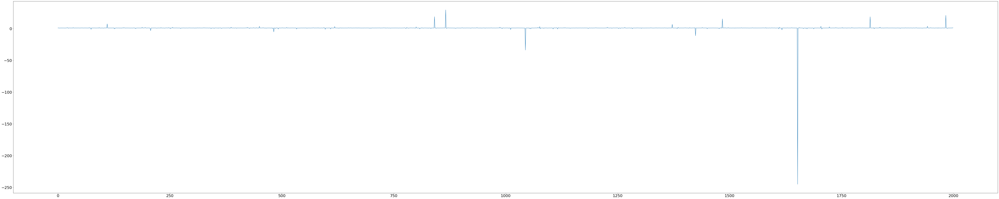

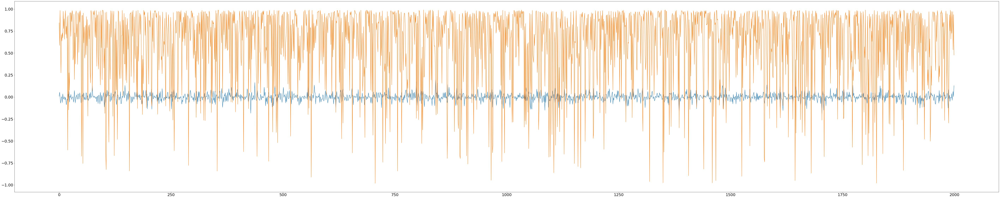

In [51]:
plt.figure(figsize = (100, 20))
plt.plot(avg_3/avg_4)
plt.show()
plt.figure(figsize = (100, 20))
plt.plot(avg_3 - avg_4)
plt.plot(avg_3)
plt.show()

In [47]:
print(np.max(test_acc_1))
print(np.max(test_acc_2))

0.974903474903475
0.9703989703989704


In [48]:
print(hdc_1.test(testencoded, testlabels, param["kernel"]))
print(hdc_2.test(testencoded, testlabels, param["kernel"]))

0.9703989703989704
0.9678249678249679


In [15]:
Ds = [500, 1000, 2000]
for D in Ds:
    param["D"] = D
    
    hdb = HDB.HD_basis(Config.Generator_T.Vanilla, param)
    basis = hdb.getBasis()
    bid = hdb.getParam()["id"]
    param = hdb.getParam()
    hde = HDE.HD_encoder(basis)
    trainencoded = hde.encodeData(traindata)
    testencoded = hde.encodeData(testdata)
    
    hdc_1 = HDC.HD_classifier(param["D"], param["nClasses"], bid)
    train_acc_1, test_acc_1 = train(hdc_1, trainencoded, trainlabels, testencoded, testlabels, param)
    hdc_2 = HDC.HD_classifier(param["D"], param["nClasses"], bid)
    train_acc_2, test_acc_2 = train_topn(hdc_2, trainencoded, trainlabels, testencoded, testlabels, param = param)
    
    print(D)
    print(hdc_1.test(testencoded, testlabels, param["kernel"]))
    print(hdc_2.test(testencoded, testlabels, param["kernel"]))
    

Generating vanilla HD basis of shape... 

(500, 784)
Encoding time: 0.03739571571350098 
Encoding data of shape (10000, 784)


Time spent: 0 sec
Encoding data of shape (5000, 784)


Time spent: 0 sec
c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.785900 	 	 Test: 0.869600
Train: 0.928800 	 	 Test: 0.890800
Train: 0.946900 	 	 Test: 0.888400
Train: 0.952200 	 	 Test: 0.898200
Train: 0.966000 	 	 Test: 0.923400
Train: 0.969700 	 	 Test: 0.924600
Train: 0.975600 	 	 Test: 0.914600
Train: 0.982100 	 	 Test: 0.918600
Train: 0.985200 	 	 Test: 0.923000
Train: 0.985600 	 	 Test: 0.924800



c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.796100 	 	 Test: 0.619200
Train: 0.934000 	 	 Test: 0.876600
Train: 0.951500 	 	 Test: 0.917200
Train: 0.958400 	 	 Test: 0.908600
Train: 0.968000 	 	 Test: 0.914600
Train: 0.974500 	 	 Test: 0.915800
Train: 0.977500 	 	 Test: 0.912600
Train: 0.980100 	 	 Test: 0.920200
Train: 0.982900 	 	 Test: 0.913400
Train: 0.981000 	 	 Test: 0.913800

500
0.9224
0.9164


Generating vanilla HD basis of shape... 

(1000, 784)
Encoding time: 0.05884242057800293 
Encoding data of shape (10000, 784)


Time spent: 1 sec
Encoding data of shape (5000, 784)


Time spent: 0 sec


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.800700 	 	 Test: 0.903000
Train: 0.944500 	 	 Test: 0.921600
Train: 0.963300 	 	 Test: 0.919400
Train: 0.980000 	 	 Test: 0.928600
Train: 0.981200 	 	 Test: 0.928200
Train: 0.998000 	 	 Test: 0.936400
Train: 0.993500 	 	 Test: 0.933400
Train: 0.999400 	 	 Test: 0.945000
Train: 1.000000 	 	 Test: 0.945000


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.807800 	 	 Test: 0.885400
Train: 0.962900 	 	 Test: 0.913600
Train: 0.981500 	 	 Test: 0.926400
Train: 0.993700 	 	 Test: 0.931000
Train: 0.996800 	 	 Test: 0.944800
Train: 0.998700 	 	 Test: 0.942000
Train: 0.998800 	 	 Test: 0.937000
Train: 1.000000 	 	 Test: 0.944000
1000
0.945
0.944


Generating vanilla HD basis of shape... 

(2000, 784)
Encoding time: 0.08976006507873535 
Encoding data of shape (10000, 784)


Time spent: 4 sec
Encoding data of shape (5000, 784)


Time spent: 2 sec


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.801900 	 	 Test: 0.920400
Train: 0.958100 	 	 Test: 0.924200
Train: 0.979000 	 	 Test: 0.953200
Train: 0.989600 	 	 Test: 0.948000
Train: 0.997000 	 	 Test: 0.950600
Train: 0.994000 	 	 Test: 0.946800
Train: 0.996000 	 	 Test: 0.948800
Train: 1.000000 	 	 Test: 0.954200
Train: 1.000000 	 	 Test: 0.954200


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.811600 	 	 Test: 0.926800
Train: 0.973000 	 	 Test: 0.932400
Train: 0.990600 	 	 Test: 0.933600
Train: 0.998800 	 	 Test: 0.949200
Train: 0.999800 	 	 Test: 0.949800
Train: 1.000000 	 	 Test: 0.949800
2000
0.9542
0.9498


In [1]:
fst_scs, snd_scs = hdc_1.analyze(trainencoded, trainlabels)
#show_plots(fst_scs, snd_scs, [(3,4)])

#fst_scs, snd_scs = hdc_1.analyze(testencoded, testlabels)

NameError: name 'hdc_1' is not defined

In [2]:

fst_scs, snd_scs = hdc_2.analyze(trainencoded, trainlabels)
#show_plots(fst_scs, snd_scs, [(3,4)])

mask_t = "b" # b for binary, o for original 
mask_d = 2
(dominance, percent, threshold) = 1.5, 0.75, 0.2
    
hdc_2.make_mask(trainencoded, trainlabels, dominance)
hdc_2.prep_mask(percent)
hdc_2.set_decider(trainencoded, trainlabels, threshold, dominance, mask_t, mask_d)

print("########################### TEST MASK REVEAL ################################")
#evaluate(hdc_2.test_mask, trainencoded, trainlabels, threshold, dominance, mask_t, mask_d)

print("########################### TEST DECIDER REVEAL ################################")
#evaluate(hdc_2.test_decider, trainencoded, trainlabels, threshold, dominance, mask_t, mask_d)

NameError: name 'hdc_2' is not defined

# Sample code to train a model

In [ ]:
################# VANILLA #################
hdb = HDB.HD_basis(Config.Generator_T.Vanilla, param)
basis = hdb.getBasis()
bid = hdb.getParam()["id"]
# Update param with bid
param = hdb.getParam()
print(bid)

In [ ]:
# Retrieve info upto basis generator, given correct bid
#bid = 6679
#basis, param = HDB.loadBasis("base_%d.pkl"%bid)

In [17]:
hde = HDE.HD_encoder(basis)

trainencoded = hde.encodeData(traindata)
#HDE.saveEncoded(trainencoded, trainlabels, bid, "train")

testencoded = hde.encodeData(testdata)
#HDE.saveEncoded(testencoded, testlabels, bid, "test")

Encoding data of shape (6213, 561)


Time spent: 0 sec
Encoding data of shape (1554, 561)


Time spent: 0 sec


In [18]:
# Retrieve info upto encoder, given correct bid
#bid = 6679
#basis, param = HDB.loadBasis("base_%d.pkl"%bid)
#trainencoded, trainlabels = HDE.loadEncoded("encoded_%d_train.pkl"%bid)
#testencoded, testlabels = HDE.loadEncoded("encoded_%d_test.pkl"%bid)

In [19]:
hdc = HDC.HD_classifier(param["D"], param["nClasses"], bid)
train_acc, test_acc = train(hdc, trainencoded, trainlabels, testencoded, testlabels, param)

c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.721552 	 	 Test: 0.428571
Train: 0.878320 	 	 Test: 0.822394
Train: 0.908418 	 	 Test: 0.922780
Train: 0.920650 	 	 Test: 0.945946
Train: 0.935458 	 	 Test: 0.938867
Train: 0.940286 	 	 Test: 0.920849
Train: 0.950427 	 	 Test: 0.923423
Train: 0.954772 	 	 Test: 0.940798
Train: 0.951392 	 	 Test: 0.948520
Train: 0.956704 	 	 Test: 0.953668
Train: 0.959440 	 	 Test: 0.951737
Train: 0.961532 	 	 Test: 0.922136
Train: 0.961532 	 	 Test: 0.941441
Train: 0.961532 	 	 Test: 0.958172
Train: 0.958796 	 	 Test: 0.957529
Train: 0.968453 	 	 Test: 0.957529



# Top n accuracy

In [10]:
def topn_suit(traindata, trainlabels, testdata, testlabels, param):
    hdb = HDB.HD_basis(Config.Generator_T.Vanilla, param)
    basis = hdb.getBasis()
    bid = hdb.getParam()["id"]
    param = hdb.getParam()
    
    hde = HDE.HD_encoder(basis)
    trainencoded = hde.encodeData(traindata)
    testencoded = hde.encodeData(testdata)
    
    hdc = HDC.HD_classifier(param["D"], param["nClasses"], bid)
    train_acc, test_acc = train(hdc, trainencoded, trainlabels, testencoded, testlabels, param)
    accs = []
    cmps = []
    for k in range(5):
        accs.append(hdc.test_topn(testencoded, testlabels, k+1))
        cmps.append(hdc.predict_topn(testencoded, k+1))
        print("Top %d accuracy: "%(k+1), accs[-1])
    return accs, cmps

In [ ]:
Ds = [200, 500, 1000]
accs_D = dict()
cmps_D = dict()
for D in Ds:
    param["D"] = D
    accs_D[D], cmps_D[D] = topn_suit(traindata, trainlabels, testdata, testlabels, param)
param["D"] = Config.config["D"]

Generating vanilla HD basis of shape... 

(200, 561)
Encoding time: 0.031884193420410156 
Encoding data of shape (6213, 561)


Time spent: 0 sec
Encoding data of shape (1554, 561)


Time spent: 0 sec
c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Train: 0.721713 	 	 Test: 0.809524


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.DOT: 0>)] 


Train: 0.891196 	 	 Test: 0.879022
Train: 0.914695 	 	 Test: 0.936937
Train: 0.919202 	 	 Test: 0.933076


In [ ]:
for D in accs_D.keys():
    print(D)
    for i in range(len(accs_D[D])):
        print("Top %d Accuracy:"%(i+1), accs_D[D][i])

# Mask generation: 2d masks

In [10]:
hdb = HDB.HD_basis(Config.Generator_T.Vanilla, param)
basis = hdb.getBasis()
bid = hdb.getParam()["id"]
param = hdb.getParam()

hde = HDE.HD_encoder(basis)
trainencoded = hde.encodeData(traindata)
testencoded = hde.encodeData(testdata)

hdc = HDC.HD_classifier(param["D"], param["nClasses"], bid)
#train_acc, test_acc = train_masks(hdc, trainencoded, trainlabels, testencoded, testlabels, param)
train_acc, test_acc = train(hdc, trainencoded, trainlabels, testencoded, testlabels, param)
hdc.normalizeClasses()
acc_1 = hdc.test(testencoded, testlabels, param["kernel"])
acc_2 = hdc.test_topn(testencoded, testlabels, 2)
print("Normalized top1 and top 2 test accuracy:", acc_1, acc_2)

Generating vanilla HD basis of shape... 

(100, 561)
Encoding time: 0.03043961524963379 
Encoding data of shape (6213, 561)


Time spent: 0 sec
Encoding data of shape (1554, 561)


Time spent: 0 sec
c:\program files (x86)\microsoft visual studio\shared\python37_64\lib\site-packages\ipykernel_launcher.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """


Fitting with configuration: [('one_shot', 0), ('dropout', 0), ('lr', 1), ('kernel', <Kernel_T.COS: 1>)] 


Train: 0.726863 	 	 Test: 0.725225
Train: 0.889747 	 	 Test: 0.882239
Train: 0.905682 	 	 Test: 0.931789
Train: 0.913407 	 	 Test: 0.900257
Train: 0.921294 	 	 Test: 0.909910
Train: 0.920650 	 	 Test: 0.918275
Train: 0.929020 	 	 Test: 0.848777
Train: 0.933687 	 	 Test: 0.874517
Train: 0.930307 	 	 Test: 0.916988
Train: 0.938677 	 	 Test: 0.940154
Train: 0.937550 	 	 Test: 0.857786
Train: 0.943345 	 	 Test: 0.893179
Train: 0.947368 	 	 Test: 0.925354
Train: 0.945437 	 	 Test: 0.937580
Train: 0.941413 	 	 Test: 0.921493
Train: 0.945759 	 	 Test: 0.942728
Train: 0.943184 	 	 Test: 0.942728
Train: 0.942218 	 	 Test: 0.929215
Train: 0.944632 	 	 Test: 0.906049
Train: 0.948173 	 	 Test: 0.895109

Normalized top1 and top 2 test accuracy: 0.8577863577863578 0.990990990990991


Len of fst, snd:  5400 813
Len of fst after cropping:  4987


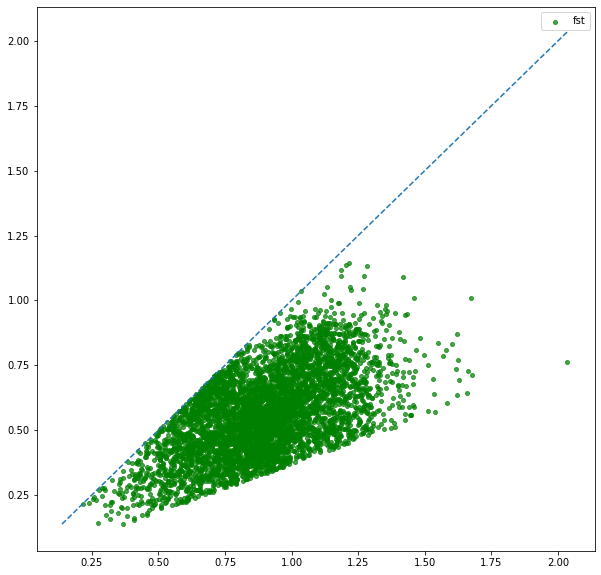

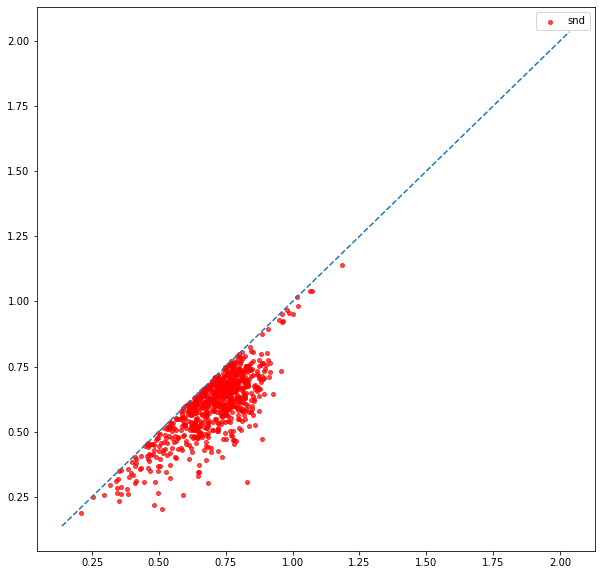

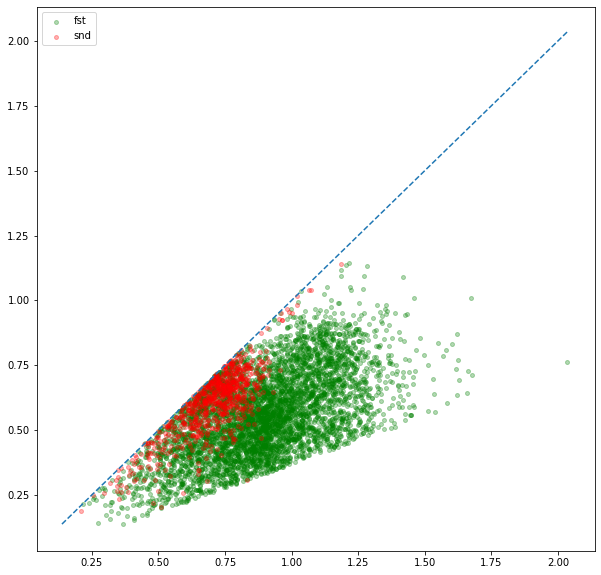

0.425316187801641 1.599705476000485


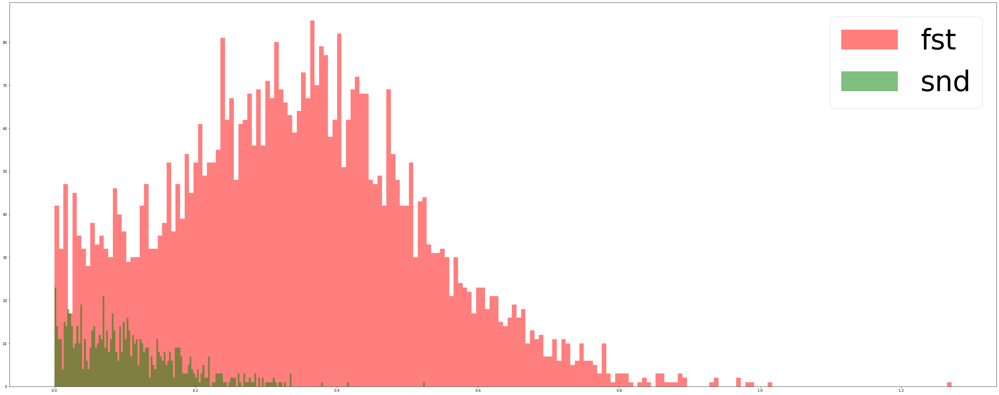

In [26]:
fst_scs, snd_scs = hdc.analyze(trainencoded, trainlabels)
print("Len of fst, snd: ",len(fst_scs), len(snd_scs))

new_fst = []
beta = np.max(snd_scs[:,0]/snd_scs[:,1])
for sc in fst_scs:
    if sc[0]/sc[1] <= beta:
        new_fst.append(sc)
fst_scs = np.asarray(new_fst)

print("Len of fst after cropping: ",len(fst_scs))

show_plots(fst_scs, snd_scs)

In [21]:
dominance = 1.2
hdc.make_mask(trainencoded, trainlabels, dominance)

Len of fst, snd:  657 526


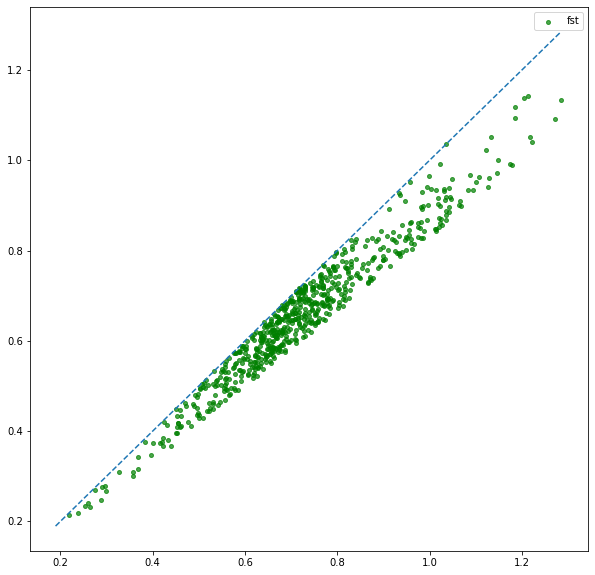

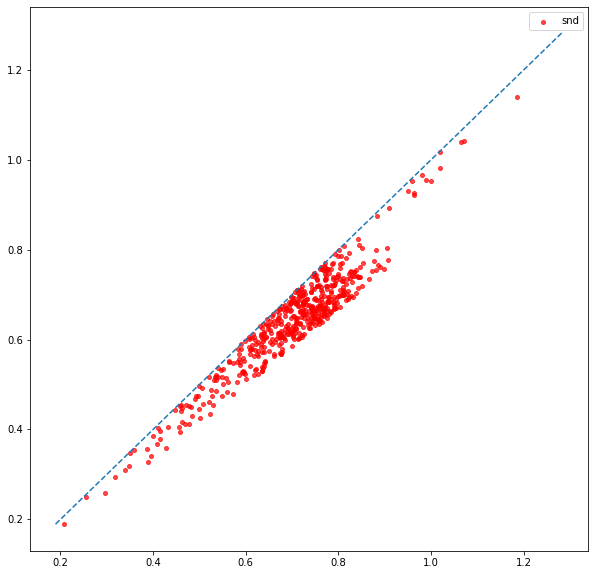

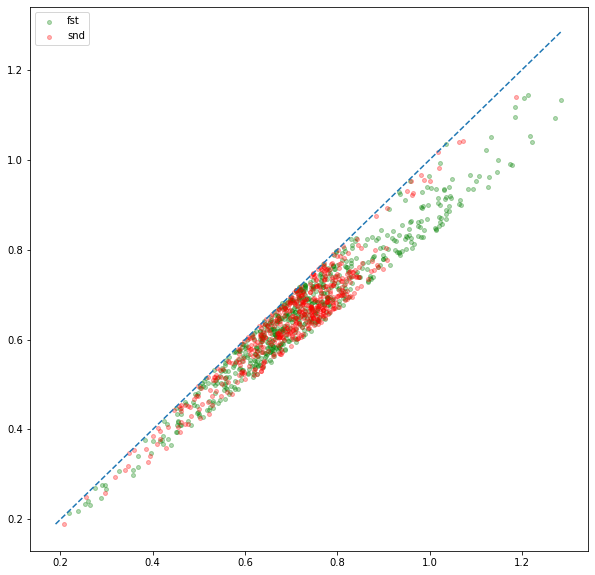

0.057732300787497505 1.094980610776924


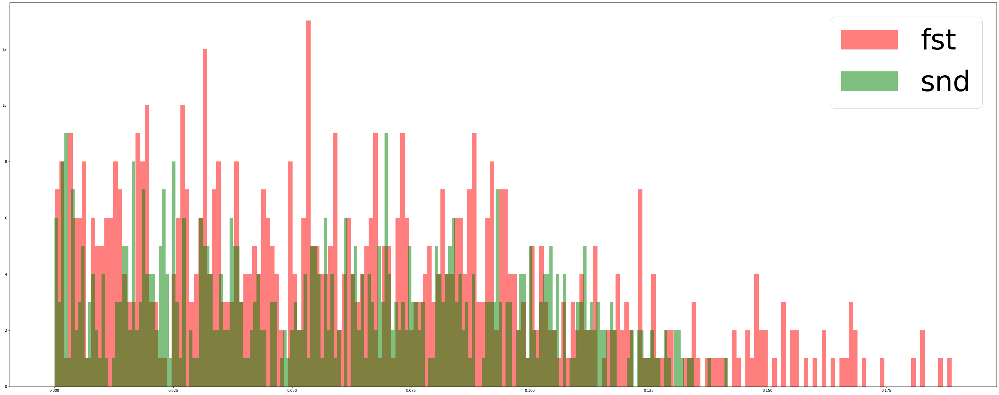

In [27]:
fst_scs, snd_scs = hdc.analyze(trainencoded, trainlabels, dominance)
print("Len of fst, snd: ",len(fst_scs), len(snd_scs))
show_plots(fst_scs, snd_scs)

In [23]:
percent = 0.5
hdc.prep_mask(percent)

Analyzing score with mask type b 2
Length fss, snd:  657 516


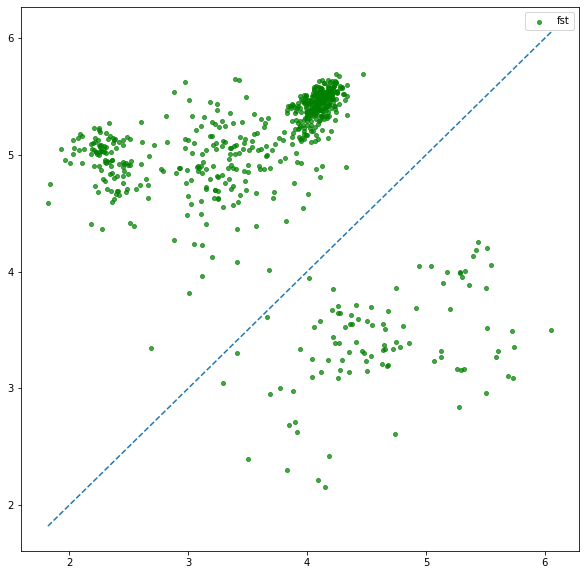

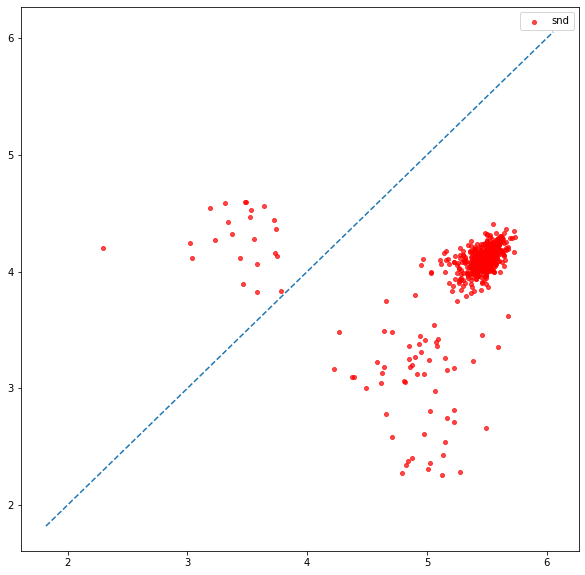

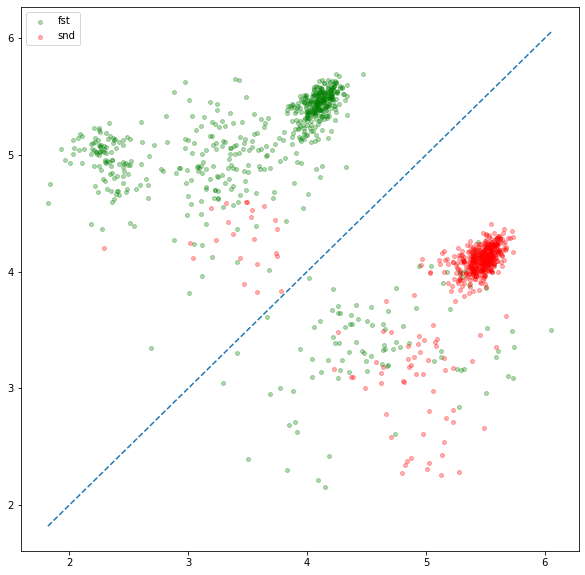

0.3709658286499325 1.03066631748394


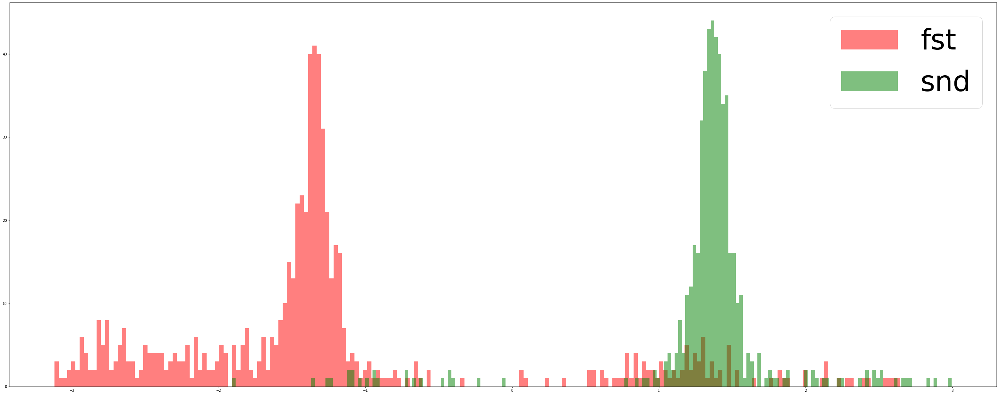

In [28]:
mask_t = "b" # b for binary, o for original 
mask_d = 2
threshold = 0.3
hdc.set_decider(trainencoded, trainlabels, threshold, dominance, mask_t, mask_d)
fst_scs, snd_scs = hdc.analyze_topn(trainencoded, trainlabels, dominance, mask_t, mask_d)
print("Length fss, snd: ", len(fst_scs), len(snd_scs))
show_plots(fst_scs, snd_scs)

In [12]:
def try_hp(hdc, curr_config, data, labels):
    
    global dominances, percents, thresholds
    
    mask_t = "b" # b for binary, o for original 
    mask_d = 2
    i, j, k = curr_config
    print(i, j, k)
    (dominance, percent, threshold) = dominances[i], percents[j], thresholds[k]
    
    hdc.make_mask(data, labels, dominance)
    hdc.prep_mask(percent)
    hdc.set_decider(data, labels, threshold, dominance, mask_t, mask_d)

    print("########################### TEST MASK REVEAL ################################")
    evaluate(hdc.test_mask, data, labels, threshold, dominance, mask_t, mask_d)

    print("########################### TEST DECIDER REVEAL ################################")
    evaluate(hdc.test_decider, data, labels, threshold, dominance, mask_t, mask_d)

In [13]:
dominances = [1.1, 1.3, 1.5, 1.7]
percents = [0.2, 0.5, 0.8]
thresholds = [0.2, 0.3, 0.5]

def hp_tuning(hdc, data, labels):
    
    global dominances, percents, thresholds
    
    best_mk_acc = 0
    best_mk_config = (0, 0, 0)
    
    best_dc_acc = 0
    best_dc_config = (0, 0, 0)
    
    mask_t = "b" # b for binary, o for original 
    mask_d = 2
    
    og_acc = 0
    op_acc = 0
    mk_accs = np.zeros((len(dominances), len(percents), len(thresholds)))
    dc_accs = np.zeros((len(dominances), len(percents), len(thresholds)))
    
    for i, dominance in enumerate(dominances):
        hdc.make_mask(data, labels, dominance)
        for j, percent in enumerate(percents):
            hdc.prep_mask(percent)
            
            for k, threshold in enumerate(thresholds):
                hdc.set_decider(data, labels, threshold, dominance, mask_t, mask_d)

                #fst_scs, snd_scs = hdc.analyze_topn(data, labels, dominance, mask_t, mask_d)
                #print("Length fss, snd: ", len(fst_scs), len(snd_scs))
                #show_plots(fst_scs, snd_scs)

                correct, c_1, c_2, c_r, w_1, w_2, w_3, count, mat, net_mat = \
                    hdc.test_mask(data, labels, threshold, dominance, mask_t, mask_d)
                og_acc =  c_1/count
                op_acc =  (c_1 + c_2)/count
                mk_accs[i,j,k] = correct/count
                correct, c_1, c_2, c_r, w_1, w_2, w_3, count, mat, net_mat = \
                    hdc.test_decider(data, labels, threshold, dominance, mask_t, mask_d)
                dc_accs[i,j,k] = correct/count
    
                # BEST MASK
                if mk_accs[i,j,k] > best_mk_acc:
                    best_mk_acc = mk_accs[i,j,k]
                    best_mk_config = (i,j,k)

                # BEST DECIDER 
                if dc_accs[i,j,k] > best_dc_acc:
                    best_dc_acc = dc_accs[i,j,k]
                    best_dc_config = (i,j,k)
                  
    print("Original Accuracy:", og_acc)
    print("Optimal mask at", best_mk_config, " with train accuracy", best_mk_acc)
    print("Optimal decider at", best_dc_config, " with train accuracy", best_dc_acc)
    print("Ideal Accuracy:", op_acc)
                
    return og_acc, op_acc, mk_accs, dc_accs, best_mk_config, best_dc_config
            

In [14]:
og_acc, op_acc, mk_accs, dc_accs, best_mk_config, best_dc_config = hp_tuning(hdc, trainencoded, trainlabels)

C:\HDComputing\TopnHD\HD_classifier.py:572: RuntimeWarning: invalid value encountered in true_divide
  rate = net_mat/mat


Original Accuracy: 0.8691453404152584
Optimal mask at (0, 1, 0)  with train accuracy 0.8221471108965073
Optimal decider at (1, 0, 0)  with train accuracy 0.9623370352486721
Ideal Accuracy: 0.9967809431836472


In [15]:
print("Original accu:", og_acc)
print("Optimal mask at", best_mk_config, " with train accuracy", np.max(mk_accs))
print("Optimal decider at", best_dc_config, " with train accuracy", np.max(dc_accs))
print("Ideal/Top 2 accu:", op_acc)
print("Mask Accs:\n", mk_accs)
print("Decider Accs:\n", dc_accs)

Original accu: 0.8691453404152584
Optimal mask at (0, 1, 0)  with train accuracy 0.8221471108965073
Optimal decider at (1, 0, 0)  with train accuracy 0.9623370352486721
Ideal/Top 2 accu: 0.9967809431836472
Mask Accs:
 [[[0.81908901 0.81908901 0.81908901]
  [0.82214711 0.82214711 0.82214711]
  [0.82214711 0.82214711 0.82214711]]

 [[0.72605826 0.72605826 0.72605826]
  [0.73442781 0.73442781 0.73442781]
  [0.73394495 0.73394495 0.73394495]]

 [[0.61870272 0.61870272 0.61870272]
  [0.63061323 0.63061323 0.63061323]
  [0.63013037 0.63013037 0.63013037]]

 [[0.53468534 0.53468534 0.53468534]
  [0.54756156 0.54756156 0.54756156]
  [0.54723966 0.54723966 0.54723966]]]
Decider Accs:
 [[[0.91002736 0.91002736 0.91051022]
  [0.91083213 0.91083213 0.91131498]
  [0.91083213 0.91083213 0.91131498]]

 [[0.96233704 0.96233704 0.95750845]
  [0.96217608 0.96217608 0.96185418]
  [0.96201513 0.96201513 0.96169322]]

 [[0.95203605 0.95139224 0.95074843]
  [0.95509416 0.95509416 0.95396749]
  [0.95509416 0

In [16]:
try_hp(hdc, best_mk_config, testencoded, testlabels)

0 1 0
########################### TEST MASK REVEAL ################################
Accuracy:  0.8088803088803089
Original:  0.8577863577863578
Correct:  1257
First is Correct:  1333
Wrong second is selected:  81
Second is Correct:  207
Correct Second is selected:  5
Wrong first is selected:  202
Out of top 2:  14
Net increase in correct cases and accuracy:  -76 -0.0489060489060489
Potential increase in correct cases and accuracy:  207 0.13320463320463322
Total cases: 1554
Confusion Matrix:
 [[ 0. 11.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [12.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 3.  5.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0. 57.  2.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0. 50.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0. 13.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0

In [17]:
try_hp(hdc, best_dc_config, testencoded, testlabels)

1 0 0
########################### TEST MASK REVEAL ################################
Accuracy:  0.7239382239382239
Original:  0.8577863577863578
Correct:  1125
First is Correct:  1333
Wrong second is selected:  215
Second is Correct:  207
Correct Second is selected:  7
Wrong first is selected:  200
Out of top 2:  14
Net increase in correct cases and accuracy:  -208 -0.13384813384813385
Potential increase in correct cases and accuracy:  207 0.13320463320463322
Total cases: 1554
Confusion Matrix:
 [[  0.  15.  11.   0.   0.   0.   0.   0.   0.   0.   0.   0.]
 [ 38.   0.  12.   0.   0.   0.   3.   0.   0.   0.   0.   1.]
 [ 19.  16.   0.   0.   0.   0.   1.   0.   0.   0.   0.   0.]
 [  0.   0.   1.   0. 132.   4.   1.   0.   0.   0.   0.   0.]
 [  0.   0.   0.  81.   0.   0.   2.   0.   0.   0.   0.   0.]
 [  0.   0.   0.  62.   0.   0.   0.   0.   0.   0.   0.   1.]
 [  0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   1.   0.]
 [  0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   

In [19]:
print(hdc.test(testencoded, testlabels))

0.8577863577863578


# Scratch Paper

In [1]:
# Select two classes to separate
cl1 = 3
cl2 = 4

ncl1 = 0
cl1_sum = np.zeros(hdc.D)
for sc in fst_scs:
    if sc[3] == cl1 and sc[4] == cl2:
        cl1_sum += trainencoded[int(sc[2])]
        ncl1 += 1
for sc in snd_scs:
    if sc[3] == cl2 and sc[4] == cl1:
        cl1_sum += trainencoded[int(sc[2])]
        ncl1 += 1 
ncl2 = 0
cl2_sum = np.zeros(hdc.D)
for sc in fst_scs:
    if sc[3] == cl2 and sc[4] == cl1:
        cl2_sum += trainencoded[int(sc[2])]
        ncl2 += 1
for sc in snd_scs:
    if sc[3] == cl1 and sc[4] == cl2:
        cl2_sum += trainencoded[int(sc[2])]
        ncl2 += 1
print("Component-wise sum of data points, sum1 sum2")
#print(cl1_sum)
#print(cl2_sum)

#print("Component-wise ratio sum1:sum2")
#print(cl1_sum/cl2_sum)
cl1_nm = sklearn.preprocessing.normalize(np.asarray([cl1_sum]), norm='l2')[0]
cl2_nm = sklearn.preprocessing.normalize(np.asarray([cl2_sum]), norm='l2')[0]
print("Component-wise normalized ratio normed(sum1):normed(sum2)")
print(cl1_nm/cl2_nm)
#print("Component-wise normalized diff normed(sum1) - normed(sum2)")
#print(cl1_nm - cl2_nm)

NameError: name 'np' is not defined

In [ ]:
og_mask1 = copy.deepcopy(hdc.mask2d[cl1][cl2])
og_mask2 = copy.deepcopy(hdc.mask2d[cl2][cl1])
hdc.mask2d[cl1][cl2] = mask
hdc.mask2d[cl2][cl1] = -mask

In [ ]:
hdc.mask2d[cl1][cl2] = og_mask1
hdc.mask2d[cl2][cl1] = og_mask2

In [ ]:
np.set_printoptions(linewidth=85, suppress = True)
fst_mat = np.zeros((hdc.nClasses, hdc.nClasses))
for sc in fst_scs:
    fst_mat[int(sc[3]), int(sc[4])] += 1

snd_mat = np.zeros((hdc.nClasses, hdc.nClasses))
for sc in snd_scs:
    snd_mat[int(sc[3]), int(sc[4])] += 1
print("fst confusion matrix: top 2 choices (row, col) whose answer is first choice")
print(fst_mat)
print("snd confusion matrix: top 2 choices (row, col) whose answer is second choice")
print(snd_mat)

In [ ]:
fst_r, snd_r = hdc.analyze(testencoded, testlabels)

print(len(fst_r), len(snd_r))
#beta = max(snd_r)
#fst_r = fst_r[fst_r <= beta]
print(len(fst_r))

fst_mr, snd_mr, fst_scs, snd_scs = hdc.analyze_topn(testencoded, testlabels, dominance, mask_t, mask_d)

print(len(fst_mr), len(snd_mr))
print(len(fst_scs), len(snd_scs))
#print(fst_mr)
#print(snd_mr)
#print(fst_scs)
#print(snd_scs)


plt.figure(figsize = (100, 20))
plt.hist(np.append(fst_mr,snd_mr), bins = 1000, label = "fst")
plt.hist(snd_mr, bins = 1000, label = "snd")
plt.legend()

plt.figure(figsize = (100, 20))
plt.hist(np.append(fst_scs,snd_scs), bins = 1000, label = "fst")
plt.hist(snd_scs, bins = 1000, label = "snd")
plt.legend()

In [31]:
np.set_printoptions(threshold=sys.maxsize)